In [9]:
from __future__ import absolute_import, division, print_function
import glob
import os
import pdb
import numpy as np
import numpy.random as npr
import tensorflow as tf
import sys
import matplotlib.pyplot as plt
import pdb
import json
import getpass
from scipy import stats
from sklearn import linear_model
from numpy import linalg as LA
import numpy.random as npr
from sklearn.decomposition import PCA
import imageio
from sklearn.manifold import MDS
from scipy.spatial import distance
from sklearn.cluster import KMeans

ui = getpass.getuser()
if ui == 'laura':
    p = '/home/laura'
elif ui == 'lauradriscoll':
    p = '/Users/lauradriscoll/Documents'
elif ui == 'lndrisco':
    p = '/home/users/lndrisco'

net = 'stepnet'
PATH_YANGNET = os.path.join(p,'code/multitask-nets',net)

sys.path.insert(0, PATH_YANGNET)
from task import generate_trials, rule_name, rule_index_map, rules_dict
from network import Model
import tools
from tools_lnd import name_best_ckpt, generate_Beta_epoch, make_h_combined, same_stim_trial
from tools_lnd import get_T_inds, gen_trials_from_model_dir

PATH_TO_RECURRENT_WHISPERER = p+'/code/recurrent-whisperer'#'/home/laura/code/recurrent-whisperer'#
sys.path.insert(0, PATH_TO_RECURRENT_WHISPERER)
from RecurrentWhisperer import RecurrentWhisperer

PATH_TO_FIXED_POINT_FINDER = p+'/code/fixed-point-finder' #'/home/laura/code/fixed-point-finder-experimental'#
sys.path.insert(0, PATH_TO_FIXED_POINT_FINDER)
from FixedPointFinder import FixedPointFinder

In [10]:
task_list = ['fdgo', 'reactgo', 'delaygo', 'fdanti', 'reactanti', 'delayanti',
              'delaydm1', 'delaydm2', 'contextdelaydm1', 'contextdelaydm2', 'multidelaydm',
              'dmsgo', 'dmsnogo', 'dmcgo', 'dmcnogo']

rule_set_names = ['DelayGo', 'ReactGo', 'MemoryGo', 'DelayAnti', 'ReactAnti', 'MemoryAnti',
              'Decison1', 'Decison2', 'ContextDecison1', 'ContextDecison2', 'MultiDecison',
              'DelayDecison1', 'DelayDecison2', 'ContextDelayDecison1', 'ContextDelayDecison2', 'MultiDelayDecison',
              'DelayMatch2SampleGo', 'DelayMatch2SampleNogo', 'DelayMatch2CategoryGo', 'DelayMatch2CategoryNoGo']

tab20 = plt.get_cmap('tab20')
tab20b = plt.get_cmap('tab20b')
tab20c = plt.get_cmap('tab20c')
color_inds = (tab20c(8/20),tab20c(9/20),tab20c(10/20),tab20c(4/20),tab20c(5/20),tab20c(6/20),
             tab20b(0/20),tab20b(12/20),tab20b(1/20),tab20b(13/20),tab20b(16/20),
             tab20b(2/20),tab20b(14/20),tab20b(3/20),tab20b(15/20),tab20b(17/20),
             tab20(18/20),tab20(19/20),tab20(16/20),tab20(17/20))


color_inds_nu = (tab20c(8/20),tab20c(9/20),tab20b(0/20),tab20c(4/20),tab20c(5/20),tab20b(12/20),
             tab20b(0/20),tab20b(12/20),tab20b(1/20),tab20b(13/20),tab20b(16/20),
             tab20b(2/20),tab20b(14/20),tab20b(3/20),tab20b(15/20),tab20b(17/20),
             tab20(18/20),tab20(19/20),tab20(16/20),tab20(17/20))

In [11]:
def make_axes(m,rule_master,epoch,ind = -1,mod = 'either'):

    model = Model(m)
    with tf.Session() as sess:
        model.restore()
        # get all connection weights and biases as tensorflow variables
        var_list = model.var_list
        # evaluate the parameters after training
        params = [sess.run(var) for var in var_list]
        # get hparams
        hparams = model.hp
        trial_master = generate_trials(rule_master, hparams, mode = 'test', batch_size = 400, noise_on=False, delay_fac =1)
        feed_dict = tools.gen_feed_dict(model, trial_master, hparams)
        h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_trials, n_neuron)

    print(mod)
    Beta_epoch = generate_Beta_epoch(h_tf,trial_master,ind,mod = mod)
    X_pca = Beta_epoch[epoch]    
    D = np.concatenate((np.expand_dims(X_pca[:,0],axis=1),np.expand_dims(X_pca[:,1],axis=1)),axis = 1)
    return D

In [12]:
def comp_eig_decomp(Ms, sort_by='real',
                                     do_compute_lefts=True):
  """Compute the eigenvalues of the matrix M. No assumptions are made on M.

  Arguments: 
    M: 3D np.array nmatrices x dim x dim matrix
    do_compute_lefts: Compute the left eigenvectors? Requires a pseudo-inverse 
      call.

  Returns: 
    list of dictionaries with eigenvalues components: sorted 
      eigenvalues, sorted right eigenvectors, and sored left eigenvectors 
      (as column vectors).
  """
  if sort_by == 'magnitude':
    sort_fun = np.abs
  elif sort_by == 'real':
    sort_fun = np.real
  else:
    assert False, "Not implemented yet."      
  
  decomps = []
  L = None  
  for M in Ms:
    evals, R = LA.eig(M)    
    indices = np.flipud(np.argsort(sort_fun(evals)))
    if do_compute_lefts:
      L = LA.pinv(R).T  # as columns      
      L = L[:, indices]
    decomps.append({'evals' : evals[indices], 'R' : R[:, indices],  'L' : L})
  
  return decomps

In [13]:
def get_filename(trial, epoch,t):
    ind_stim_loc  = 180*trial.y_loc[-1,t]/np.pi
    filename = trial.epochs.keys()[epoch]+'_'+str(round(ind_stim_loc,2))

    return filename, ind_stim_loc

In [14]:
def plot_FP(X, D, eig_decomps, c='k'):
    """Plot activity is some 2D space.

        Args:
            X: Fixed points in #Fps x Neurons
            D: Neurons x 2 plotting dims
    
        """
    S = np.shape(X)[0]
    lf = 1
    rf = 1
    
    for s in range(S):
        
        X_trial = np.dot(X[s,:],D.T)
        
        n_arg = np.argwhere(eig_decomps[s]['evals']>1)+1
        if len(n_arg)>0:
            for arg in range(np.max(n_arg)):
                rdots = np.dot(np.real(eig_decomps[s]['R'][:, arg]).T,D.T)
                ldots = np.dot(np.real(eig_decomps[s]['L'][:, arg]).T,D.T)
                overlap = np.dot(rdots,ldots.T)
                r = np.concatenate((X_trial - rf*overlap*rdots, X_trial + rf*overlap*rdots),0)
                plt.plot(r[0:4:2],r[1:4:2],'k',alpha = .5,linewidth = .5)
        
        n_arg = np.argwhere(eig_decomps[s]['evals']<.3)
        if len(n_arg)>0:
            for arg in range(np.min(n_arg),len(eig_decomps[s]['evals'])):
                rdots = np.dot(np.real(eig_decomps[s]['R'][:, arg]).T,D.T)
                ldots = np.dot(np.real(eig_decomps[s]['L'][:, arg]).T,D.T)
                overlap = np.dot(rdots,ldots.T)
                r = np.concatenate((X_trial - rf*overlap*rdots, X_trial + rf*overlap*rdots),0)
                plt.plot(r[0:4:2],r[1:4:2],'b',alpha = .5,linewidth = .5)
            
        plt.plot(X_trial[0], X_trial[1], 'o', markerfacecolor = c, markeredgecolor = 'k', 
                 markersize = 6, alpha = .5)
        
def plot_FP_specific(s,X, D, eig_decomps, c='k'):
    """Plot activity is some 2D space.

        Args:
            X: Fixed points in #Fps x Neurons
            D: Neurons x 2 plotting dims
    
        """
    lf = 1000
    rf = 1000
    
    X_trial = np.dot(X[s,:],D.T)
        
    n_arg = np.argwhere(eig_decomps[s]['evals']>1)+1
    if len(n_arg)>0:
        for arg in range(np.max(n_arg)):
            rdots = np.dot(np.real(eig_decomps[s]['R'][:, arg]).T,D.T)
            ldots = np.dot(np.real(eig_decomps[s]['L'][:, arg]).T,D.T)
            overlap = np.dot(rdots,ldots.T)
            r = np.concatenate((X_trial - rf*overlap*rdots, X_trial + rf*overlap*rdots),0)
            plt.plot(r[0:4:2],r[1:4:2],'k',alpha = .5,linewidth = .5)

    n_arg = np.argwhere(eig_decomps[s]['evals']<.3)
    if len(n_arg)>0:
        for arg in range(np.min(n_arg),len(eig_decomps[s]['evals'])):
            rdots = np.dot(np.real(eig_decomps[s]['R'][:, arg]).T,D.T)
            ldots = np.dot(np.real(eig_decomps[s]['L'][:, arg]).T,D.T)
            overlap = np.dot(rdots,ldots.T)
            r = np.concatenate((X_trial - rf*overlap*rdots, X_trial + rf*overlap*rdots),0)
            plt.plot(r[0:4:2],r[1:4:2],'b',alpha = .5,linewidth = .5)

    plt.plot(X_trial[0], X_trial[1], 'o', markerfacecolor = 'none', markeredgecolor = c, 
             markersize = 20, alpha = .5)
    
def make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 4):
    filename = os.path.join(m,'golub_fixed_pts',rule_master,fp_epoch+'_'+str(round(t_num,2))+'.npz')
    fp_struct = np.load(filename)
    sorted_fps = fp_struct['xstar']
    
    if np.shape(sorted_fps)[0]>n_fps:
        kmeans = KMeans(n_clusters=n_fps, random_state=0).fit(sorted_fps)
        _,fp_inds = np.unique(kmeans.labels_,return_index=True)
    else: 
        fp_inds = range(np.shape(sorted_fps)[0])

    pca = PCA(n_components = 2)
    fp_pca = pca.fit_transform(sorted_fps[fp_inds,:])
    D_pca = pca.components_.T
    D_use = D_pca
    
    return D_pca, sorted_fps, fp_inds

def plot_FP_jitter(m,D_use,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,
                   xlabel = 'FP set PC1',ylabel = 'FP set PC2',rand_step_coef = 0.1,n_steps = 100,
                   lw = 3,al = .6,linestyle = '-',n_jit = 0):

    cmap=plt.get_cmap('rainbow')
        
    model = Model(m)
    with tf.Session() as sess:
        model.restore()
        hparams = model.hp
        model._sigma=0

        for rule in rule_set:
            trial = generate_trials(rule, hparams, mode='test',noise_on=False)
            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
            T,S,N = np.shape(h_tf)
            T_inds = get_T_inds(trial,fp_epoch) # grab epoch time indexing

            for s in range(0,S,int(S/8)):

                c_inds = trial.y_loc[-1,:]
                c = cmap(c_inds[s]/(2*np.pi))

                X_trial = np.dot(h_tf[T_inds,s,:],D_use)
                plt.plot(X_trial[0,0],X_trial[0,1],'x',c = c, alpha = al, linewidth = lw)
                plt.plot(X_trial[:,0],X_trial[:,1],linestyle,c = c, alpha = al, linewidth = lw)
                plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, alpha = al, linewidth = lw,markersize = 1)

        trial = generate_trials(rule_master, hparams, mode='test',noise_on=False)
        feed_dict = tools.gen_feed_dict(model, trial, hparams)
        h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
        T_inds = get_T_inds(trial,fp_epoch)

        c_inds = trial.y_loc[-1,:]
        c = cmap(c_inds[t_num]/(2*np.pi))

        X_trial = np.dot(h_tf[T_inds,t_num,:],D_use)
        plt.plot(X_trial[0,0],X_trial[0,1],'x',c = c, alpha = al, linewidth = 5)
        plt.plot(X_trial[:,0],X_trial[:,1],linestyle,c = c, alpha = al, linewidth = 5)
        plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, alpha = al, linewidth = 5,markersize = 1)

    for fp_ind in fp_inds:

        x_t = np.matlib.repmat(trial.x[T_inds[1],t_num,:],n_steps,1)
        for jit in range(n_jit):
            h0 = sorted_fps[fp_ind,:] + rand_step_coef*npr.randn(N)
            h_t = vanilla_run_with_h0(params, x_t, h0, alpha)
            jitter = np.dot(h_t,D_use)
            plt.plot(jitter[-1,0],jitter[-1,1],'^k',linewidth = .1,alpha = .1)
            plt.plot(jitter[:,0],jitter[:,1],'-k',linewidth = .1)

        h0 = sorted_fps[fp_ind,:]
        h_t = vanilla_run_with_h0(params, x_t, h0, alpha)
        jitter = np.dot(h_t,D_use)
        plt.plot(jitter[-1,0],jitter[-1,1],'^k',linewidth = 1,markersize = 3)
        plt.plot(jitter[:,0],jitter[:,1],'-k',linewidth = 1)
        plt.plot(jitter[0,0],jitter[0,1],'xk',linewidth = 5,markersize = 10)

        h_t = vanilla_run_with_h0(params, x_t, h_tf[T_inds[0],t_num,:], alpha)
        jitter = np.dot(h_t,D_use)
        plt.plot(jitter[-1,0],jitter[-1,1],'^k',c = c)
        plt.plot(jitter[:,0],jitter[:,1],':k',c = c)
        plt.plot(jitter[0,0],jitter[0,1],'xk',c = c,linewidth = 5,markersize = 10)

    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(rule_master)
    
def plot_N_jitter(m,D_use,rule,fp_epoch,rand_step_coef = 0.1,n_steps = 70,n_jit = 50,
                   lw = 3,al = .6,linestyle = '-',mode = 'test', batch_size = 100):

    cmap=plt.get_cmap('rainbow')
        
    model = Model(m)
    with tf.Session() as sess:
        model.restore()
        hparams = model.hp
        model._sigma=0

        trial = generate_trials(rule, hparams, mode=mode,noise_on=False, batch_size = 100,delay_fac = 1)
        
        feed_dict = tools.gen_feed_dict(model, trial, hparams)
        h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
        T,S,N = np.shape(h_tf)
        T_inds = get_T_inds(trial,fp_epoch) # grab epoch time indexing
                                
        if mode=='test':
            trial_set = range(0,S,int(S/8))
        else:
            trial_set = range(0,S,int(S/50))

        for s in trial_set:

            c_inds = trial.y_loc[-1,:]
            c = cmap(c_inds[s]/(2*np.pi))

            X_trial = np.dot(h_tf[T_inds,s,:],D_use)
            plt.plot(X_trial[0,0],X_trial[0,1],'x',c = c, alpha = al, linewidth = lw)
            plt.plot(X_trial[:,0],X_trial[:,1],linestyle,c = c, alpha = al, linewidth = lw)
            plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, alpha = al, linewidth = lw,markersize = 1)

            x_t = np.matlib.repmat(trial.x[T_inds[1],s,:],n_steps,1)
            for jit in range(n_jit):
                h0 = h_tf[T_inds[0],s,:] + rand_step_coef*npr.randn(N)
                h_t = vanilla_run_with_h0(params, x_t, h0, alpha)
                jitter = np.dot(h_t,D_use)
                plt.plot(jitter[-1,0],jitter[-1,1],'^',c = c,linewidth = .1,alpha = .1)
                plt.plot(jitter[:,0],jitter[:,1],'-',c = c,linewidth = .5,alpha = .5)

    plt.title(rule)
    
def get_model_params(m):
    model = Model(m)
    with tf.Session() as sess:
        model.restore()
        var_list = model.var_list
        params = [sess.run(var) for var in var_list]

    w_in = params[0]
    b_in = params[1]
    w_out = params[2]
    b_out = params[3]
    return w_in, b_in, w_out, b_out

In [17]:
net = 'stepnet'
rule = 'delaygo'
fp_epoch = 'go1'
model_n = 0
dir_specific_all = 'stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/'
dir_specific_all = 'stepnet/crystals/softplus/4_tasks/l2h000001_fdgo_fdanti_delaygo_delayanti'
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
m = model_dir_all

model = Model(m)
with tf.Session() as sess:
    model.restore()
    model._sigma=0
    var_list = model.var_list
    params = [sess.run(var) for var in var_list]
    hparams = model.hp
    trial = generate_trials(rule, hparams, mode='random', noise_on=False, batch_size = 128, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
    
    n_input = hparams['n_input']
    n_rnn = hparams['n_rnn']
    n_output = hparams['n_output']
    w_in = params[0]
    b_in = params[1]
    w_out = params[2]
    b_out = params[3]
    sigma_rec = 0#hparams['sigma_rec']
    dt = hparams['dt']
    tau = hparams['tau']
    alpha = dt/tau
    activation = hparams['activation']

# # get trial shape
# _,B,N = np.shape(h_tf)
# trial_set = range(0,B)

# # Fixed point epoch
# T = trial.epochs[fp_epoch][1]

# # Input during fixed point epoch
# x_star = trial.x[-1,0,:]  

# axes_epoch = 'go1'
# rule_ind = 1

0.158113883008419
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/4_tasks/l2h000001_fdgo_fdanti_delaygo_delayanti/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/4_tasks/l2h000001_fdgo_fdanti_delaygo_delayanti/0/model.ckpt


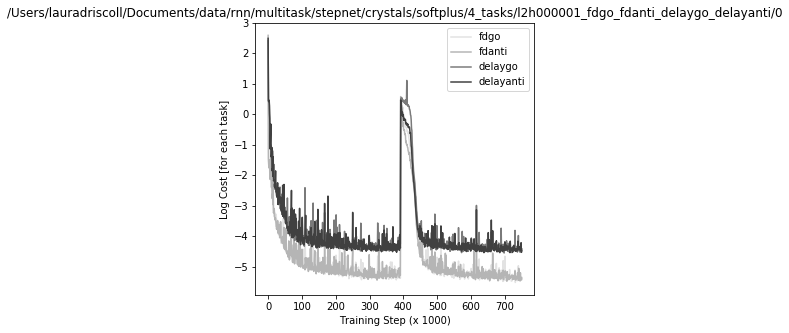

In [18]:
task_set = hparams['rule_trains']
fig = plt.figure(figsize=(5, 5))
cmap=plt.get_cmap('Greys')
fname = os.path.join(model_dir_all, 'log.json')

with open(fname, 'r') as f:
    log_all = json.load(f)
for r in range(len(task_set)):
    c = cmap((r+1)/(len(task_set)+1))
    ax = fig.add_subplot(1,1,1)
    x = np.log(log_all['cost_'+task_set[r]])
    plt.plot(x,'-',c = c,label = task_set[r])
#     plt.plot(x,'o',c = c,label = task_set[r])
    ax.set_xlabel('Training Step (x 1000)')
    ax.set_ylabel('Log Cost [for each task]')
#     plt.ylim([-6,2])
    
plt.title(model_dir_all)
plt.legend()
plt.show()  

/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/matplotlib/figure.py:2299: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


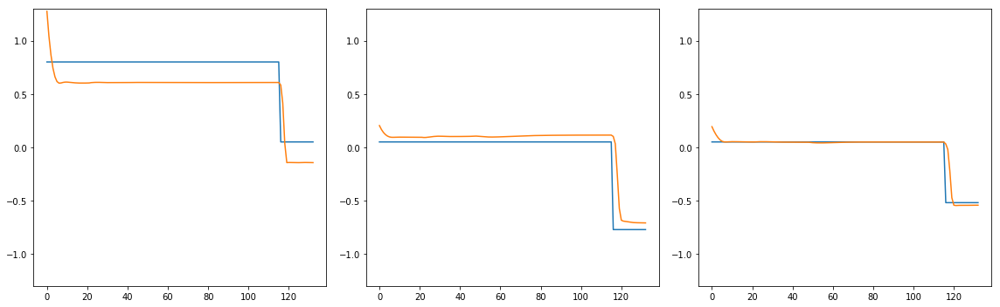

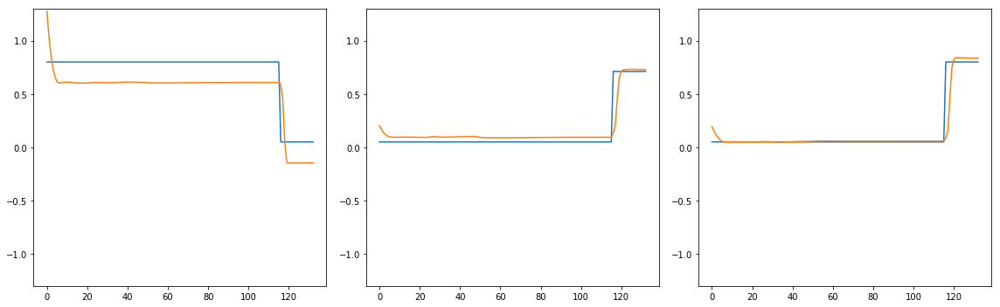

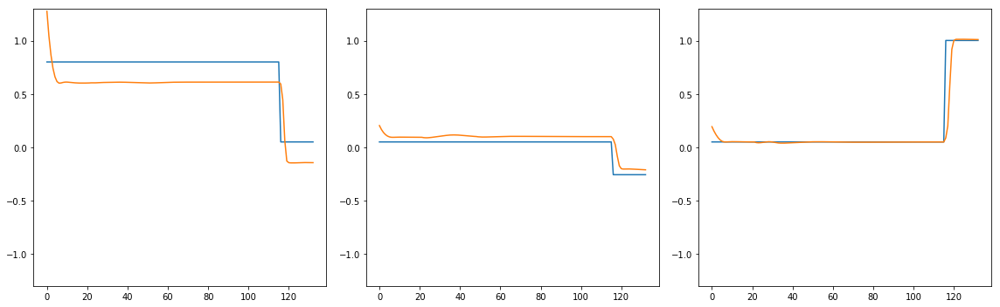

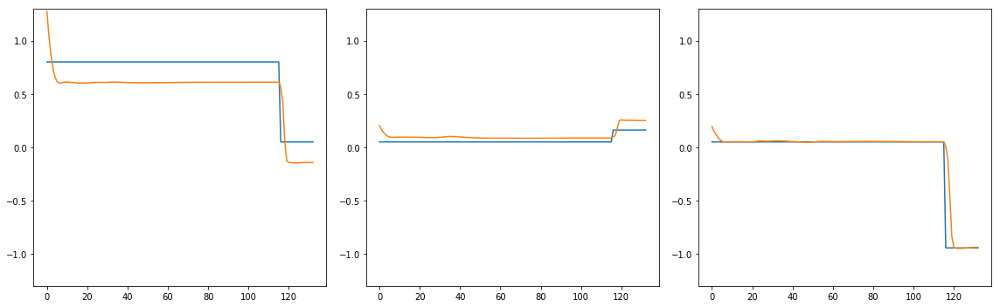

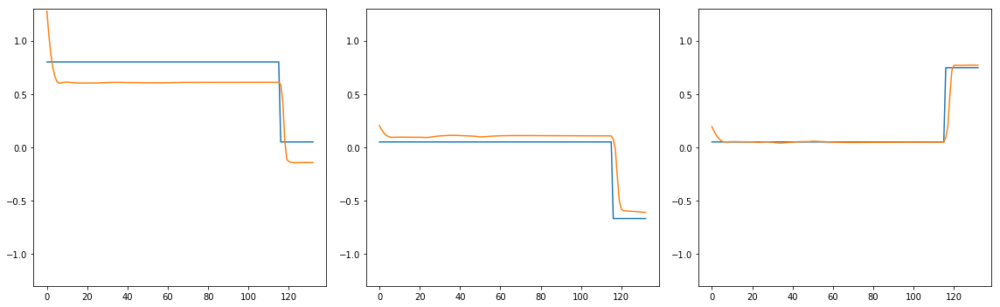

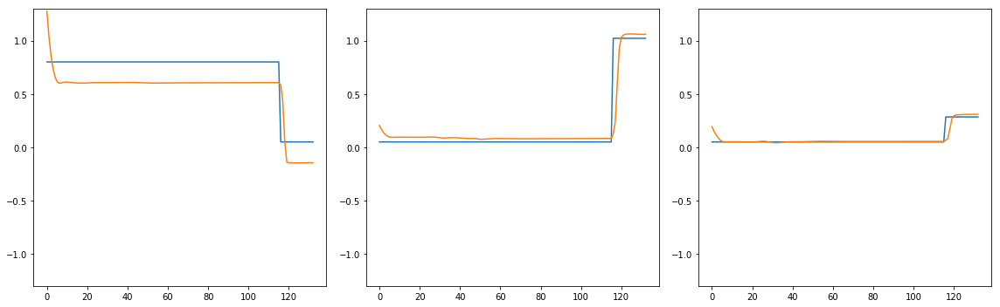

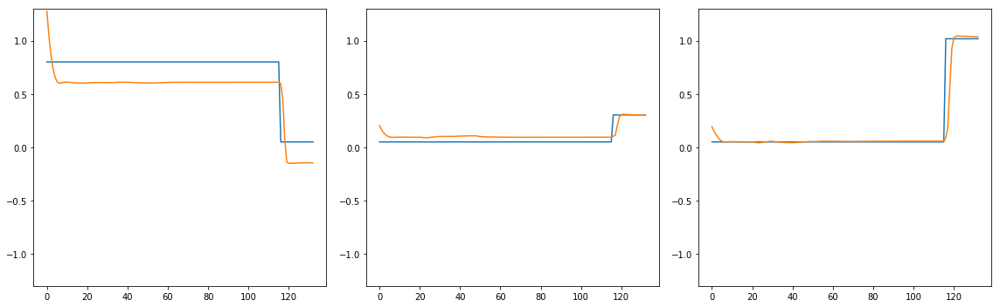

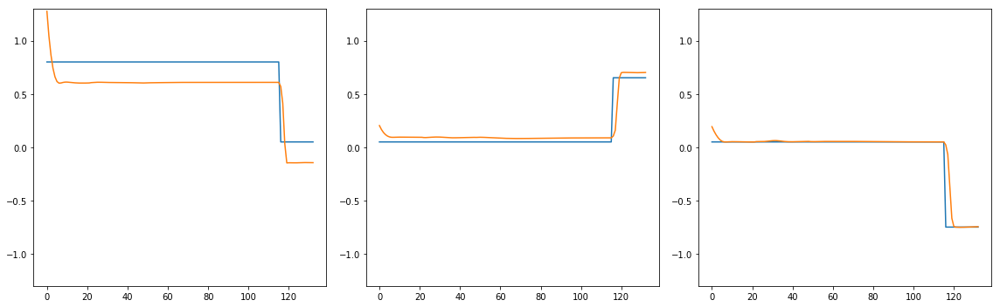

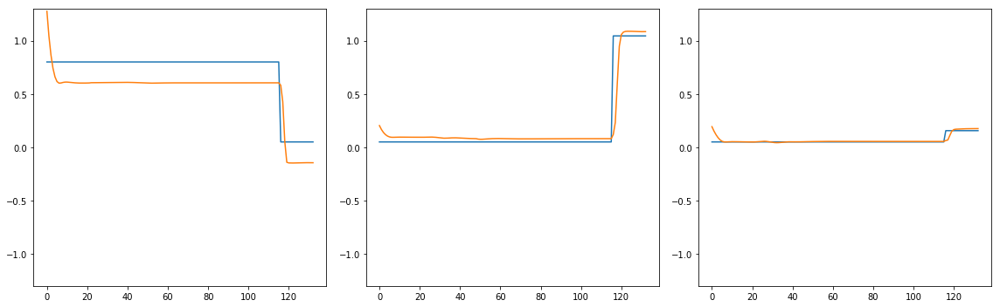

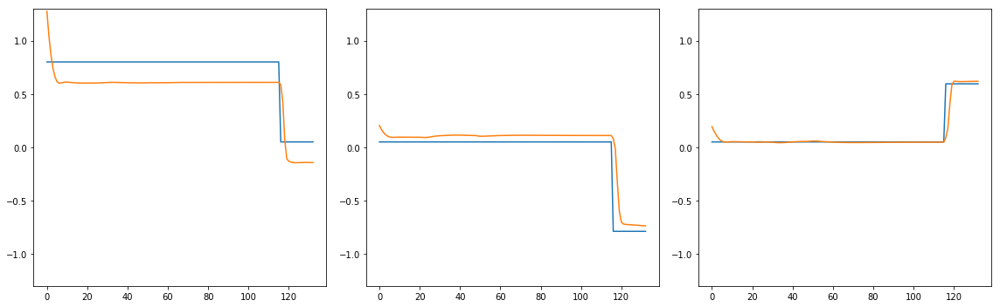

In [19]:
for tr in range(10):
    fig = plt.figure(figsize=(16,5),tight_layout=True,facecolor='white')
    for x in range(3):
        plt.subplot(1,3,x+1)
        plt.plot(trial.y[:,tr,x])
        plt.plot(np.dot(h_tf[:,tr,:],w_out[:,x]))
        plt.ylim((-1.3,1.3))
    plt.show()

In [13]:
if activation == 'softplus':
    _activation = lambda x: np.log(np.exp(x) + 1)
elif activation == 'tanh':
    _activation = lambda x: np.tanh(x)
elif activation == 'relu':
    _activation = lambda x: x * (x > 0)
elif activation == 'power':
    _activation = lambda x: (x * (x > 0))**2
elif activation == 'retanh':
    _activation = lambda x: np.tanh(x * (x > 0))

def out_affine(params, h):
    return np.dot(params[2].T,h)+params[3]

def relu(x):
    f = x * (x > 0)
    return f

def rnn_vanilla(params, h, x, alpha):
    xh = np.concatenate([x,h], axis=0)
    gate_inputs = np.dot(params[0].T,xh)+params[1]
    noise = 0
    output = _activation(gate_inputs) # + noise

    h_new = (1-alpha) * h + alpha * output
    
    return h_new

def vanilla_run_with_h0(params, x_t, h0, alpha):
    h = h0
    h_t = []
    h_t.append(np.expand_dims(h0,axis=1))
    for x in x_t:
        h = rnn_vanilla(params, np.squeeze(h), np.squeeze(x.T), alpha)
        h_t.append(np.expand_dims(h,axis=1))

    h_t = np.squeeze(np.array(h_t))  
    return h_t

def vanilla_run_at_fp(params, x_t, h0, alpha):
    h = h0
    h_t = []
    h_t.append(h)
    for x in x_t:
        h = rnn_vanilla(params, np.squeeze(h), np.squeeze(x.T), alpha)
        h_t.append(np.expand_dims(h,axis=1))
        
    return h_t

In [14]:
def plot_epochs_act_jitter(m,rule,D_use,epoch_set,epoch_order,lims = 1.5):
    for fp_epoch_ind in range(len(epoch_set)):
        fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
        ax = plt.subplot(1,len(epoch_set),fp_epoch_ind+1)
    
        plot_N_jitter(m,D_use,rule,fp_epoch,rand_step_coef = 0.1,n_steps = 70,n_jit = 20)

        plt.ylim((-lims,lims))    
        plt.xlim((-lims,lims))  
        plt.xlabel('Output ' + r' $\cos{\theta}$')

        if fp_epoch_ind==0:
            plt.ylabel('Output ' + r' $\sin{\theta}$')
        else:
            ax.get_yaxis().set_visible(False)

        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

    rule = rules_dict['all'][rule_ind]
    figpath = os.path.join(m,'Output Prep Figure jitter',rule)
    figname = rule+'_Output_axes_Act_trials.pdf'
    if not os.path.exists(figpath):
        os.makedirs(figpath)
    plt.savefig(os.path.join(figpath,figname))
plt.show()

In [15]:
def out_axes(ax):

    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    plt.ylabel('Output ' + r' $\sin{\theta}$')
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False) 
    
def PC_axes(ax):

    plt.xlabel('PC1')
    plt.ylabel('PC2')
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False) 
    
def label_fps(sorted_fps,fp_inds,D_use,offset = .1):
    
    for s in range(len(fp_inds)):
        X_trial = np.dot(sorted_fps[fp_inds[s],:],D_use)
        plt.text(X_trial[0]+offset, X_trial[1], str(fp_inds[s]))

In [16]:
def make_dst_FP(m,rule,fp_epoch,t_num,n_fps=5):
    
    cmap=plt.get_cmap('rainbow')
    
    FP_PCs, sorted_fps, fp_inds = make_FP_pcs(m,rule,fp_epoch,t_num,n_fps = n_fps)
    filename = os.path.join(m,'golub_fixed_pts',rule,fp_epoch+'_'+str(round(t_num,2))+'.npz')
    fp_struct = np.load(filename)

    model = Model(m)
    with tf.Session() as sess:
        model.restore()
        hparams = model.hp
        model._sigma=0

        trial = generate_trials(rule, hparams, mode='test', noise_on=False, batch_size = 100, delay_fac = 1)

        feed_dict = tools.gen_feed_dict(model, trial, hparams)
        h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
        T,S,N = np.shape(h_tf)
        T_inds = get_T_inds(trial,fp_epoch) # grab epoch time indexing

        dst_FP = np.zeros((len(fp_inds),len(T_inds)))

        for s in range(len(fp_inds)):
            dst_FP[s,:] = LA.norm(h_tf[T_inds,t_num,:] - np.repeat(sorted_fps[[fp_inds[s],],:],
                                                                   len(T_inds),axis = 0),axis = 1)
                
    return dst_FP, fp_struct, FP_PCs, sorted_fps, fp_inds

In [17]:
model = Model(m)
with tf.Session() as sess:
    model.restore()
    hparams = model.hp
    model._sigma=0

    trial = generate_trials(rule, hparams, mode='test', noise_on=False, batch_size = 100, delay_fac = 1)

    feed_dict = tools.gen_feed_dict(model, trial, hparams)

    x_t = np.matlib.repmat(trial.x[T_inds[1],s,:],n_steps,1)
    h0 = h_rule2[s,:]

    #nonlinear system
    h_t = vanilla_run_with_h0(params, x_t, h0, alpha)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt


NameError: name 'T_inds' is not defined

In [18]:
trial = gen_trials_from_model_dir(m,rule)
T_inds = get_T_inds(trial,fp_epoch)
x_t = np.matlib.repmat(trial.x[T_inds[0],t_num,:],n_steps,1)

_,x2 = gen_X_from_model_dir(m,trial2)
h_rule2 = x2[:,:,T_inds[0]].T
h0 = h_rule2[t_num,:]

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt


NameError: name 't_num' is not defined

In [19]:
def eval_lin_approx_FP(m,rule,fp_epoch,t_num,n_fps=5,n_steps = 200):
    
    cmap=plt.get_cmap('rainbow')
    
    FP_PCs, sorted_fps, fp_inds = make_FP_pcs(m,rule,fp_epoch,t_num,n_fps = n_fps)
    filename = os.path.join(m,'golub_fixed_pts',rule,fp_epoch+'_'+str(round(t_num,2))+'.npz')
    fp_struct = np.load(filename)


    trial = gen_trials_from_model_dir(m,rule)
    T_inds = get_T_inds(trial,fp_epoch)
    x_t = np.matlib.repmat(trial.x[T_inds[0],t_num,:],n_steps-1,1)
    
    _,x2 = gen_X_from_model_dir(m,trial)
    h_rule2 = x2[:,:,T_inds[0]].T
    h0 = h_rule2[t_num,:]

    h_tf = vanilla_run_with_h0(params, x_t, h0, alpha)
    T,N = np.shape(h_tf)
     # grab epoch time indexing

    dst_FP = np.zeros((len(fp_inds),n_steps))
    dst_nl_l = np.zeros((len(fp_inds),n_steps-1))
    dst_nl_l_update = np.zeros((len(fp_inds),n_steps-1)) 
    h_nonlin = np.zeros((n_steps-1,N))
    h_lin = np.zeros((len(fp_inds),n_steps-1,N))

    for s in range(len(fp_inds)):
        dst_FP[s,:] = LA.norm(h_tf - np.repeat(sorted_fps[[fp_inds[s],],:],n_steps,axis = 0),axis = 1)

        h_star = sorted_fps[fp_inds[s],:]
        for ti in range(n_steps-1):

            h0 = h_tf[ti,:]
            h1 = h_tf[ti+1,:]

            del_h = h1 - h_star

            #nonlinear system
            h_nonlin[ti,:] = h1

            #linear system
            h_lin[s,ti,:] = h_star + np.dot(fp_struct['J_xstar'][fp_inds[s],:,:],del_h)

            dst_nl_l_update[s,ti] = LA.norm(h_lin[s,ti,:] - h1)/LA.norm(h1-h0)
            dst_nl_l[s,ti] = LA.norm(h_lin[s,ti,:] - h1)/LA.norm(h1)
                
    return dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds

In [20]:
def plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps):
    
    S = len(fp_inds)
    w_in, b_in, w_out, b_out = get_model_params(m)
    D_out = w_out[:,1:]
    
    pca = PCA(n_components = 2,whiten = True)
    X_pca = pca.fit_transform(h_nonlin)
    D_traj = pca.components_.T

    pca = PCA(n_components = 2,whiten = True)
    X_pca = pca.fit_transform(sorted_fps[fp_inds,:])
    D_fp = pca.components_.T

    D_set = [D_traj,D_fp,D_out]
    titles = ['PCA on hidden states','PCA on FPs','Ouput']
    xlabels = ['PC1','PC1','Output ' + r' $\cos{\theta}$']
    ylabels = ['PC2','PC2','Output ' + r' $\sin{\theta}$']
    nc = len(D_set)
    nr = 1
    fig_fac = 4

    fig = plt.figure(figsize=(fig_fac*nc,fig_fac*nr),tight_layout=True,facecolor='white')
    for Di in range(len(D_set)):
        D = D_set[Di]
        ax = plt.subplot(1,len(D_set),Di+1)

        for s in range(S):
            cmap=plt.get_cmap('tab20')
            X_lin = np.dot(h_lin[s,:,:],D)
            plt.plot(X_lin[:,0],X_lin[:,1],c = cmap(s/S),linewidth = 2,alpha = .8)

            X_fp = np.dot(sorted_fps[[fp_inds[s],],:],D)
            plt.plot(X_fp[0,0],X_fp[0,1],'x',c = cmap(s/S),markersize = 10,alpha = .8)
            plt.plot(X_fp[0,0],X_fp[0,1],'.',c = cmap(s/S),markersize = 10,alpha = .8)

        X_nonlin = np.dot(h_nonlin,D)
        plt.plot(X_nonlin[:,0],X_nonlin[:,1],'-k',linewidth = 3,alpha = .8)
        plt.plot(X_nonlin[-1,0],X_nonlin[-1,1],'^k',linewidth = 2,alpha = .8)

        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False) 
        plt.xlabel(xlabels[Di])
        plt.ylabel(ylabels[Di])
        plt.title(titles[Di])

In [21]:
def plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds):

    nr = 3
    nc = 2
    fig_fac = 5
    cmap=plt.get_cmap('tab20')

    fig = plt.figure(figsize=(fig_fac*nc,fig_fac*nr),tight_layout=True,facecolor='white')

    ax = plt.subplot(nr,nc,1)
    plot_FP_jitter(m,FP_PCs,rule,t_num,fp_epoch,sorted_fps,fp_inds,[rule,],
                       rand_step_coef = 0,n_steps = 50,lw = 1,al = .5,n_jit = 1)
    label_fps(sorted_fps,fp_inds,FP_PCs,offset = .3)
    PC_axes(ax)

    ax = plt.subplot(nr,nc,2)
    w_in, b_in, w_out, b_out = get_model_params(m)
    D_use = w_out[:,1:]
    plot_FP_jitter(m,D_use,rule,t_num,fp_epoch,sorted_fps,fp_inds,[rule,],
                       rand_step_coef = 0,n_steps = 50,lw = 1,al = .5,n_jit = 1)
    label_fps(sorted_fps,fp_inds,D_use)
    out_axes(ax)   

    ax = plt.subplot(nr,nc,3)
    for s in range(len(fp_inds)):
        plt.plot(dst_FP[s,:], c = cmap(s/len(fp_inds)), alpha = .5, label = str(fp_inds[s])+' : '+
                 'log10(qstar) = '+str(np.log10(fp_struct['qstar'][fp_inds[s]])),linewidth = 3)
        plt.xlabel('Time in Epoch')
        plt.ylabel('Euc dist from FP')

    plt.legend()
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)  

    ax = plt.subplot(nr,nc,4)
    for s in range(len(fp_inds)):
        plt.plot(dst_nl_l[s,:], c = cmap(s/len(fp_inds)), alpha = .5, label = str(fp_inds[s])+' : '+
                 'qstar = '+str(fp_struct['qstar'][fp_inds[s]]),linewidth = 3)
        plt.xlabel('Time in Epoch')
        plt.ylabel('Diff from Linear Approx')
        
    ax = plt.subplot(nr,nc,5)
    for s in range(len(fp_inds)):
        plt.plot(dst_nl_l_update[s,:], c = cmap(s/len(fp_inds)), alpha = .5, label = str(fp_inds[s])+' : '+
                 'qstar = '+str(fp_struct['qstar'][fp_inds[s]]),linewidth = 3)
        plt.xlabel('Time in Epoch')
        plt.ylabel('Diff from Linear Approx')

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)  
    
    figpath = os.path.join(m,'Output Prep Figure_fp_matters',rule,fp_epoch)
    figname = rule+'_'+fp_epoch+'_lin_approx_fp'+str(fp_inds[s])+'.pdf'
    if not os.path.exists(figpath):
        os.makedirs(figpath)
    plt.savefig(os.path.join(figpath,figname))

In [22]:
def gen_X_from_model_dir(model_dir,trial):
    model = Model(model_dir)
    with tf.Session() as sess:
        model.restore()
        # model._sigma=0
        # get all connection weights and biases as tensorflow variables
        var_list = model.var_list
        # evaluate the parameters after training
        hparams = model.hp
        feed_dict = tools.gen_feed_dict(model, trial, hparams)
        # run model
        h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
        x = np.transpose(h_tf,(2,1,0)) # h_tf[:,range(1,n_trials),:],(2,1,0))
        X = np.reshape(x,(x.shape[0],-1))
    return X, x 

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/matplotlib/figure.py:2299: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


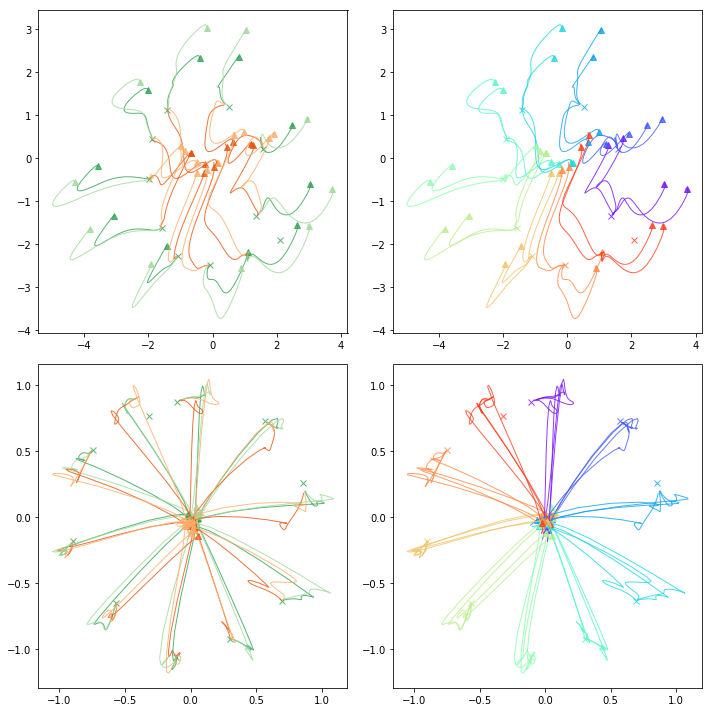

In [16]:
from tools_lnd import align_output_inds

m = m1
w_in, b_in, w_out, b_out = get_model_params(m)
D_out = w_out[:,1:]

rule_master_ind = 0
rule_master = rules_dict['all'][rule_master_ind]
n_steps = 70
tasks = [0,2,3,5]
trial_master = gen_trials_from_model_dir(m,rule_master,mode='test',noise_on = False)
T_inds = get_T_inds(trial_master,fp_epoch)
_,x_master = gen_X_from_model_dir(m,trial_master)

pca = PCA(n_components = 2,whiten = True)
X_pca = pca.fit_transform(x_master[:,:,-1].T)
D_traj = pca.components_.T

nc = 2
nr = 2
n_steps = 100
cmap=plt.get_cmap('rainbow')

fig = plt.figure(figsize=(5*nc,5*nr),tight_layout=True,facecolor='white')

for r in range(len(tasks)):

    rule2 = rules_dict['all'][tasks[r]]

    trial2 = gen_trials_from_model_dir(m,rule2,mode='random',noise_on = False,batch_size = 2000)
    trial2 = align_output_inds(trial_master, trial2)

    _,x2 = gen_X_from_model_dir(m,trial2)
    h_rule2 = x2[:,:,trial2.epochs['go1'][0]-1].T
    
    
    S = np.shape(trial2.x)[1]
    for s in range(8,S,int(S/10)): #0,S,int(S/10)
        
        if r == rule_master_ind:
            dst_FP, _, _, sorted_fps, fp_inds = make_dst_FP(m,rule_master,fp_epoch,s)
            fp = sorted_fps[fp_inds[np.argmin(dst_FP[:,-1])],:]
            fp_PCtraj = np.dot(fp,D_traj)
            fp_PCout = np.dot(fp,D_out)
        
        x_t = np.matlib.repmat(trial_master.x[T_inds[1],s,:],n_steps,1)
        h0 = h_rule2[s,:]

        #nonlinear system
        h_t = vanilla_run_with_h0(params, x_t, h0, alpha)
        
        plt.subplot(nr,nc,1)
        traj_lowd = np.dot(h_t,D_traj)
        plt.plot(traj_lowd[1,0],traj_lowd[1,1],'^',c = color_inds[tasks[r]],linewidth = 1,alpha = .8)
        plt.plot(traj_lowd[:,0],traj_lowd[:,1],'-',c = color_inds[tasks[r]],linewidth = 1,alpha = .8)
        if r == rule_master_ind:
            plt.plot(fp_PCtraj[0],fp_PCtraj[1],'x',markersize =6,c = color_inds[rule_master_ind],linewidth = 1,alpha = .8)

        plt.subplot(nr,nc,2)
        plt.plot(traj_lowd[1,0],traj_lowd[1,1],'^',c = cmap(s/S),linewidth = 1,alpha = .8)
        plt.plot(traj_lowd[:,0],traj_lowd[:,1],'-',c = cmap(s/S),linewidth = 1,alpha = .8)
        if r == rule_master_ind:
            plt.plot(fp_PCtraj[0],fp_PCtraj[1],'x',markersize =6,c = cmap(s/S),linewidth = 1,alpha = .8)

        plt.subplot(nr,nc,3)
        traj_lowd = np.dot(h_t,D_out)
        plt.plot(traj_lowd[1,0],traj_lowd[1,1],'^',c = color_inds[tasks[r]],linewidth = 1,alpha = .8)
        plt.plot(traj_lowd[:,0],traj_lowd[:,1],'-',c = color_inds[tasks[r]],linewidth = 1,alpha = .8)
        if r == rule_master_ind:
            plt.plot(fp_PCout[0],fp_PCout[1],'x',markersize =6,c = color_inds[rule_master_ind],linewidth = 1,alpha = .8)
        
        plt.subplot(nr,nc,4)
        plt.plot(traj_lowd[1,0],traj_lowd[1,1],'^',c = cmap(s/S),linewidth = 1,alpha = .8)
        plt.plot(traj_lowd[:,0],traj_lowd[:,1],'-',c = cmap(s/S),linewidth = 1,alpha = .8)
        if r == rule_master_ind:
            plt.plot(fp_PCout[0],fp_PCout[1],'x',markersize =6,c = cmap(s/S),linewidth = 1,alpha = .8)

plt.show()

In [57]:
epoch_set = ['delay1','go1']
n_epochs = len(epoch_set)
e_lims = np.zeros((2,n_epochs))
n_inputs = 10

for ei in range(len(epoch_set)):
    epoch = epoch_set[ei]
    e_start = max([0, trial.epochs[epoch][0]])
    e_lims[0,ei] = e_start
    end_set = [n_steps, trial.epochs[epoch][1]]
    e_end = min(x for x in end_set if x is not None)
    e_lims[1,ei] = e_end

In [58]:
np.squeeze(trial.x[int(e_lims[0,0]-1),t,:])

array([1., 0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0.], dtype=float32)

In [59]:
np.squeeze(trial.x[int(e_lims[0,0]),t,:])

array([1., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0.], dtype=float32)

In [82]:
t = 0
inputs_1 = trial.x[int(e_lims[0,0]),t,:]
inputs_2 = trial.x[int(e_lims[0,1]),t,:]
del_inputs = inputs_2 - inputs_1

step_inputs = inputs_1[np.newaxis,:]
for ni in range(n_inputs):
    step_inputs = np.concatenate((step_inputs,step_inputs[-1,:]+del_inputs[np.newaxis,:]*(1/n_inputs)),axis = 0)

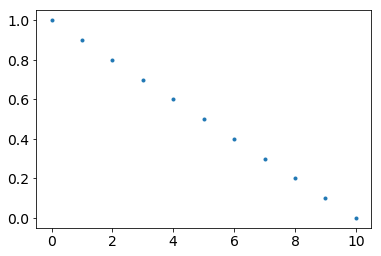

In [83]:
plt.plot(step_inputs[:,0],'.')
plt.plot()

In [74]:
np.dot(del_inputs[:,np.newaxis],range(n_inputs)[np.newaxis,:])

TypeError: list indices must be integers, not tuple

In [23]:
def plot_h_mds_steps(X_transformed,n_interp,nfps,line_alpha = .1,rot = -10,dot_alpha = .3,
               size=20, ha="left", va="top"):
    cmap=plt.get_cmap('rainbow')
        
    for ri in range(n_interp):
        c = cmap(ri/n_interp)
        X_trial = X_transformed[(ri*nfps):((ri+1)*nfps),:]
        plt.plot(X_trial[:,0],X_trial[:,1],'o',c = c,alpha = dot_alpha)

        
    plt.xlabel('MDS 1')
    plt.ylabel('MDS 2')
    return

def plot_h_mds(X_transformed,tasks,n_trials_each,line_alpha = .1,rot = -10,dot_alpha = .3,
               color_inds = color_inds, size=20, ha="left", va="top"):
    
    for ri in range(len(tasks)):
        rule_ind = tasks[ri]
        c = color_inds[rule_ind]
        X_trial = X_transformed[(ri*n_trials_each):((ri+1)*n_trials_each),:]

        plt.plot(X_trial[:,0],X_trial[:,1],'o',c = c,alpha = dot_alpha,label = rule_set_names[rule_ind])
        label_trial = npr.randint(np.shape(X_trial)[0])
        plt.text(np.mean(X_trial[label_trial,0]),np.mean(X_trial[label_trial,1]),rule_set_names[rule_ind],size=size, rotation=rot,
                 ha=ha, va=va,bbox=dict(boxstyle="square",ec='None',fc=c,alpha = dot_alpha))

    plt.xlabel('MDS 1')
    plt.ylabel('MDS 2')
    return

def plot_h_mds_out(X_transformed,y_out,tasks,n_trials_each,line_alpha = .1,rot = -10,dot_alpha = .3,
               size=20, ha="left", va="top"):
    
    cmap=plt.get_cmap('rainbow')
    
    for ri in range(len(tasks)):
        
        y_out_adjust = y_out[ri,:]
        y_out_adjust[y_out_adjust<0] = 2*np.pi+y_out_adjust[y_out_adjust<0]
    
    
        rule_ind = tasks[ri]
        X_trial = X_transformed[(ri*n_trials_each):((ri+1)*n_trials_each),:]

        for xi in range(np.shape(X_trial)[0]):
            c = cmap(y_out_adjust[xi]/(2*np.pi))
            plt.plot(X_trial[xi,0],X_trial[xi,1],'o',c = c,alpha = dot_alpha,label = rule_set_names[rule_ind])
        
#         plt.text(np.mean(X_trial[0,0]),np.mean(X_trial[0,1]),rule_set_names[rule_ind],size=size, rotation=rot,
#                      ha=ha, va=va,bbox=dict(boxstyle="square",ec='None',fc='w',alpha = dot_alpha))

    plt.xlabel('MDS 1')
    plt.ylabel('MDS 2')
    return

In [24]:
def plot_stability(m,rule,fp_struct,t_num,fp_epoch,sorted_fps, fp_inds,rand_step_coef = .1):
    eig_decomps = comp_eig_decomp(fp_struct['J_xstar'][:,:,:])
    w_in, b_in, w_out, b_out = get_model_params(m)
    D_use = w_out[:,1:]

    S = np.shape(fp_struct['qstar'])[0]
    xs = np.linspace(-1, 1, 1000)
    ys = np.sqrt(1 - xs**2)

    for s in fp_inds:
        fig = plt.figure(figsize=(15,5),tight_layout=True,facecolor='white')
        ax = plt.subplot(1,3,1)

        plot_FP_jitter(m,D_use,rule,t_num,fp_epoch,sorted_fps,fp_inds,[rule,],
                           rand_step_coef = 0.1,n_steps = 10,lw = 1,al = .5,n_jit = 1)
        plot_FP_specific(s,sorted_fps, w_out[:,1:].T, eig_decomps, c = 'r')
        label_fps(sorted_fps,fp_inds,D_use)
        out_axes(ax)  

        ax = plt.subplot(1,3,2)
        plt.plot(eig_decomps[s]['evals'].real,eig_decomps[s]['evals'].imag,'.')
        plt.plot(xs, ys,':k')
        plt.plot(xs, -ys,':k')
        plt.ylim((-.5,.5))    
        plt.xlim((.3,1.3))

        plt.title(str(s)+ ' : ' + str(fp_struct['qstar'][s]))
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)  

        n_steps = 5
        ax = plt.subplot(1,3,3)
        trial = gen_trials_from_model_dir(m,rule,mode='test',noise_on = False)
        T_inds = get_T_inds(trial,fp_epoch)
        x_t = np.matlib.repmat(trial.x[T_inds[1],s,:],n_steps,1)
        for jit in range(10):
            del_h = rand_step_coef*npr.randn(N)
            h0 = sorted_fps[s,:] + del_h

            #nonlinear system
            h_t = vanilla_run_with_h0(params, x_t, h0, alpha)
            jitter = np.dot(h_t,D_use)
            plt.plot(jitter[1,0],jitter[1,1],'^k',linewidth = .1,alpha = .2)
            plt.plot(jitter[:2,0],jitter[:2,1],'-k',linewidth = 1,alpha = .5)

            #linear system
            h1 = sorted_fps[s,:] + np.dot(fp_struct['J_xstar'][s,:,:],del_h)
            h_t = np.concatenate((h0[np.newaxis,:],h1[np.newaxis,:]),axis = 0)
            jitter = np.dot(h_t,D_use)
            plt.plot(jitter[1,0],jitter[1,1],'^b',linewidth = .1,alpha = .2)
            plt.plot(jitter[:2,0],jitter[:2,1],'-b',linewidth = 1,alpha = .5)
            
        figpath = os.path.join(m,'Output Prep Figure_fp_matters',rule,fp_epoch)
        figname = rule+'_'+fp_epoch+'_lin_approx_fp'+str(fp_inds[s])+'.pdf'
        if not os.path.exists(figpath):
            os.makedirs(figpath)
        plt.savefig(os.path.join(figpath,figname))

def plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds):
    cmap=plt.get_cmap('tab20')
    eig_decomps = comp_eig_decomp(fp_struct['J_xstar'][:,:,:])

    S = len(fp_inds)
    xs = np.linspace(-1, 1, 1000)
    ys = np.sqrt(1 - xs**2)

    fig = plt.figure(figsize=(5*S,5),tight_layout=True,facecolor='white')
    for si in range(len(fp_inds)):
        s = fp_inds[si]

        ax = plt.subplot(1,S,si+1)
        plt.plot(eig_decomps[s]['evals'].real,eig_decomps[s]['evals'].imag,'.',c = cmap(si/S))
        plt.plot(xs, ys,':k')
        plt.plot(xs, -ys,':k')
        plt.ylim((-.3,.3))    
        plt.xlim((.5,1.2))

        plt.title(str(s)+ ' : ' + str(fp_struct['qstar'][s]))
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False) 
            
    figpath = os.path.join(m,'Output Prep Figure_fp_matters',rule,fp_epoch)
    figname = rule+'_'+fp_epoch+'_stability_condensed.pdf'
    if not os.path.exists(figpath):
        os.makedirs(figpath)
    plt.savefig(os.path.join(figpath,figname))

In [37]:
t_num = 0
n_fps = 10

fp_all = []
for fp_epoch in ['fix1','stim1','go1']:
    for r in range(len(tasks)):

        rule2 = rules_dict['all'][tasks[r]]
        trial2 = gen_trials_from_model_dir(m,rule2,mode='random',noise_on = False,batch_size = 2000)
        trial2 = align_output_inds(trial_master, trial2)

        _,x2 = gen_X_from_model_dir(m,trial2)
        T_inds = get_T_inds(trial2,fp_epoch)
        h_tf = x2[:,:,T_inds[1]].T

        FP_PCs, sorted_fps, fp_inds = make_FP_pcs(m,rule2,fp_epoch,t_num,n_fps = n_fps)
        filename = os.path.join(m,'golub_fixed_pts',rule2,fp_epoch+'_'+str(t_num)+'.npz')
        fp_struct = np.load(filename)

        dst_FP = np.zeros((n_fps))
        for s in range(n_fps):
            dst_FP[s] = LA.norm(h_tf[t_num,:] - sorted_fps[fp_inds[s],:])

        fps_sorted = sorted_fps[fp_inds[np.argsort(dst_FP)],:]

        if fp_all == []:
            fp_all = fps_sorted
        else:
            fp_all = np.concatenate((fp_all, fps_sorted), axis=0)    

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/ipykernel_launcher.py:26: DeprecationWarning: elementwise == comparison failed; this will raise an error in the future.


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

In [85]:
X = np.squeeze(fp_all).astype(np.float64)
D = np.zeros((np.shape(X)[0],np.shape(X)[0]))
dst = np.zeros((np.shape(X)[0],np.shape(X)[0]))
for xi in range(np.shape(X)[0]):
    for yi in range(np.shape(X)[0]):
        D[xi,yi] = LA.norm(X[xi,:]-X[yi,:])
        dst[xi,yi] = distance.euclidean(X[xi,:], X[yi,:])
        
embedding = MDS(n_components = 2,dissimilarity = 'precomputed')
X_out = embedding.fit_transform(dst)

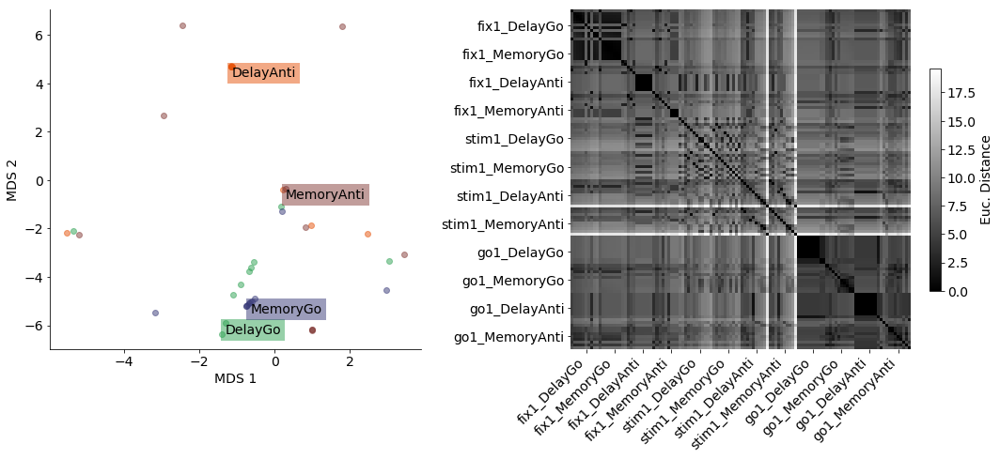

In [117]:
new_names = []
for fp_epoch in ['fix1','stim1','go1']:
    new_names = np.concatenate((new_names,[fp_epoch+'_'+rule_set_names[x] for x in tasks]))

fig = plt.figure(figsize=(15,7),tight_layout=True,facecolor='white')
plt.rcParams.update({'font.size': 14})

ax1 = plt.subplot(1,2,1)
n_trials_each = 10
plot_h_mds(X_out,tasks,n_trials_each,line_alpha = .1,rot = 0,dot_alpha = .5,
               color_inds = color_inds_nu, ha="left", va="top",size= 14)
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)

ax2 = plt.subplot(1,2,2)
# n_trials_each = 100
plt.imshow(D,'gray')
tick_locs = range(int(n_trials_each/2),n_trials_each*len(new_names),n_trials_each)
plt.xticks(tick_locs,new_names,rotation = 45, ha="right", va="top")
plt.yticks(tick_locs,new_names)

cbar = plt.colorbar(fraction = .03)
cbar.set_label('Euc. Distance')

ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.spines['bottom'].set_visible(False)

figpath = os.path.join(m,'Output Prep Figure_fp_matters')
figname = 'fp_dst.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

In [26]:
m = '/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0'
m = '/Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0'
cmap=plt.get_cmap('rainbow')

def get_filename(epoch_set,t,step):
    filename = epoch_set[0]+'_'+epoch_set[1]+'_trial_'+str(t)+'_step_'+str(step)
    return filename

In [27]:
t = 0
t_num = t
epoch_set = ['delay1','go1']
rule = 'delaygo'
n_interp = 20
n_fps = 10

trial = gen_trials_from_model_dir(m,rule)
_,x2 = gen_X_from_model_dir(m,trial)
T_inds = get_T_inds(trial,epoch_set[0])
h_tf = x2[:,:,T_inds[1]].T
fp_steps = []

for step_i in range(n_interp):
    
    filename = get_filename(epoch_set, t, step_i)
    filename = os.path.join(m,'fixed_pts_stepX_same_init',rule,filename+'.npz')
    fp_struct = np.load(filename)
    
    sorted_fps = fp_struct['xstar']
    kmeans = KMeans(n_clusters=n_fps, random_state=0).fit(sorted_fps)
    _,fp_inds = np.unique(kmeans.labels_,return_index=True)

    dst_FP = np.zeros((n_fps))
    for s in range(n_fps):
        dst_FP[s] = LA.norm(h_tf[t,:] - sorted_fps[fp_inds[s],:])

    fps_sorted = sorted_fps[fp_inds[np.argsort(dst_FP)],:]

    if fp_steps == []:
        fp_steps = fps_sorted
    else:
        fp_steps = np.concatenate((fp_steps, fps_sorted), axis=0)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/mu

IOError: [Errno 2] No such file or directory: '/Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/fixed_pts_stepX_same_init/delaygo/delay1_go1_trial_0_step_0.npz'

In [102]:
X = np.squeeze(fp_steps).astype(np.float64)
D = np.zeros((np.shape(X)[0],np.shape(X)[0]))
dst = np.zeros((np.shape(X)[0],np.shape(X)[0]))
for xi in range(np.shape(X)[0]):
    for yi in range(np.shape(X)[0]):
        D[xi,yi] = LA.norm(X[xi,:]-X[yi,:])
        dst[xi,yi] = distance.euclidean(X[xi,:], X[yi,:])
        
embedding = MDS(n_components = 2,dissimilarity = 'precomputed')
X_steps = embedding.fit_transform(dst)

In [103]:
tasks

NameError: name 'tasks' is not defined

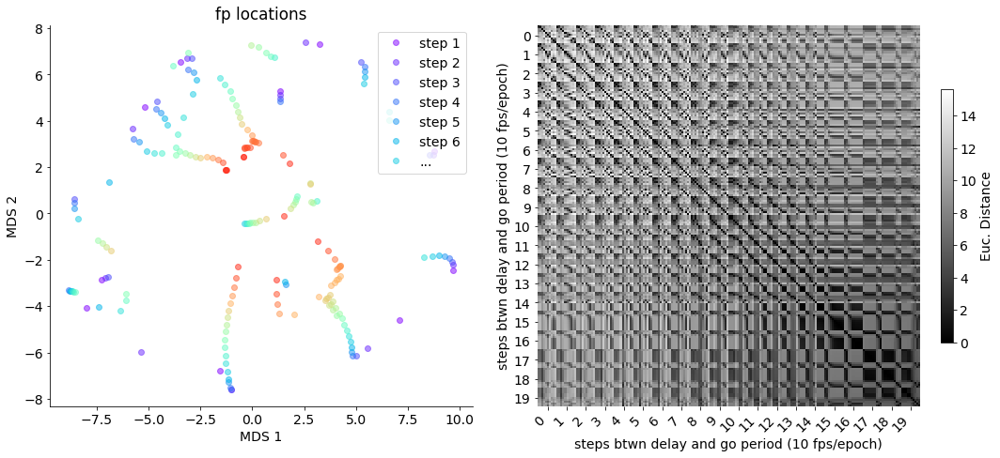

In [105]:
new_names = [str(step_i) for step_i in range(n_interp)]

fig = plt.figure(figsize=(15,7),tight_layout=True,facecolor='white')
plt.rcParams.update({'font.size': 14})

ax1 = plt.subplot(1,2,1)
plot_h_mds_steps(X_steps,n_interp,n_fps,line_alpha = .1,rot = 0,dot_alpha = .5,
               ha="left", va="top",size= 14)
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
plt.legend((['step 1','step 2','step 3','step 4','step 5','step 6','...']))
plt.title('fp locations')

ax2 = plt.subplot(1,2,2)
# n_trials_each = 100
plt.imshow(D,'gray')
tick_locs = range(int(n_fps/2),n_fps*n_interp,n_fps)
plt.xticks(tick_locs,new_names,rotation = 45, ha="right", va="top")
plt.yticks(tick_locs,new_names)
plt.xlabel('steps btwn delay and go period (10 fps/epoch)')
plt.ylabel('steps btwn delay and go period (10 fps/epoch)')

cbar = plt.colorbar(fraction = .03)
cbar.set_label('Euc. Distance')

ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.spines['bottom'].set_visible(False)

# figpath = os.path.join(m,'Output Prep Figure_fp_matters')
# figname = 'fp_dst.pdf'
# if not os.path.exists(figpath):
#     os.makedirs(figpath)
# plt.savefig(os.path.join(figpath,figname))
# plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/fdgo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/fdgo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitas

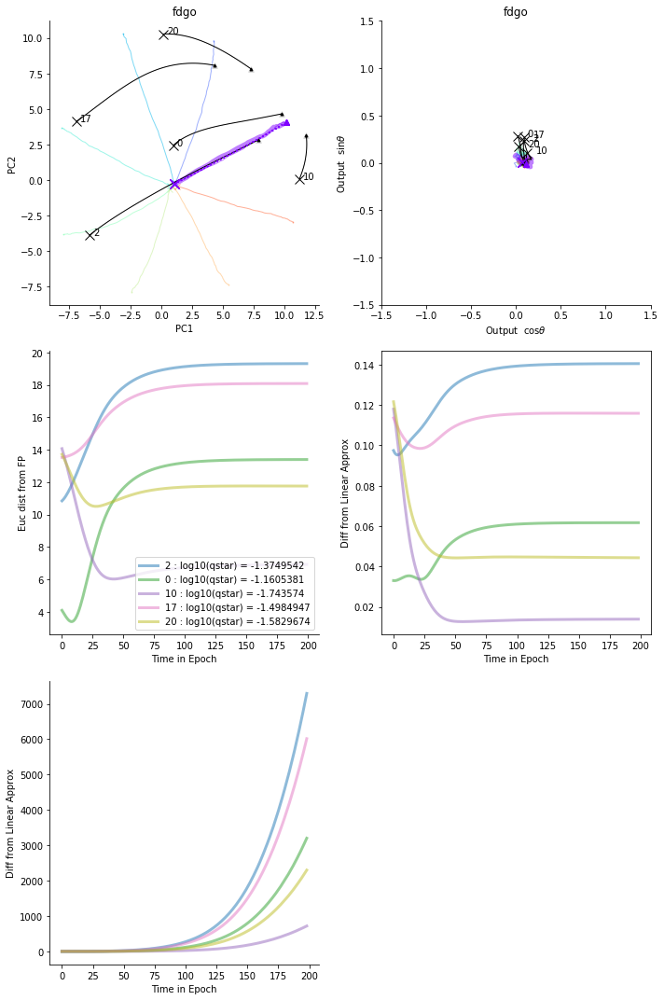

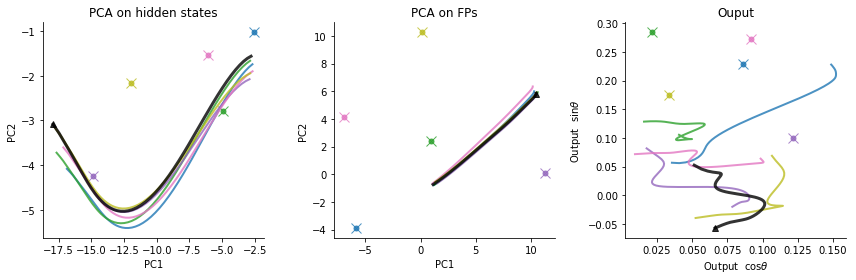

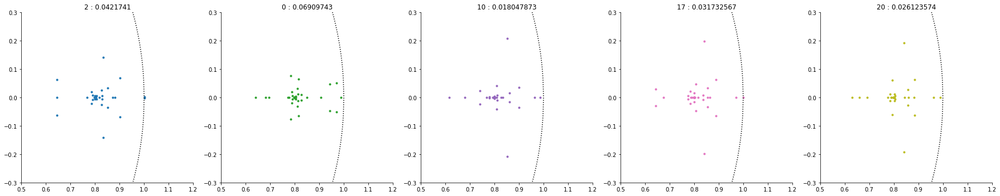

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/fdgo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/fdgo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitas

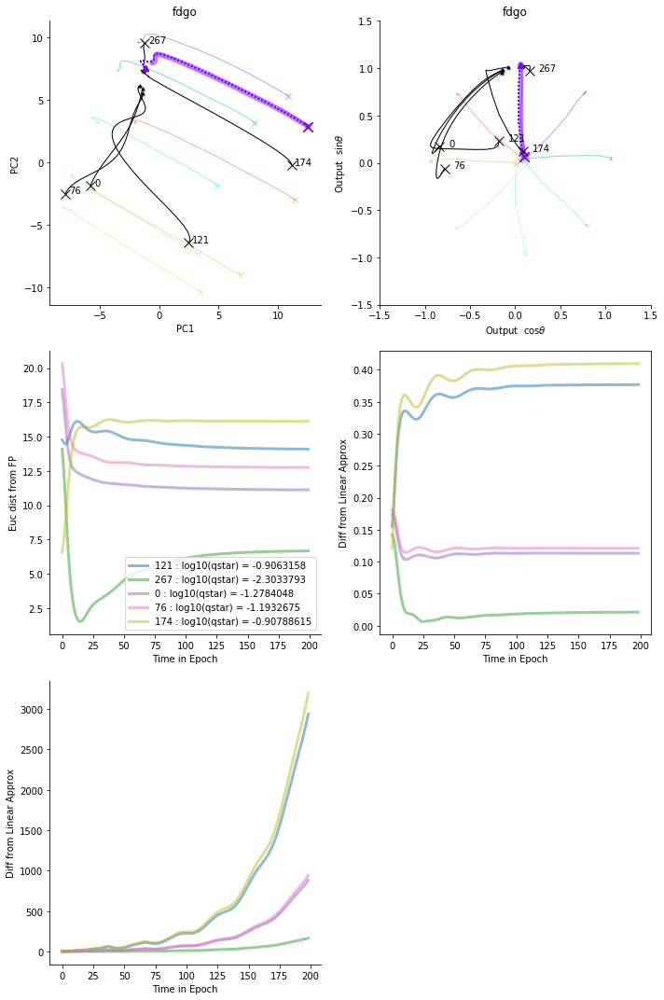

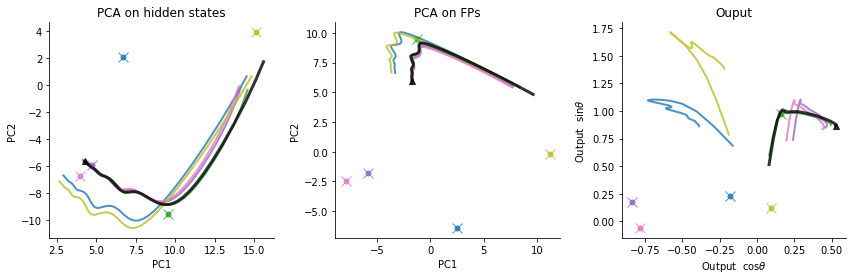

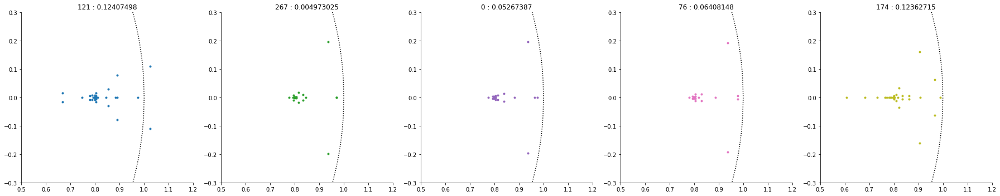

In [34]:
rule = 'fdgo'
epoch_set = ['stim1','go1']

for fp_epoch in epoch_set:
    for t_num in range(1):
        dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m,rule,fp_epoch,t_num)
        plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
        plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps)
        plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds)

        plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/mu

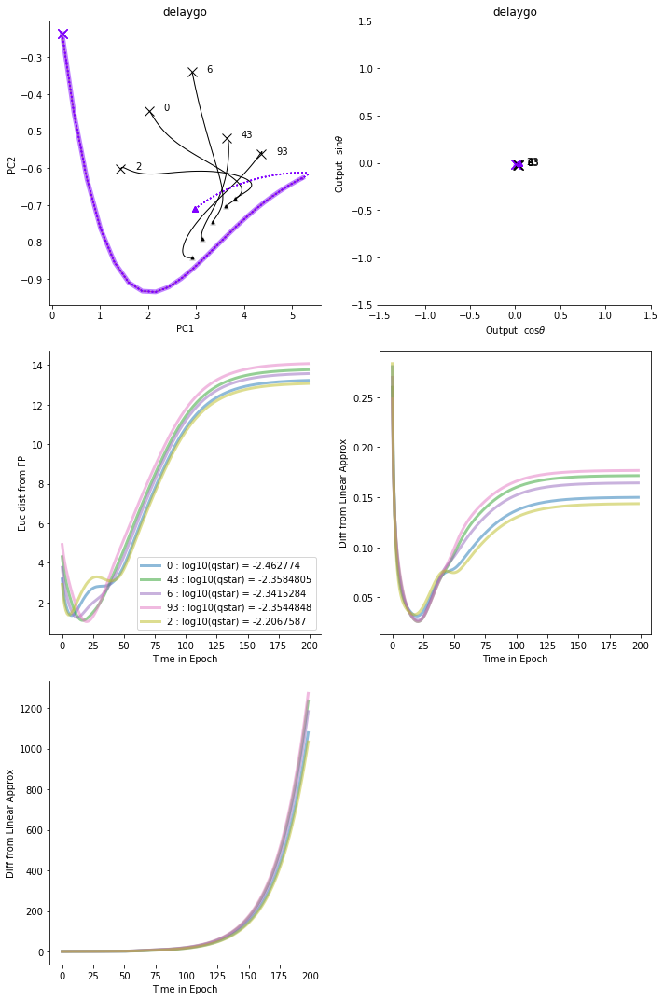

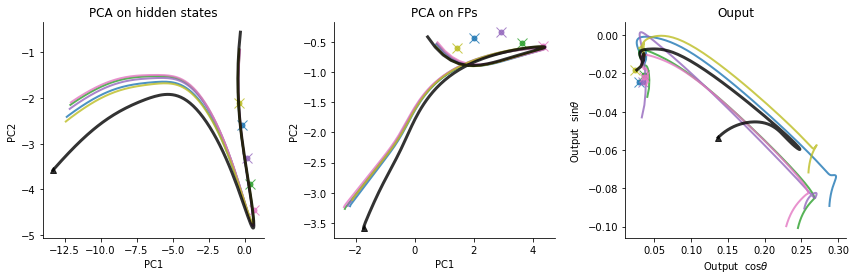

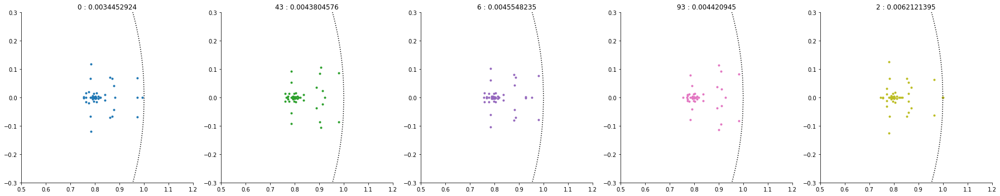

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/mu

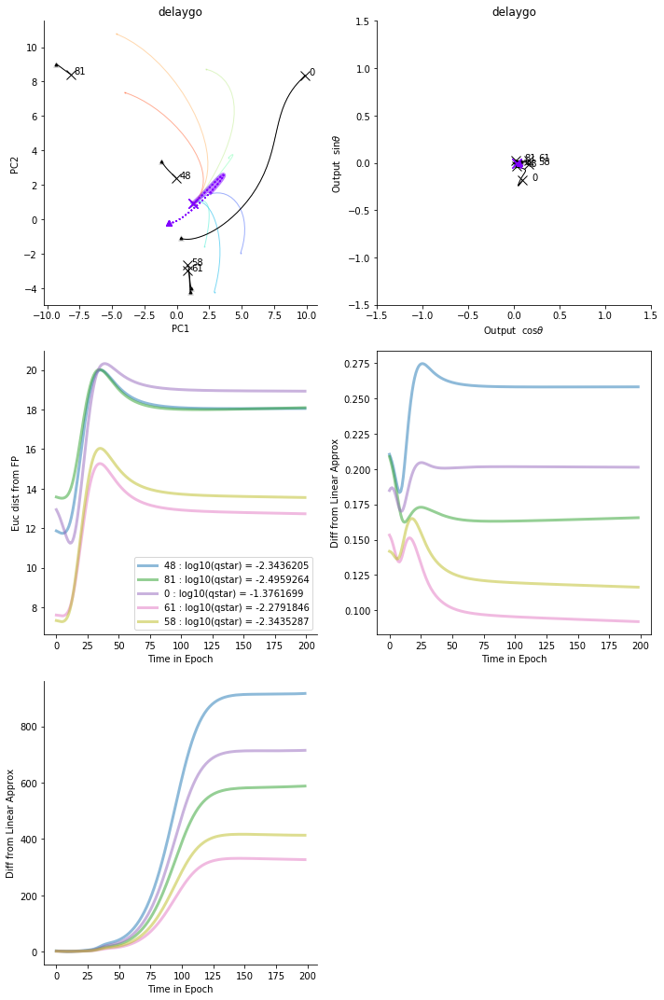

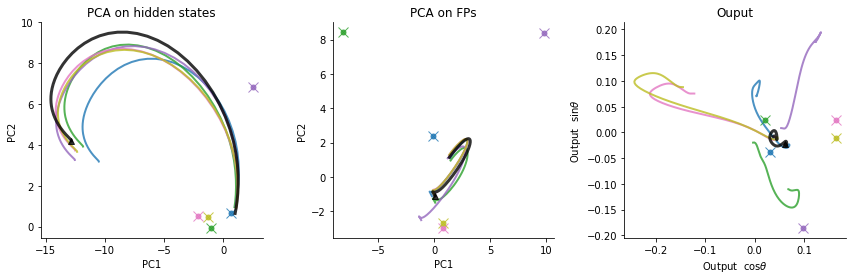

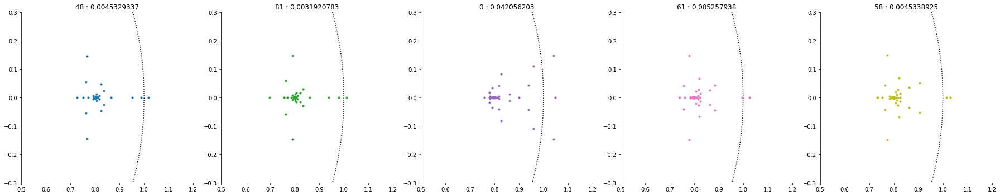

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/mu

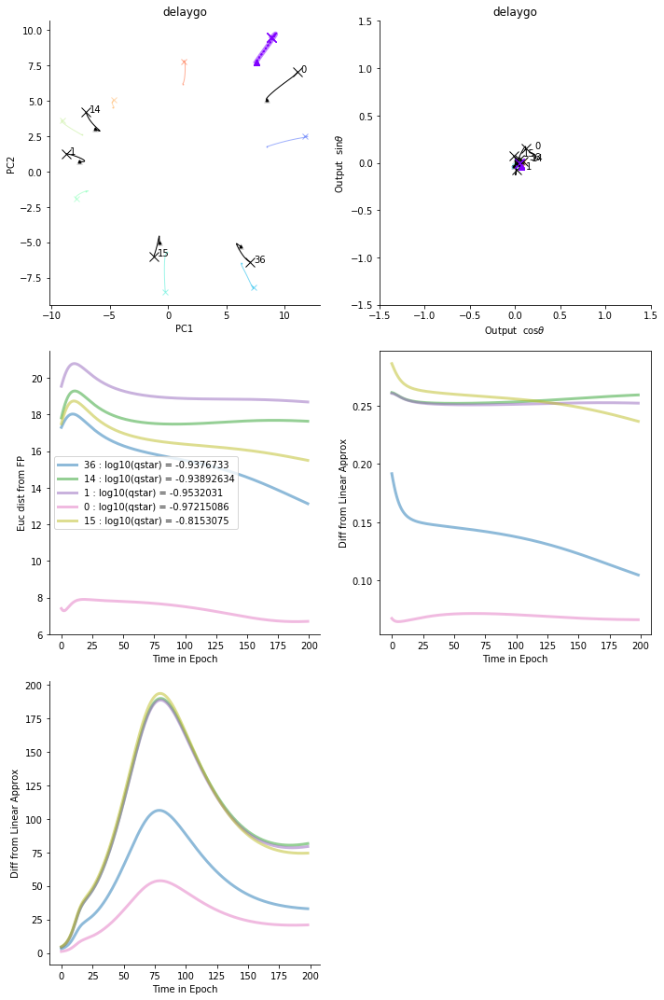

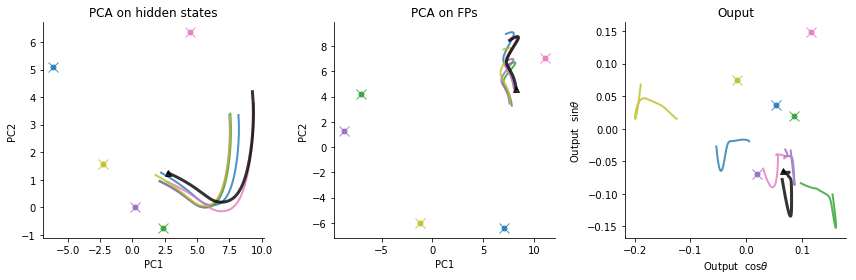

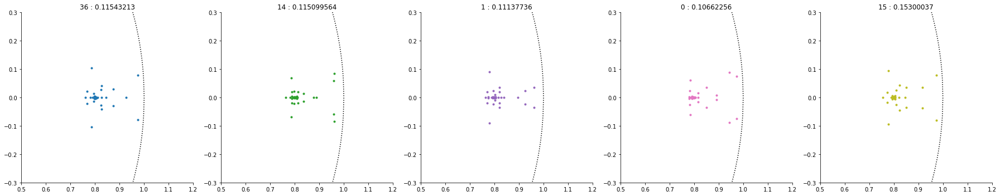

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/stepnet/crystals/softplus/single_tasks/l2w0001/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/mu

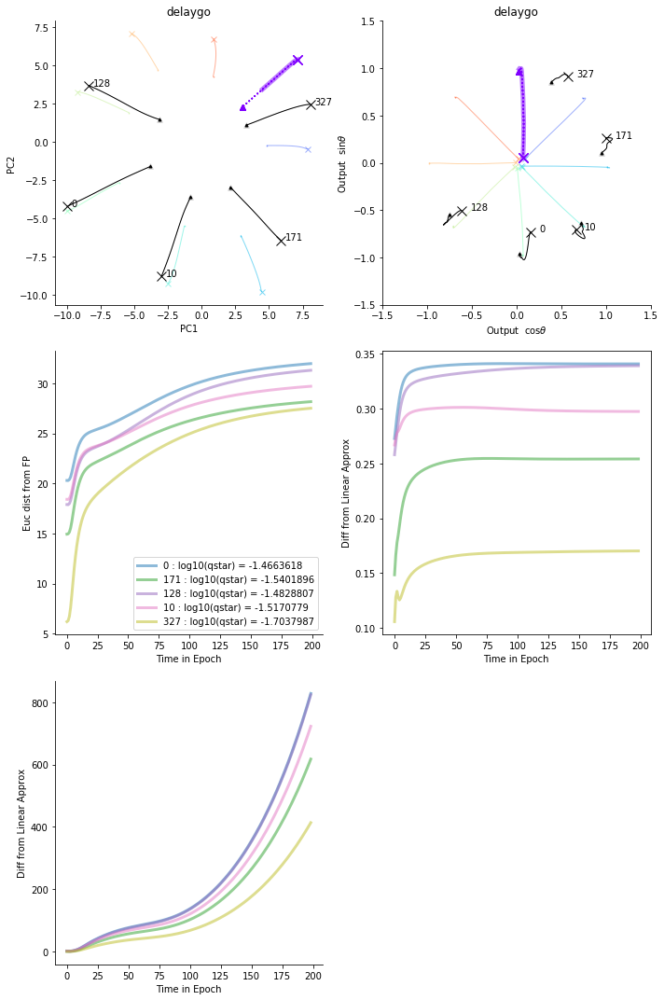

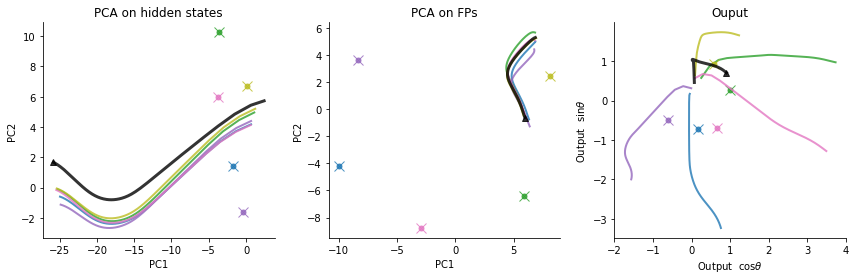

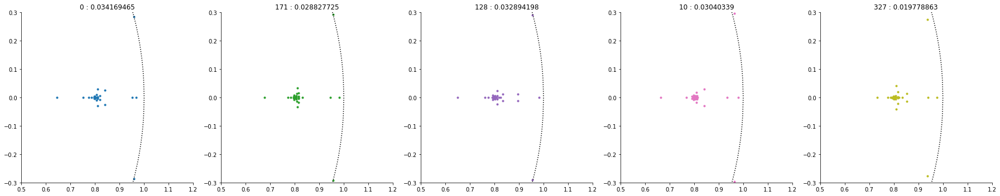

In [28]:
rule = 'delaygo'
epoch_set = ['fix1','stim1','delay1','go1']

for fp_epoch in epoch_set:
    for t_num in range(1):
        dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m,rule,fp_epoch,t_num)
        plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
        plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps)
        plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds)

        plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crysta

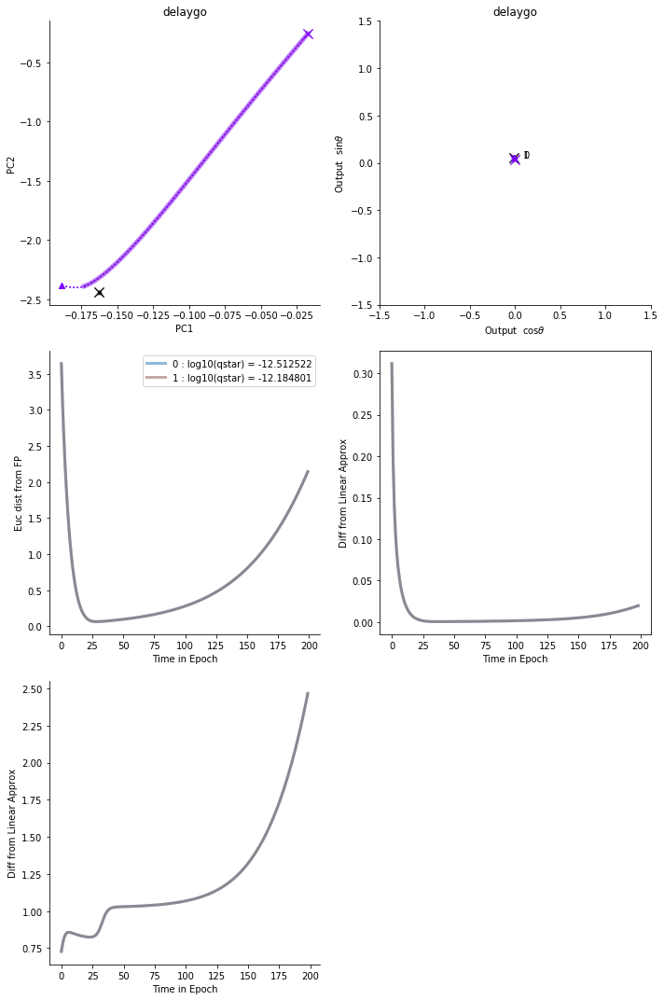

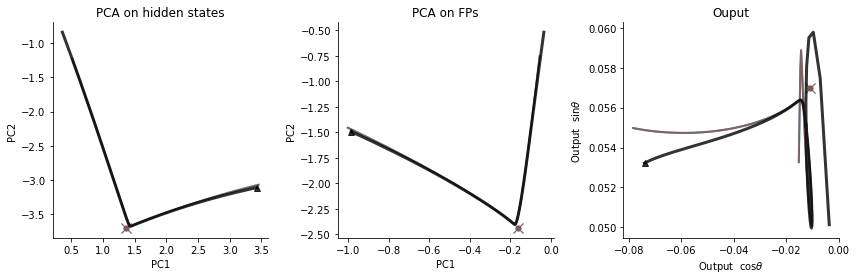

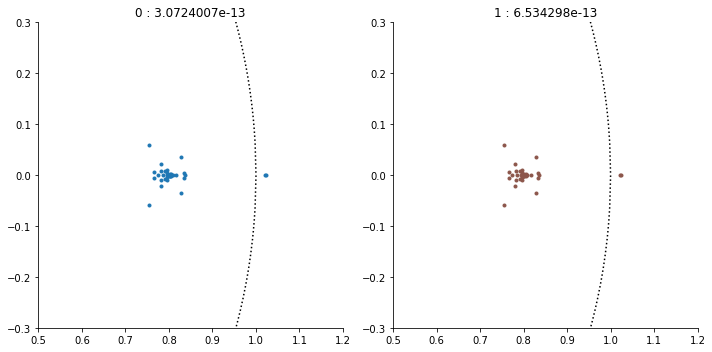

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crysta

/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: divide by zero encountered in log10


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt


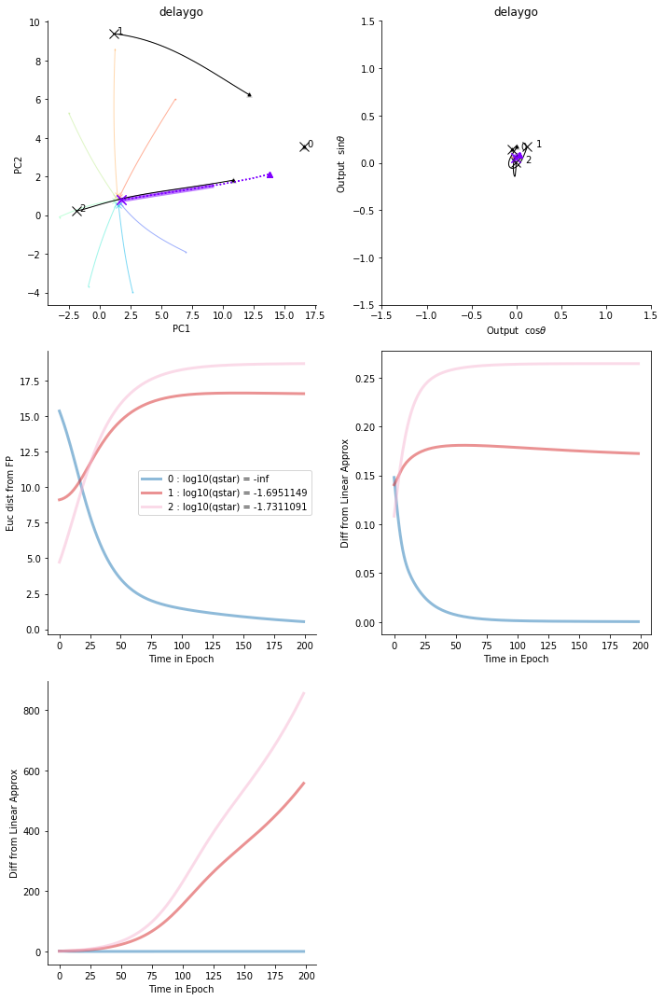

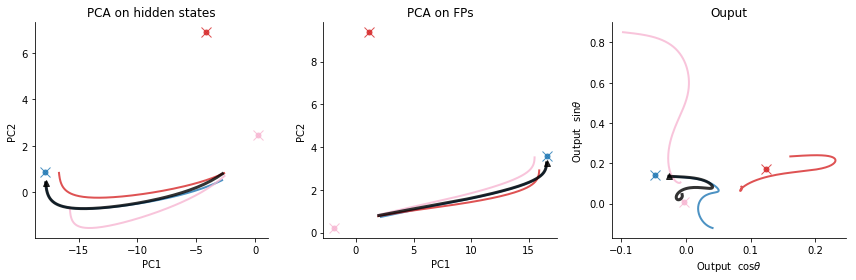

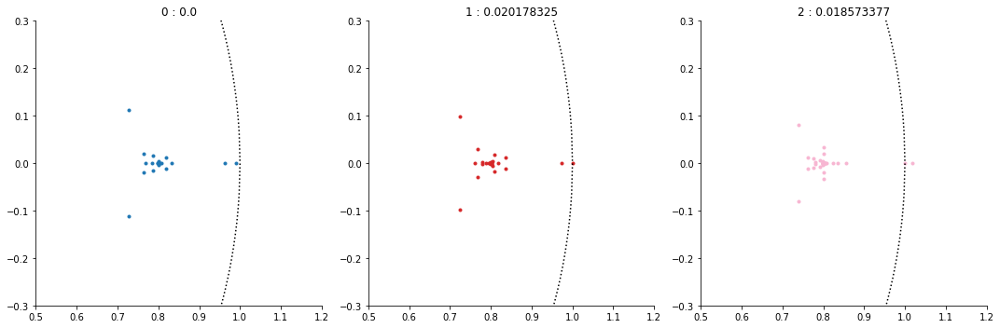

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crysta

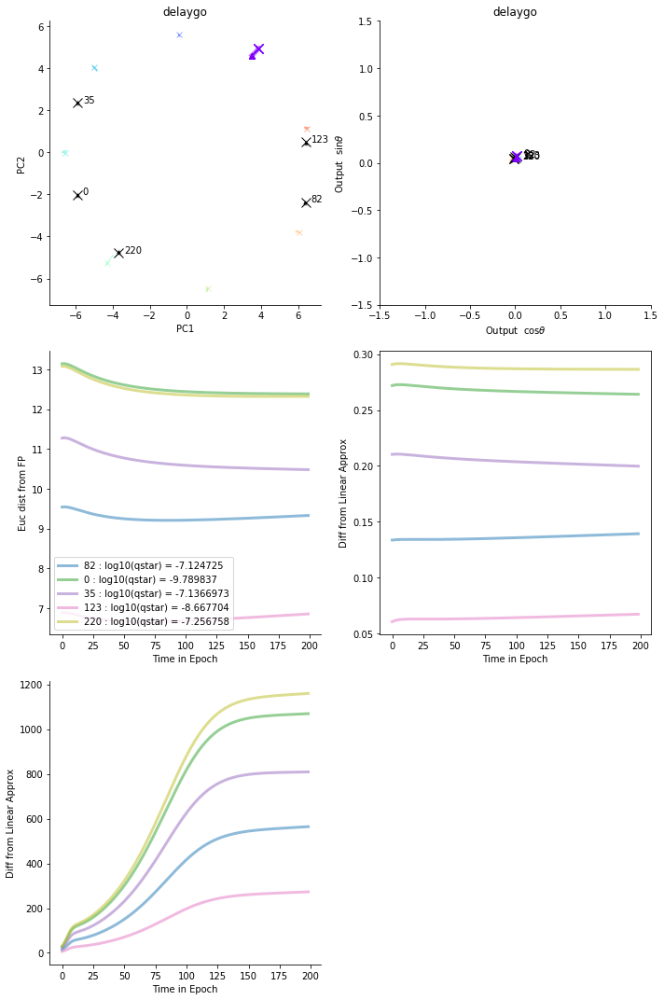

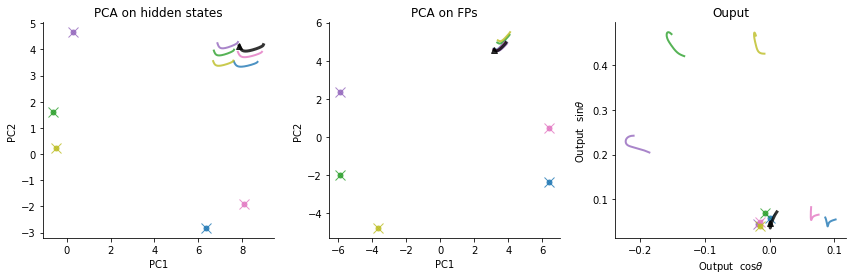

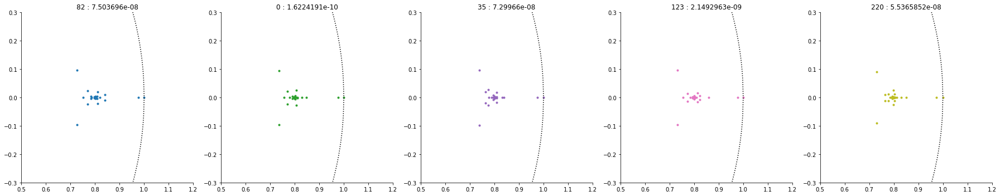

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/single_tasks_no_noise/delaygo/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crysta

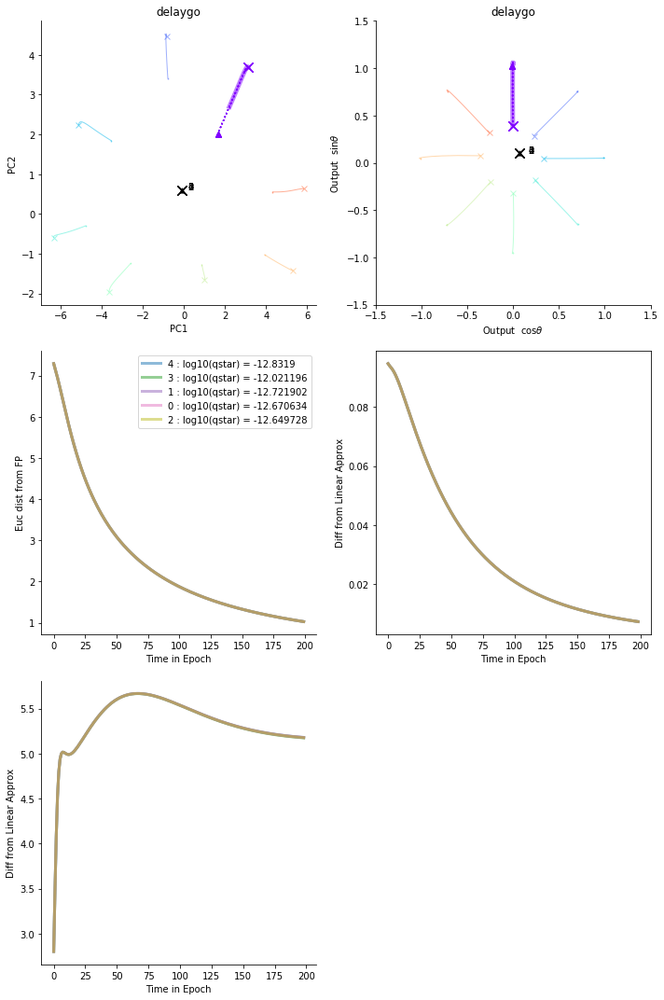

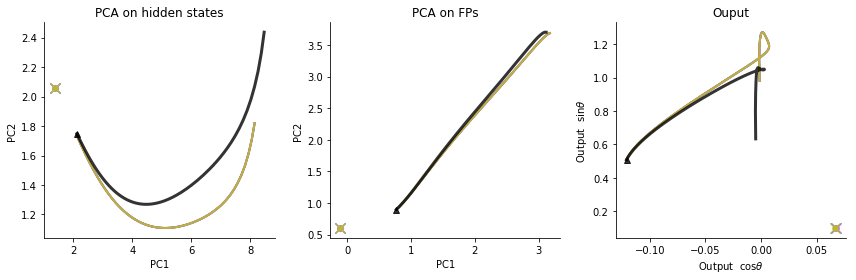

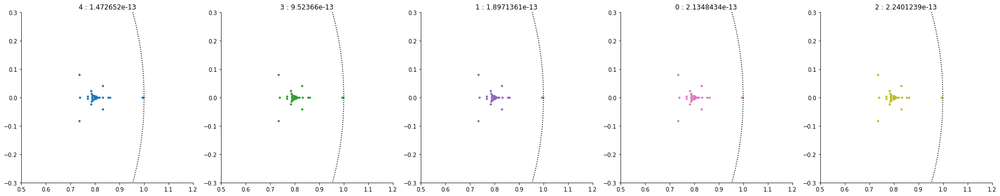

In [61]:
rule = 'delaygo'
epoch_set = ['fix1','stim1','delay1','go1']

for fp_epoch in epoch_set:
    for t_num in range(1):
        dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m,rule,fp_epoch,t_num)
        plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
        plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps)
        plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds)

        plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

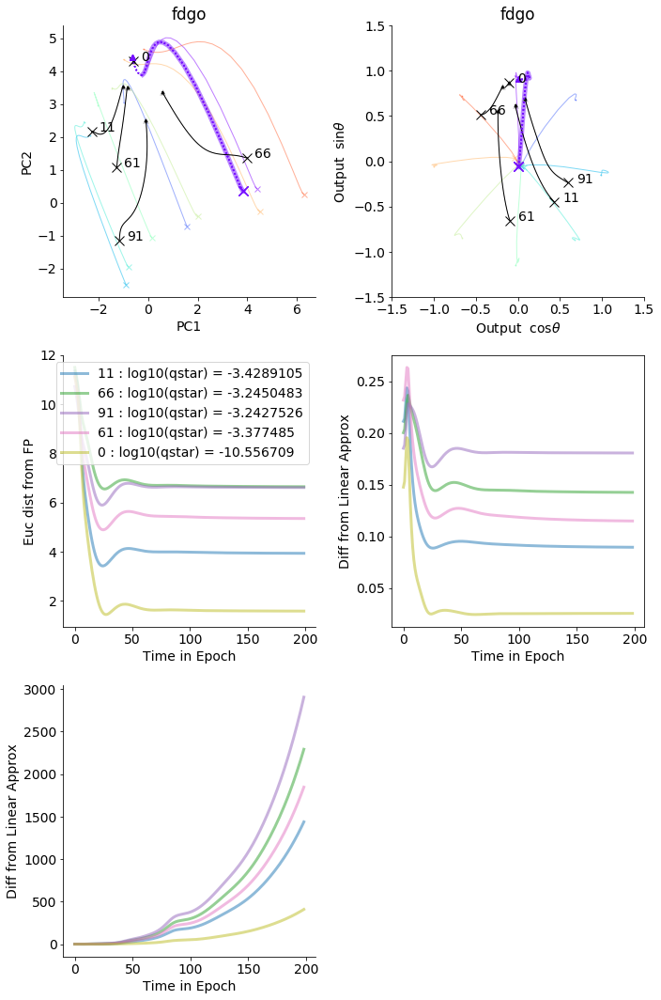

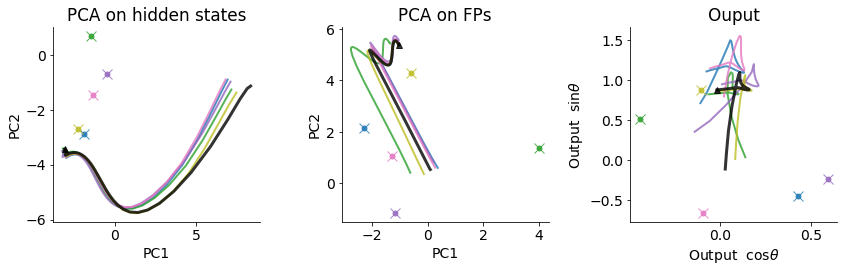

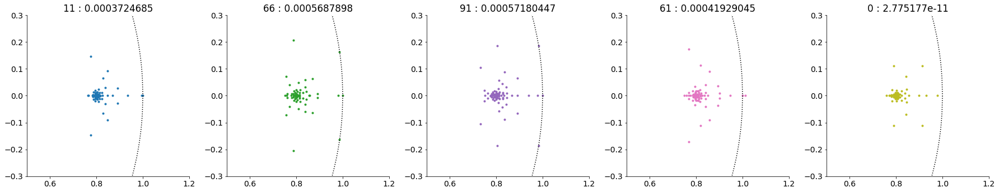

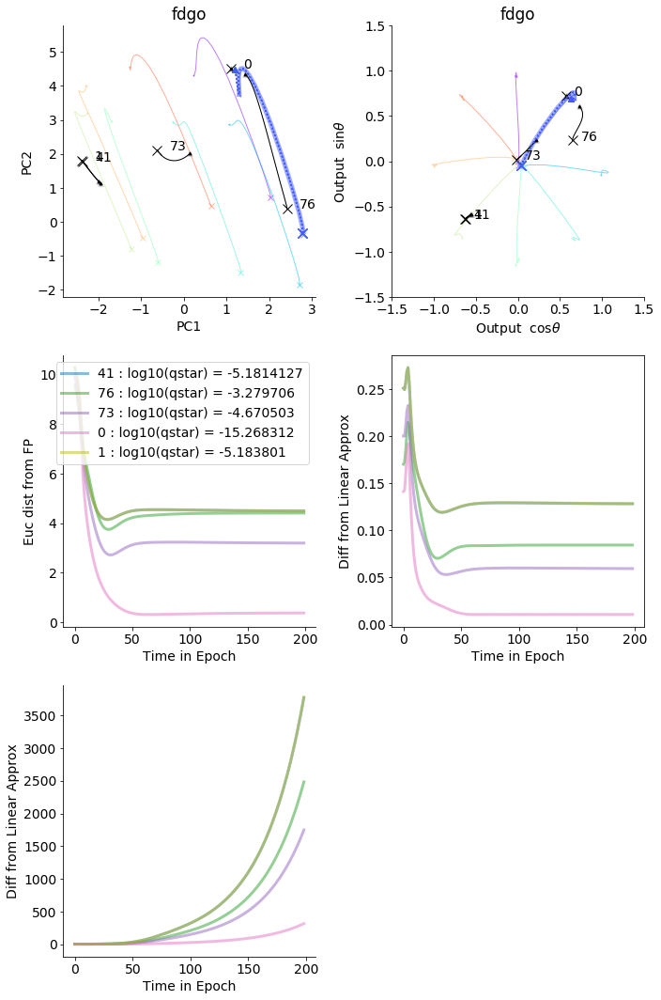

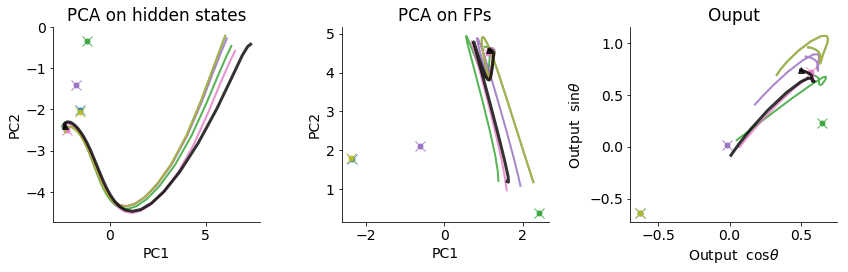

...

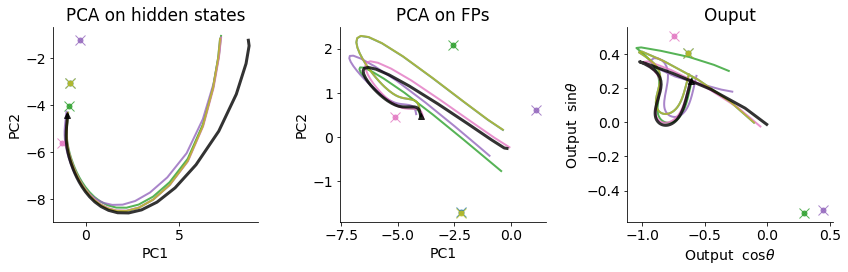

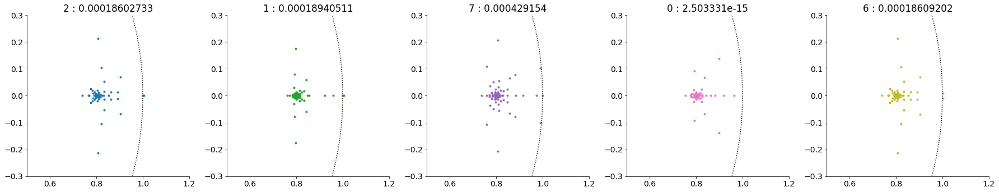

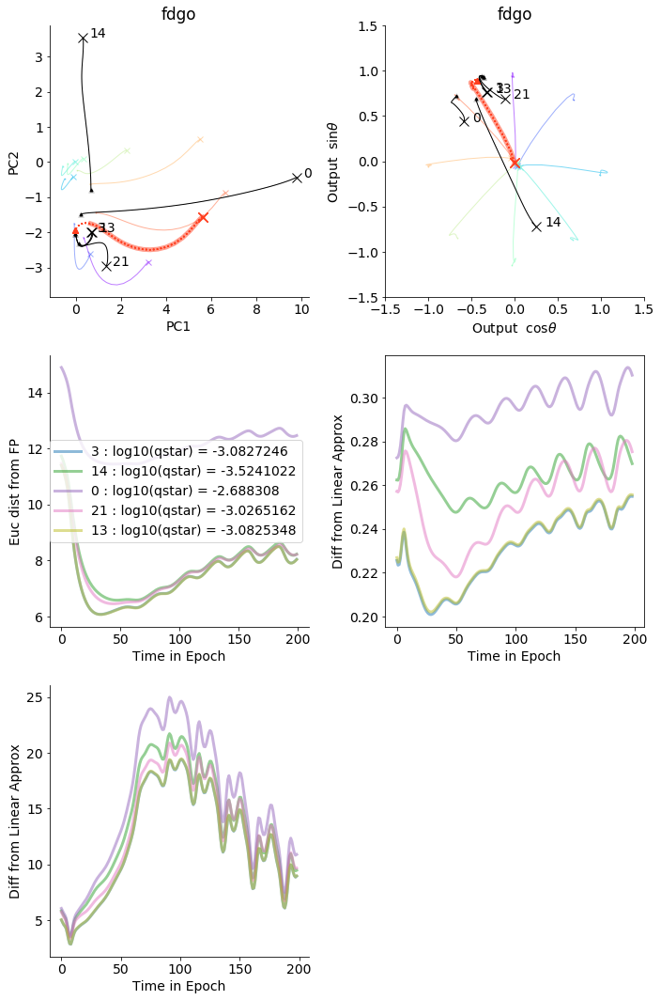

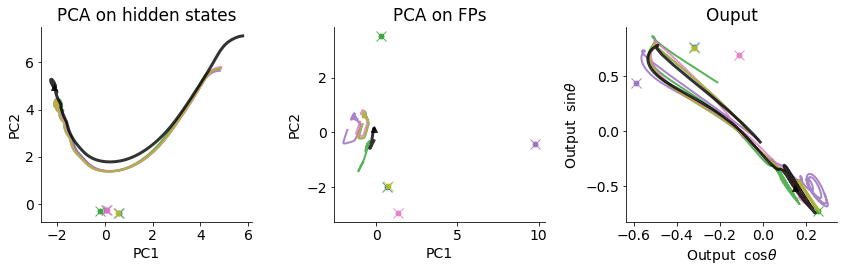

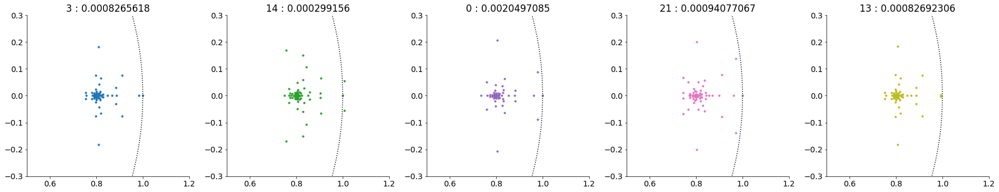

In [191]:
rule = 'fdgo'
fp_epoch = 'go1'

for t_num in range(8,400,40):
    dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m,rule,fp_epoch,t_num)
    plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l_update, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
    plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps)
    plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds)
    
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

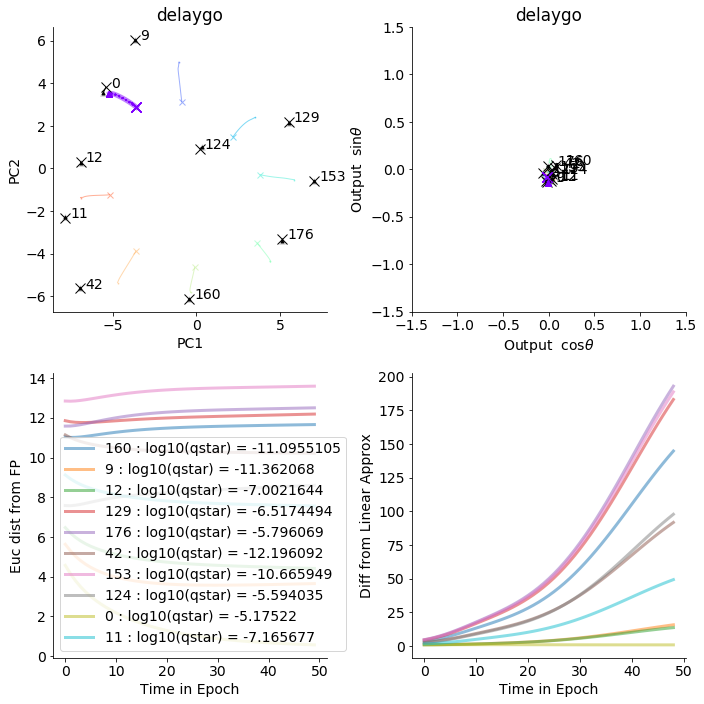

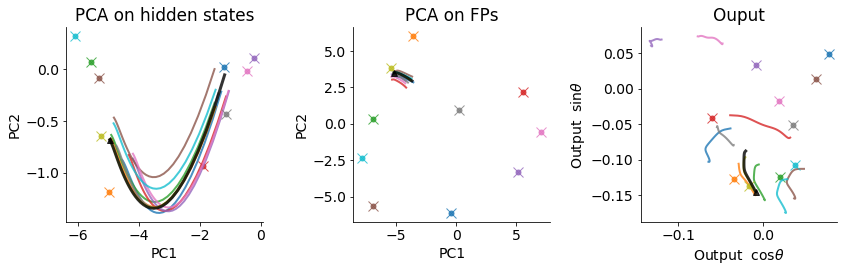

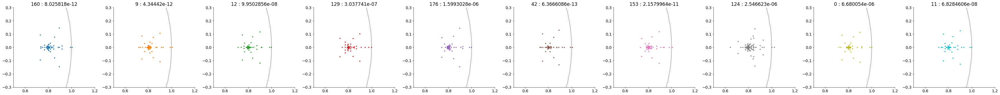

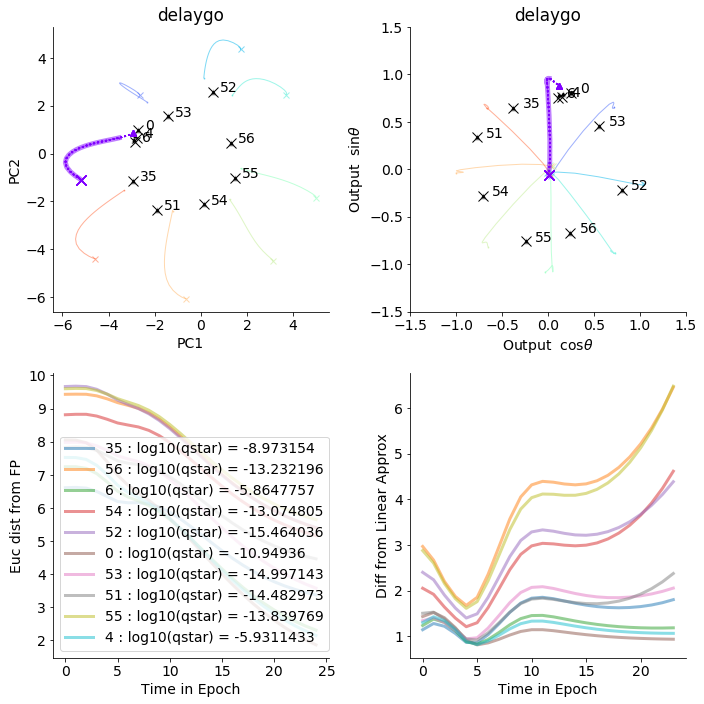

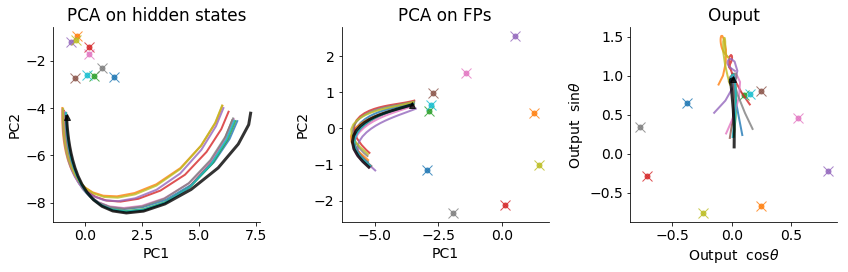

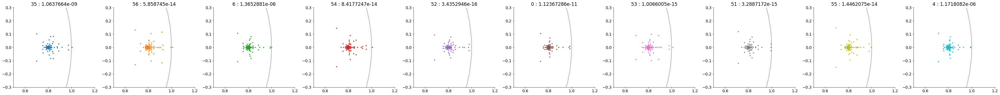

In [24]:
rule = 'delaygo'
t_num = 0

for fp_epoch in ['delay1','go1']:
    dst_FP, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m,rule,fp_epoch,
                                                                                                   t_num,n_fps = 10)
    plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
    plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps)
    plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

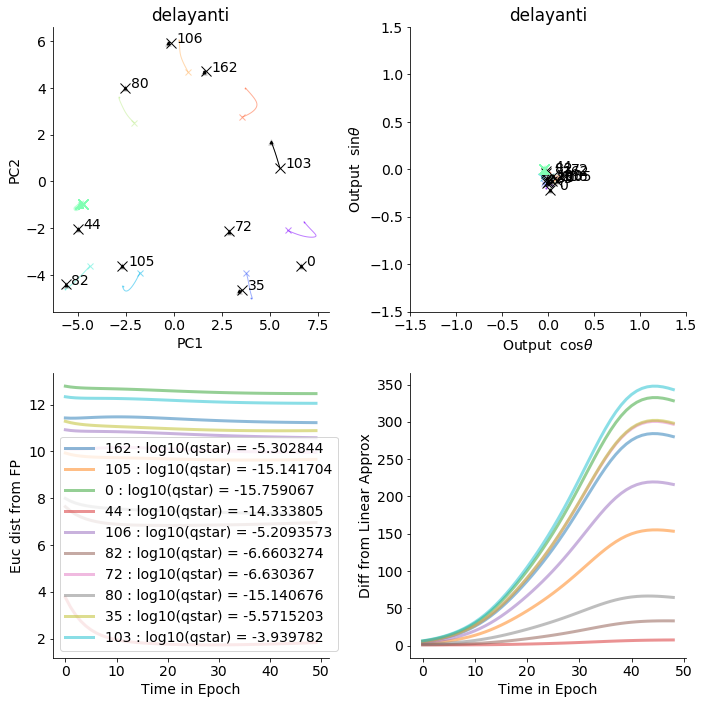

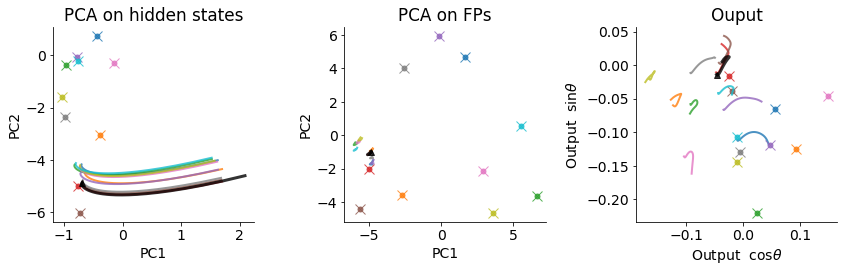

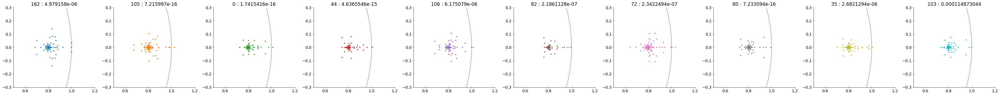

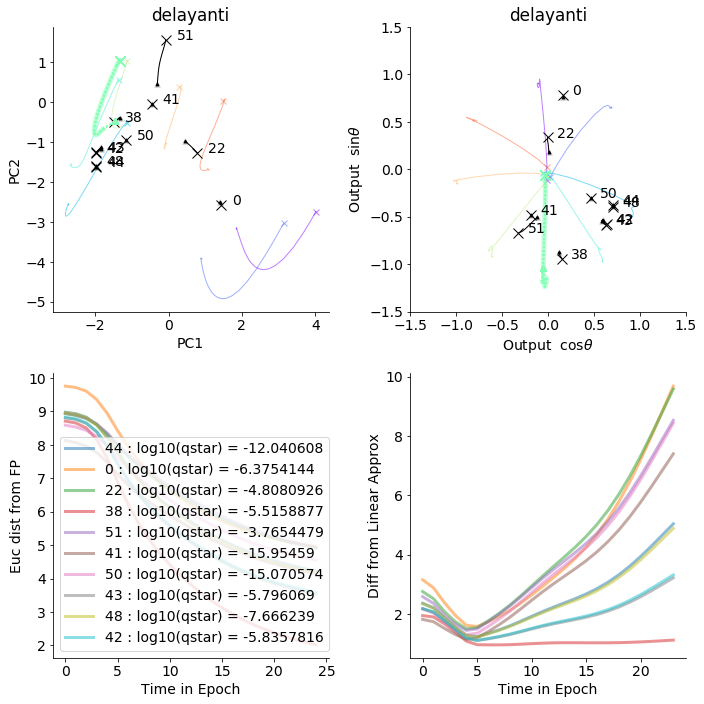

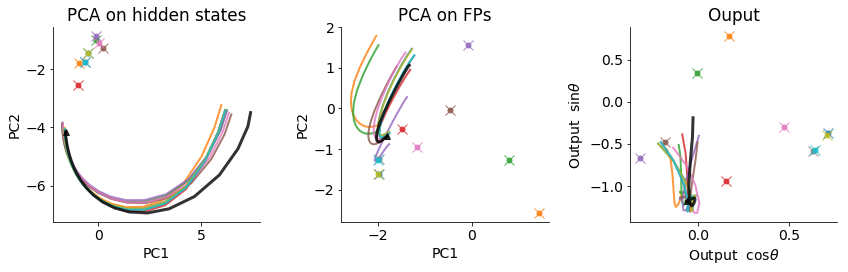

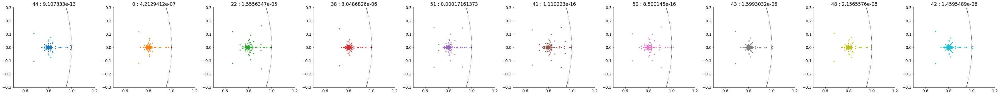

In [25]:
rule = 'delayanti'
fp_epoch = 'delay1'
t_num = 0

for fp_epoch in ['delay1','go1']:
    dst_FP, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m,rule,fp_epoch,
                                                                                                   t_num,n_fps = 10)
    plot_lin_approx(m, rule, t_num, fp_epoch, dst_FP, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
    plot_lin_approx_traj(m,fp_inds,h_nonlin,h_lin,sorted_fps)
    plot_stability_condensed(m,rule,fp_struct,fp_epoch,fp_inds)
    
plt.show()

In [30]:
model_n = 1
dir_specific_all = 'crystals/softplus/l2w0001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
m = model_dir_all

model = Model(model_dir_all)
with tf.Session() as sess:
    model.restore()
    model._sigma=0
    var_list = model.var_list
    params = [sess.run(var) for var in var_list]
    hparams = model.hp
    trial = generate_trials(rule, hparams, mode='test', noise_on=False, batch_size = 128, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
    
    n_input = hparams['n_input']
    n_rnn = hparams['n_rnn']
    n_output = hparams['n_output']
    w_in = params[0]
    b_in = params[1]
    w_out = params[2]
    b_out = params[3]
    sigma_rec = 0#hparams['sigma_rec']
    dt = hparams['dt']
    tau = hparams['tau']
    alpha = dt/tau
    activation = hparams['activation']

model_n = 1
dir_specific_all = 'crystals/softplus/l2w0001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all1 = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
m1 = model_dir_all1

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

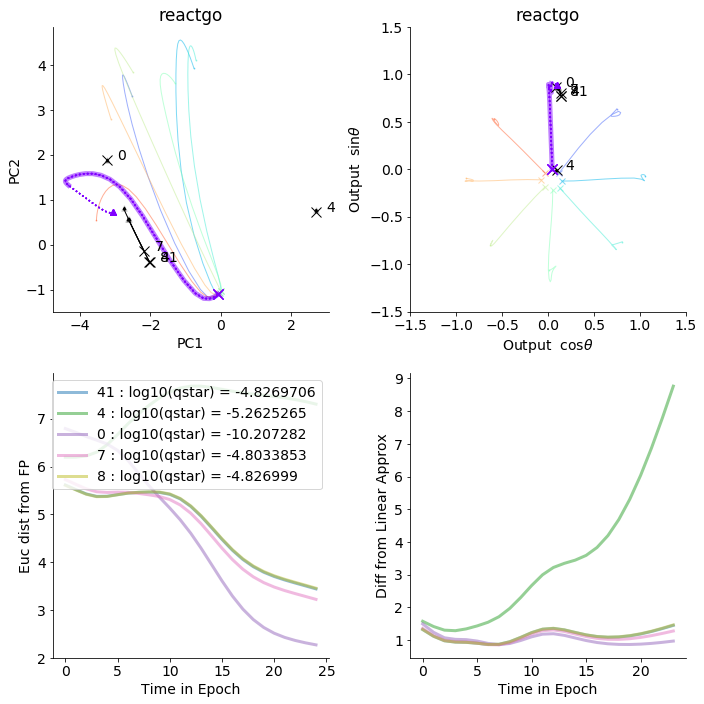

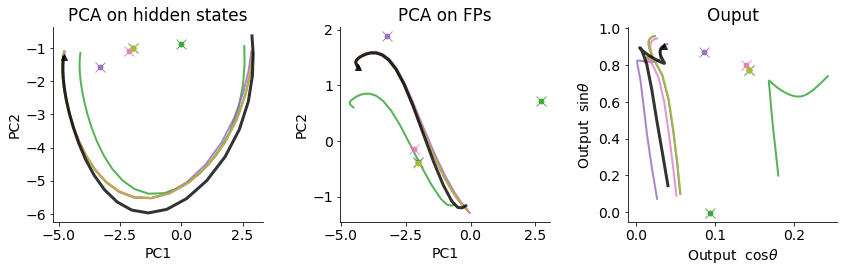

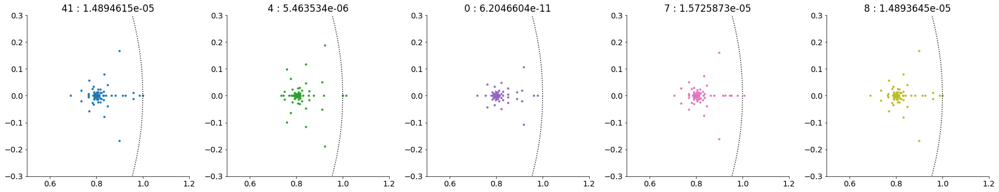

In [31]:
rule = 'reactgo'
fp_epoch = 'go1'

t_num = 0
dst_FP, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m1,rule,fp_epoch,t_num)
plot_lin_approx(m1, rule, t_num, fp_epoch, dst_FP, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
plot_lin_approx_traj(m1,fp_inds,h_nonlin,h_lin,sorted_fps)
plot_stability_condensed(m1,rule,fp_struct,fp_epoch,fp_inds)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

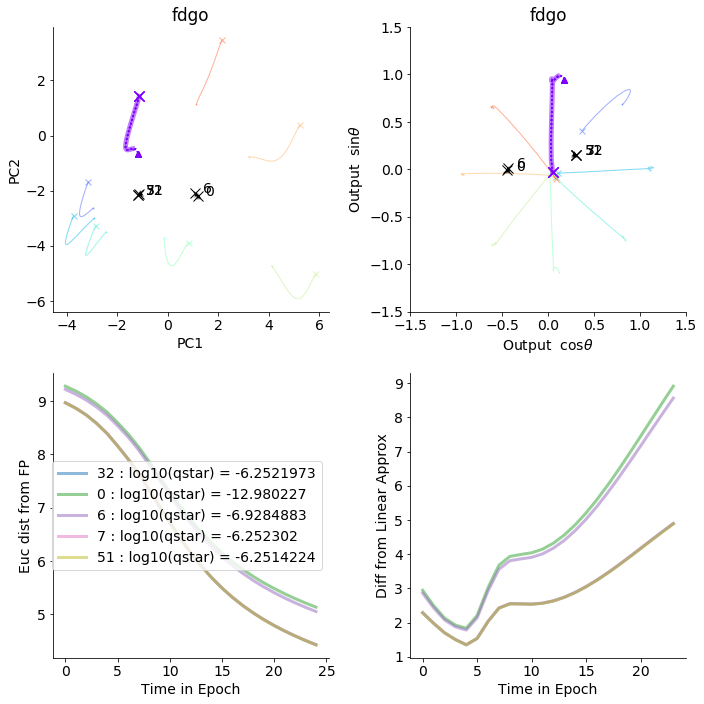

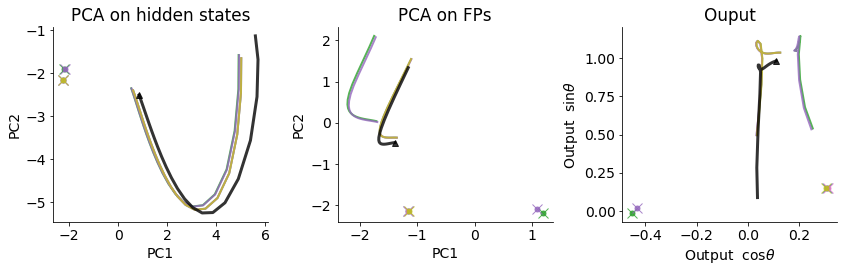

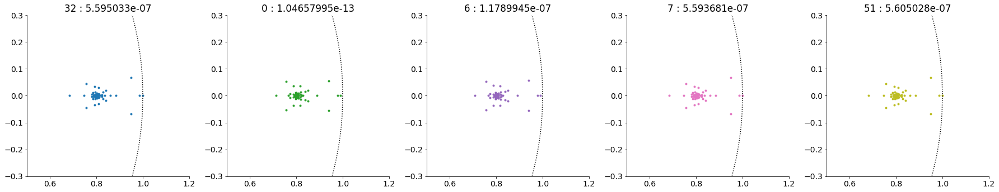

In [32]:
rule = 'fdgo'
fp_epoch = 'go1'

t_num = 0
dst_FP, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m1,rule,fp_epoch,t_num)
plot_lin_approx(m1, rule, t_num, fp_epoch, dst_FP, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
plot_lin_approx_traj(m1,fp_inds,h_nonlin,h_lin,sorted_fps)
plot_stability_condensed(m1,rule,fp_struct,fp_epoch,fp_inds)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

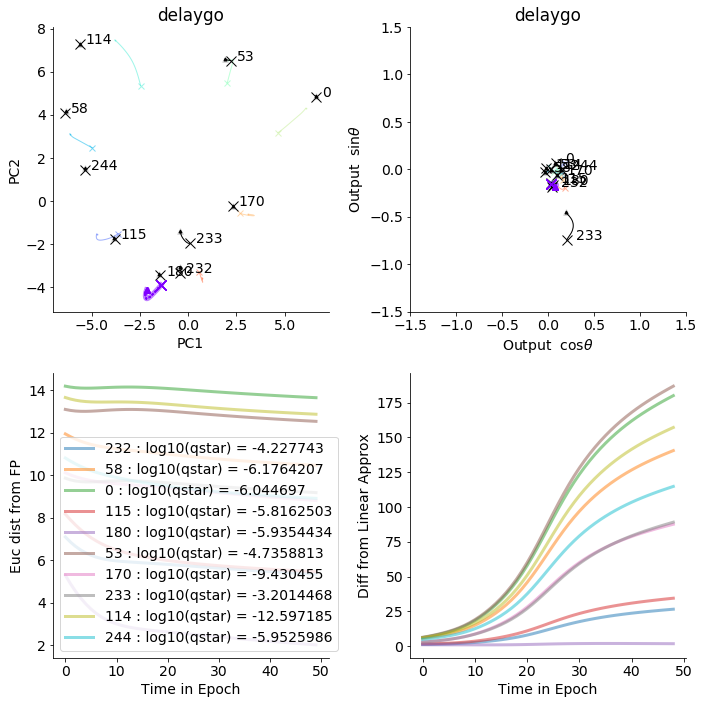

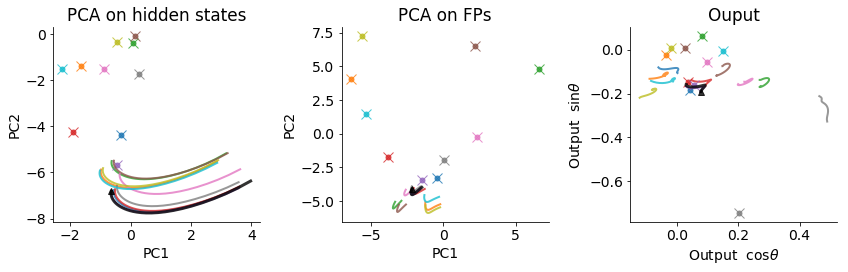

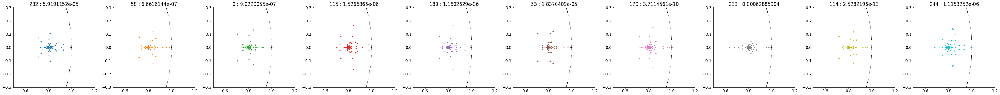

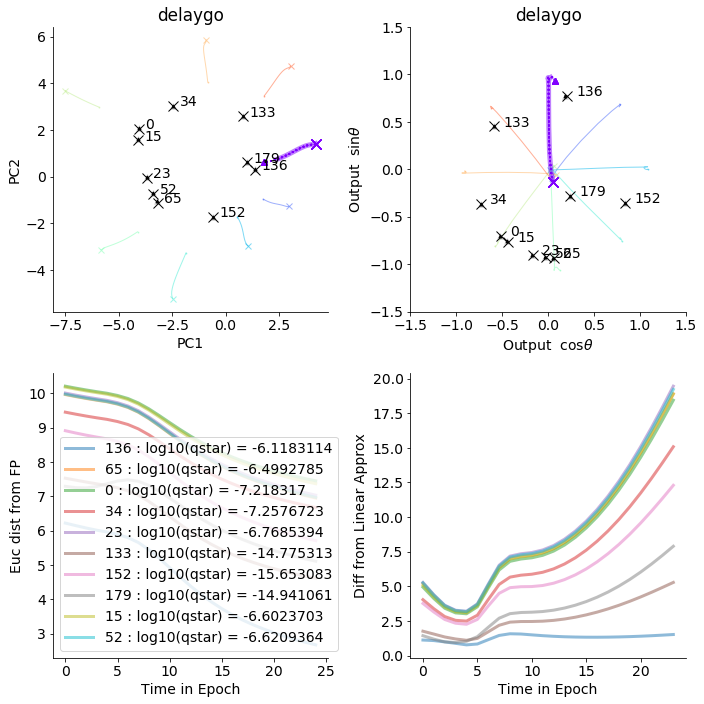

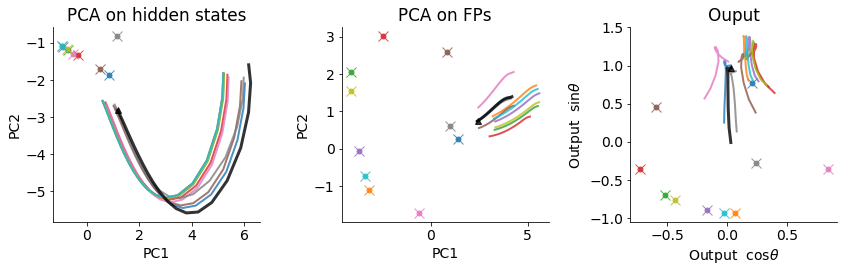

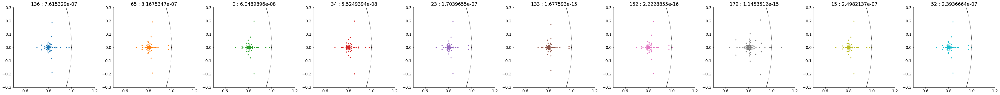

In [33]:
rule = 'delaygo'
fp_epoch = 'delay1'
t_num = 0

for fp_epoch in ['delay1','go1']:
    dst_FP, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m1,rule,fp_epoch,
                                                                                                   t_num,n_fps = 10)
    plot_lin_approx(m1, rule, t_num, fp_epoch, dst_FP, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
    plot_lin_approx_traj(m1,fp_inds,h_nonlin,h_lin,sorted_fps)
    plot_stability_condensed(m1,rule,fp_struct,fp_epoch,fp_inds)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/model.ckpt
Model resto

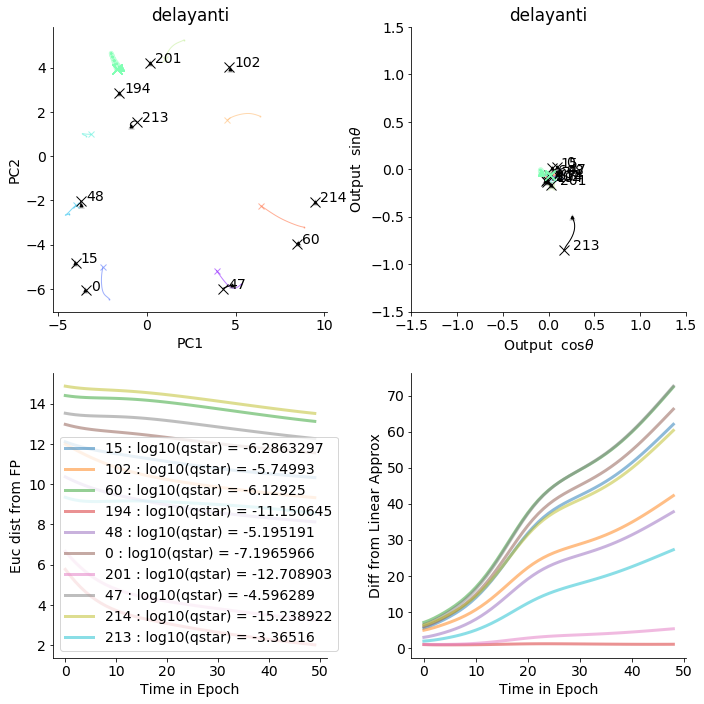

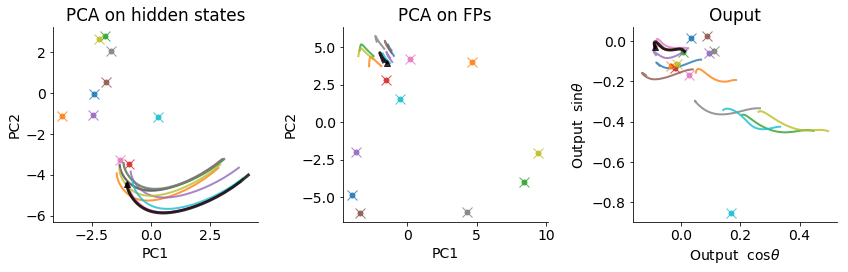

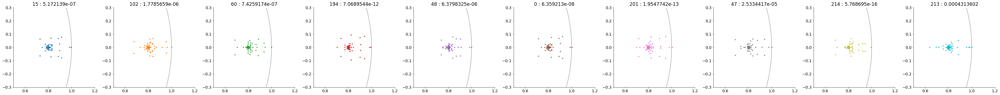

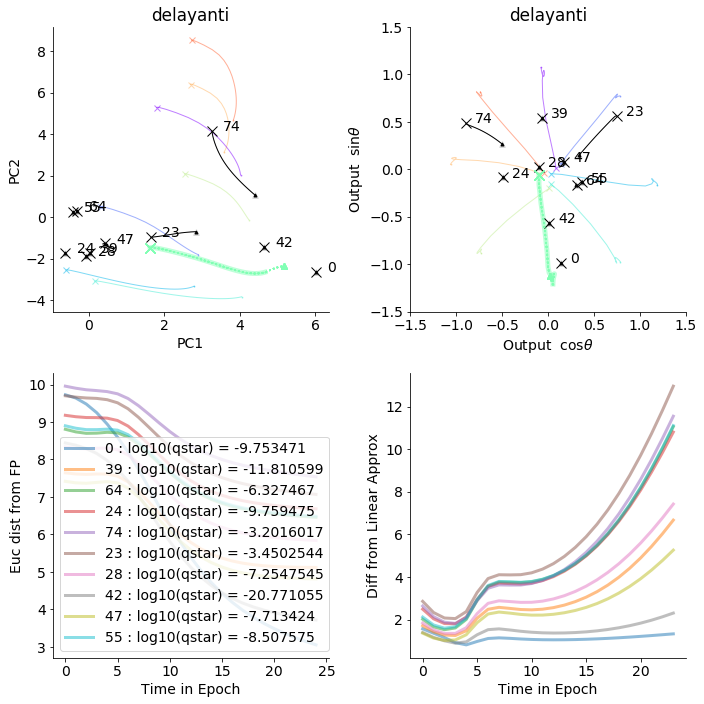

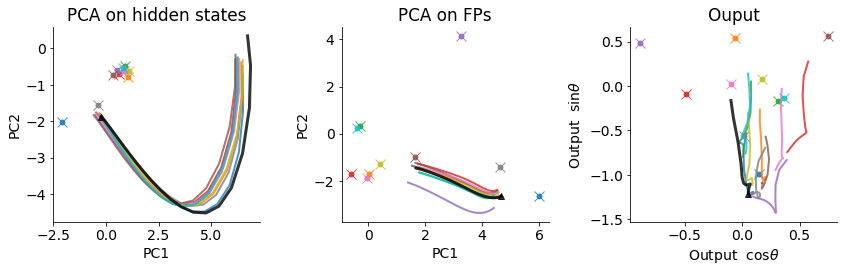

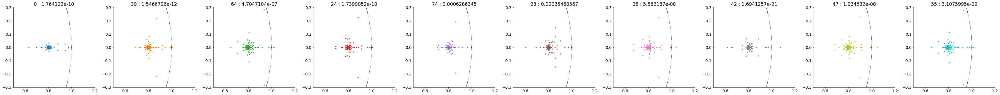

In [34]:
rule = 'delayanti'
fp_epoch = 'delay1'
t_num = 0

for fp_epoch in ['delay1','go1']:
    dst_FP, dst_nl_l, h_nonlin, h_lin, fp_struct, FP_PCs, sorted_fps, fp_inds = eval_lin_approx_FP(m1,rule,fp_epoch,
                                                                                                   t_num,n_fps = 10)
    plot_lin_approx(m1, rule, t_num, fp_epoch, dst_FP, dst_nl_l, h_nonlin, h_lin, FP_PCs, sorted_fps, fp_inds)
    plot_lin_approx_traj(m1,fp_inds,h_nonlin,h_lin,sorted_fps)
    plot_stability_condensed(m1,rule,fp_struct,fp_epoch,fp_inds)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

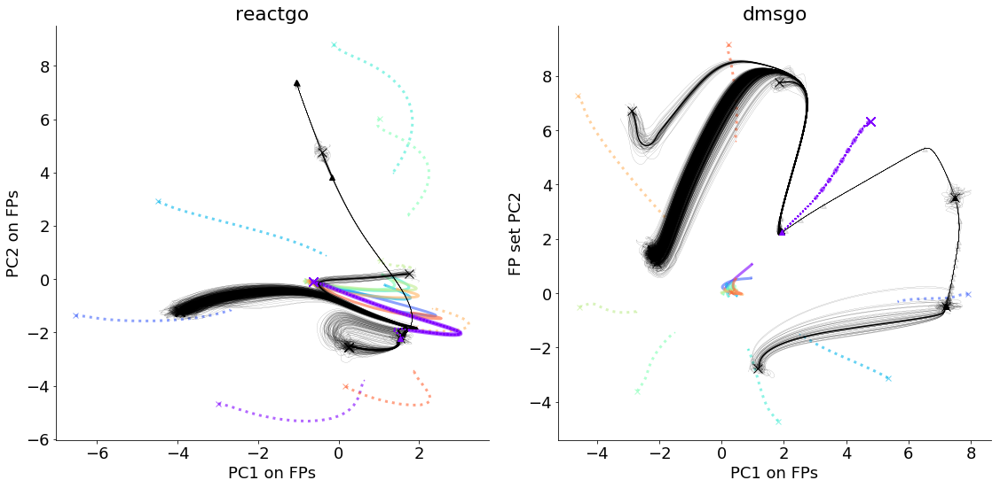

In [120]:
rule_set = ['reactgo','dmsgo']
w_in, b_in, w_out, b_out = get_model_params(m)
D_use = w_out[:,1:]
t_num = 0

fig = plt.figure(figsize=(16,8),tight_layout=True,facecolor='white')

ax1 = plt.subplot(1,2,1)
rule_master = rule_set[0]
D_reactgo, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 20)
plot_N_jitter(m,D_reactgo,rule_set[1],rand_step_coef = 0,n_steps = 100,n_jit = 0,
                   lw = 3,al = .6,linestyle = ':')
plot_FP_jitter(m,D_reactgo,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,[rule_master,],
               rand_step_coef = 0.1,n_steps = 500)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
plt.xlabel('PC1 on FPs')
plt.ylabel('PC2 on FPs')

ax2 = plt.subplot(1,2,2)
rule_master = rule_set[1]
D_dmsgo, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 20)
plot_N_jitter(m,D_dmsgo,rule_set[0],rand_step_coef = 0,n_steps = 100,n_jit = 0,
                   lw = 3,al = .6,linestyle = '-')
plot_FP_jitter(m,D_dmsgo,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,[rule_master,],
               rand_step_coef = 0.1,linestyle = ':',n_steps = 500)


ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
plt.xlabel('PC1 on FPs')

figpath = os.path.join(m,'Output Prep Figure jitter','fp_jitter')
figname = rule_set[0]+'_'+rule_set[1]+'.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

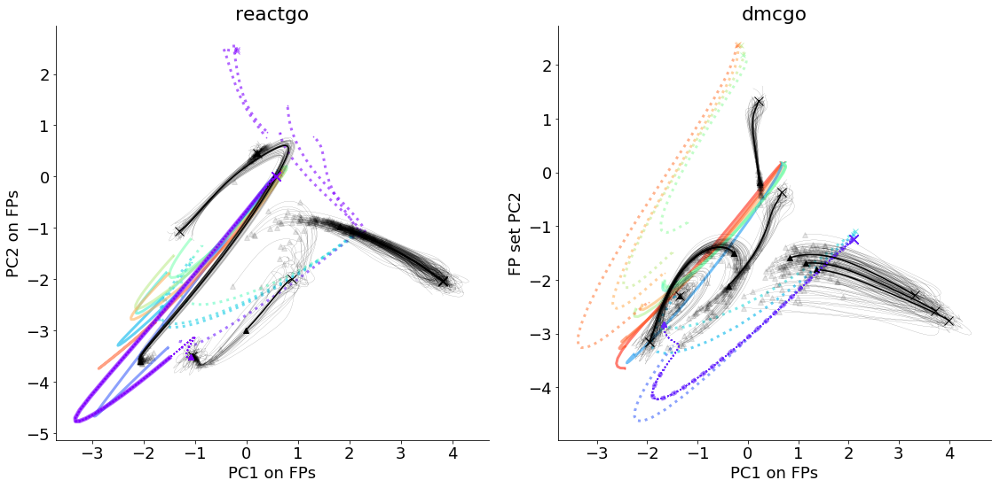

In [133]:
rule_set = ['reactgo','dmcgo']
w_in, b_in, w_out, b_out = get_model_params(m)
D_use = w_out[:,1:]
t_num = 0

fig = plt.figure(figsize=(16,8),tight_layout=True,facecolor='white')

ax1 = plt.subplot(1,2,1)
rule_master = rule_set[0]
D_reactgo, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 8)
plot_N_jitter(m,D_dmsgo,rule_set[1],fp_epoch,rand_step_coef = 0,n_steps = 100,n_jit = 0,
                   lw = 3,al = .6,linestyle = ':',mode = 'random', batch_size =100)
plot_FP_jitter(m,D_dmsgo,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,[rule_master,],
               rand_step_coef = 0.1,n_steps = 70)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
plt.xlabel('PC1 on FPs')
plt.ylabel('PC2 on FPs')

ax2 = plt.subplot(1,2,2)
rule_master = rule_set[1]
D_dmcgo, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 8)
plot_N_jitter(m,D_dmsgo,rule_set[0],fp_epoch,rand_step_coef = 0,n_steps = 100,n_jit = 0,
                   lw = 3,al = .6,linestyle = '-',mode = 'random', batch_size =100)
plot_FP_jitter(m,D_dmsgo,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,[rule_master,],
               rand_step_coef = 0.1,linestyle = ':',n_steps = 70)


ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
plt.xlabel('PC1 on FPs')

figpath = os.path.join(m,'Output Prep Figure jitter','fp_jitter')
figname = rule_set[0]+'_'+rule_set[1]+'.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

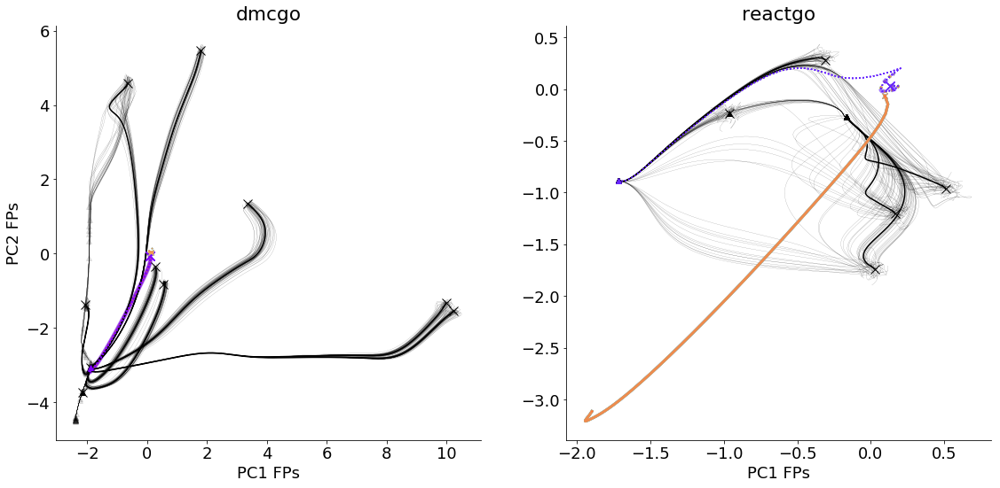

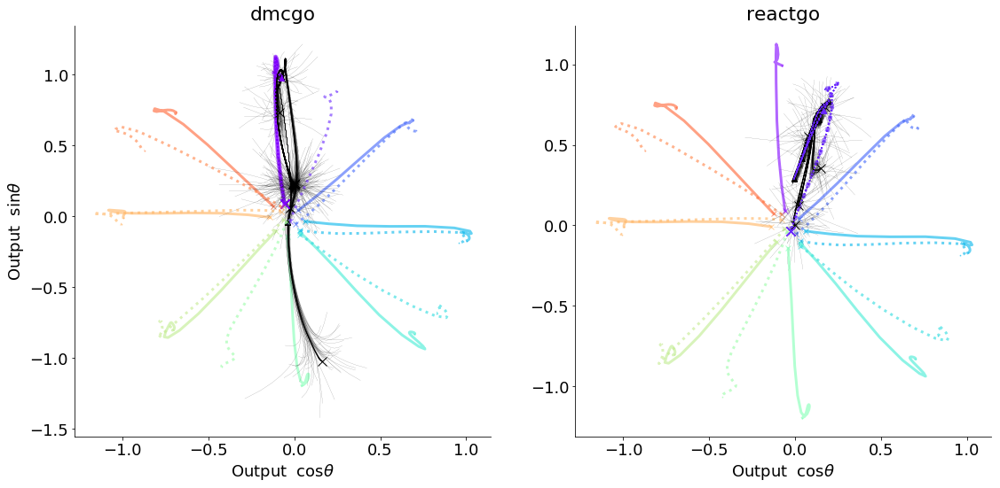

In [135]:
for fp_epoch in ['fix1','go1']:
    rule_set = ['reactgo','dmcgo']
    
    t_num = 0

    fig = plt.figure(figsize=(16,8),tight_layout=True,facecolor='white')

    ax1 = plt.subplot(1,2,1)
    rule_master = rule_set[0]
    D_reactgo, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num,n_fps = 10)
    
    if fp_epoch=='go1':
        w_in, b_in, w_out, b_out = get_model_params(m)
        D_use = w_out[:,1:]
        xlab = 'Output ' + r' $\cos{\theta}$'
        ylab = 'Output ' + r' $\sin{\theta}$'
    else:
        D_use = D_reactgo
        xlab = 'PC1 FPs'
        ylab = 'PC2 FPs'
        
    plot_FP_jitter(model_dir_all,D_use,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,[rule_master,],
                   rand_step_coef = 0.05,n_steps = 100)
    plot_N_jitter(m,D_use,rule_set[1],fp_epoch,rand_step_coef = 0,n_steps = 100,n_jit = 0,
                       lw = 3,al = .6,linestyle = ':')

    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    plt.xlabel(xlab)
    plt.ylabel(ylab)

    ax2 = plt.subplot(1,2,2)
    rule_master = rule_set[1]
    _, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num,n_fps = 5)
    plot_FP_jitter(model_dir_all,D_use,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,[rule_master,],
                   rand_step_coef = 0.05,linestyle = ':',n_steps = 100)
    plot_N_jitter(m,D_use,rule_set[0],fp_epoch,rand_step_coef = 0,n_steps = 100,n_jit = 0,
                       lw = 3,al = .6,linestyle = '-')

    ax2.spines['right'].set_visible(False)
    ax2.spines['top'].set_visible(False)
    plt.xlabel(xlab)
    plt.ylabel(' ')

    figpath = os.path.join(model_dir_all,'Output Prep Figure jitter','fp_jitter')
    figname = rule_set[0]+'_'+rule_set[1]+'_'+fp_epoch+'.pdf'
    if not os.path.exists(figpath):
        os.makedirs(figpath)
    plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/sklearn/linear_model/base.py:485: RuntimeWarning: internal gelsd driver lwork query error, required iwork dimension not returned. This is likely the result of LAPACK bug 0038, fixed in LAPACK 3.2.2 (released July 21, 2010). Falling back to 'gelss' driver.
  linalg.lstsq(X, y)


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt


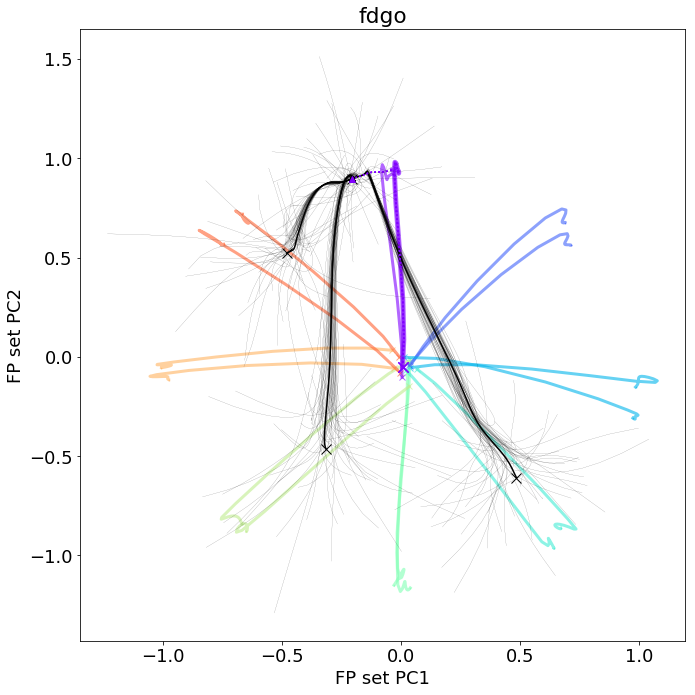

In [46]:
rule_set = ['fdgo','fdanti']
rule_master = rule_set[0]

w_in, b_in, w_out, b_out = get_model_params(m)
t_num = 0
D_reactgo, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num)
D_stim = make_axes(model_dir_all,rule_master,fp_epoch)
filename = os.path.join(model_dir_all,'golub_fixed_pts',rule_master,fp_epoch+'_'+str(t_num)+'.npz')
# fp_struct = np.load(filename)
# fp_inds = [np.argsort(fp_struct['qstar'])[0],]
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
plot_FP_jitter(model_dir_all,w_out[:,1:],rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,rand_step_coef = 0.1)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

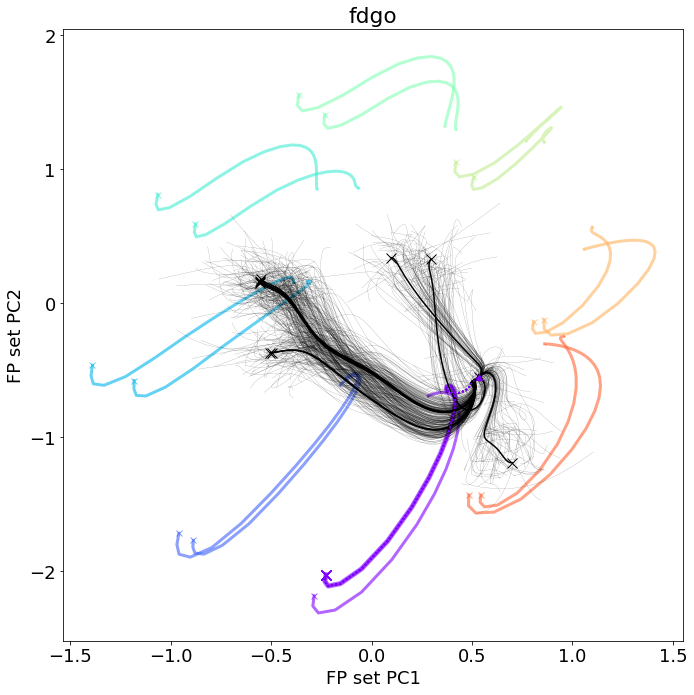

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt


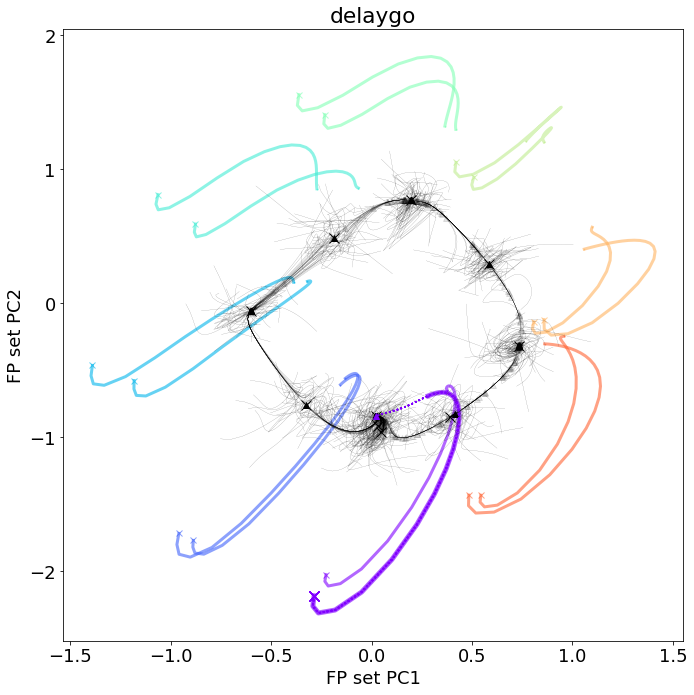

In [68]:
rule_set = ['fdgo','delaygo']
rule_master = rule_set[0]

w_in, b_in, w_out, b_out = get_model_params(m)
t_num = 0
D_reactgo, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num,n_fps = 10)
D_stim = make_axes(model_dir_all,rule_master,fp_epoch)
filename = os.path.join(model_dir_all,'golub_fixed_pts',rule_master,fp_epoch+'_'+str(t_num)+'.npz')
# fp_struct = np.load(filename)
# fp_inds = [np.argsort(fp_struct['qstar'])[0],]
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
plot_FP_jitter(model_dir_all,D_stim,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,rand_step_coef = 0.15,n_steps = 500)
plt.show()

rule_set = ['fdgo','delaygo']
rule_master = rule_set[1]

_, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num,n_fps = 10)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
plot_FP_jitter(model_dir_all,D_stim,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,rand_step_coef = 0.15,n_steps = 500)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

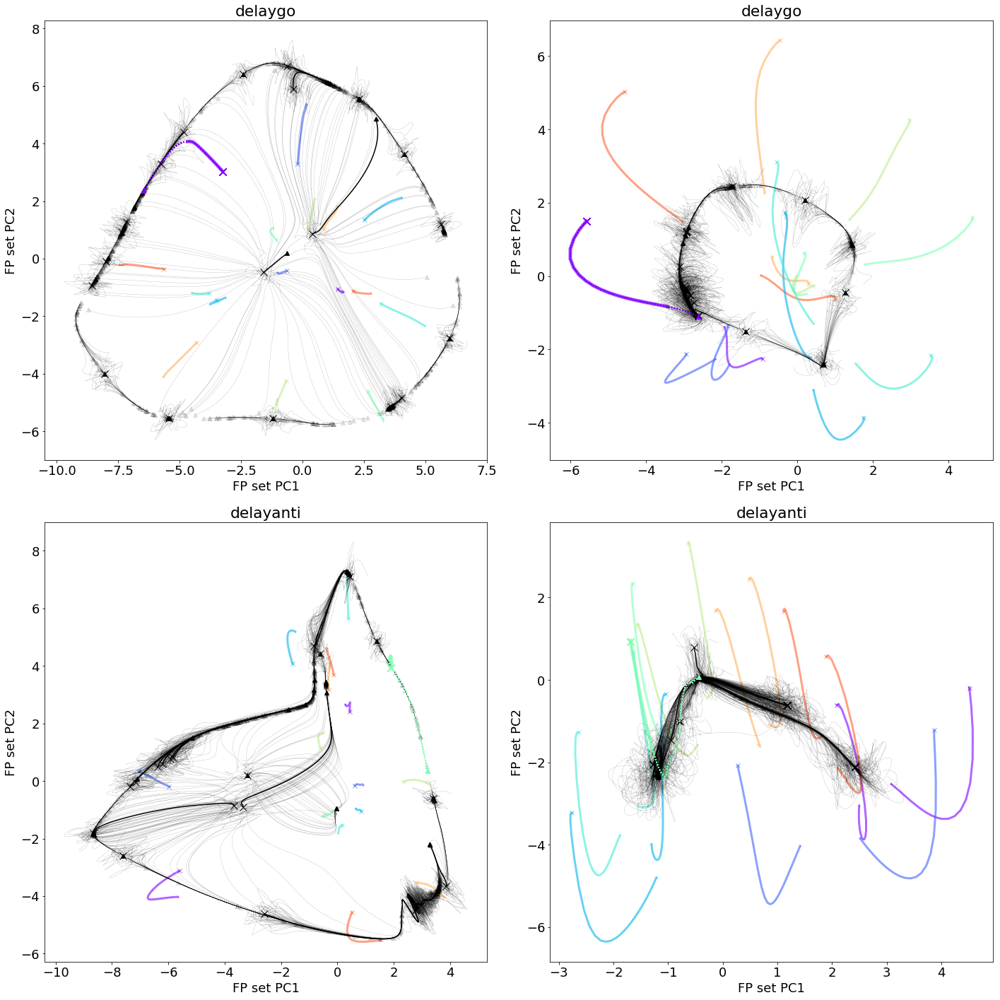

In [52]:
rule_set = ['delaygo','delayanti']
epoch_set = ['delay1','go1']
w_in, b_in, w_out, b_out = get_model_params(m)
t_num = 0

fig = plt.figure(figsize=(20,20),tight_layout=True,facecolor='white')

for fpi in range(len(epoch_set)):
    
    fp_epoch = epoch_set[fpi]

    rule_master = rule_set[0]
    D_A, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num,n_fps = 20)
    plt.subplot(2,2,fpi+1)
    plot_FP_jitter(model_dir_all,D_A,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,
                   rand_step_coef = 0.2,n_steps = 500)
    
    rule_master = rule_set[1]
    D_B, sorted_fps, fp_inds = make_FP_pcs(model_dir_all,rule_master,fp_epoch,t_num,n_fps = 20)
    plt.subplot(2,2,fpi+3)
    plot_FP_jitter(model_dir_all,D_B,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,
                   rand_step_coef = 0.2,n_steps = 500)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/m

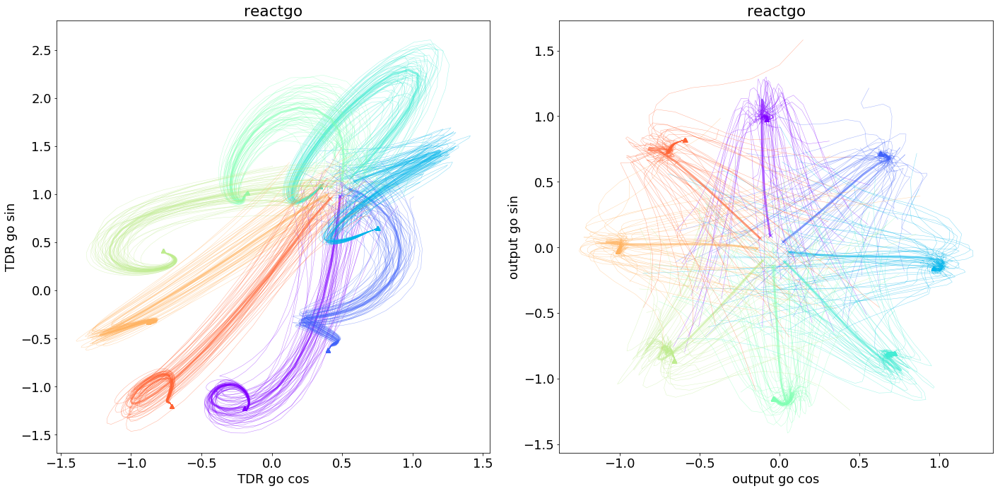

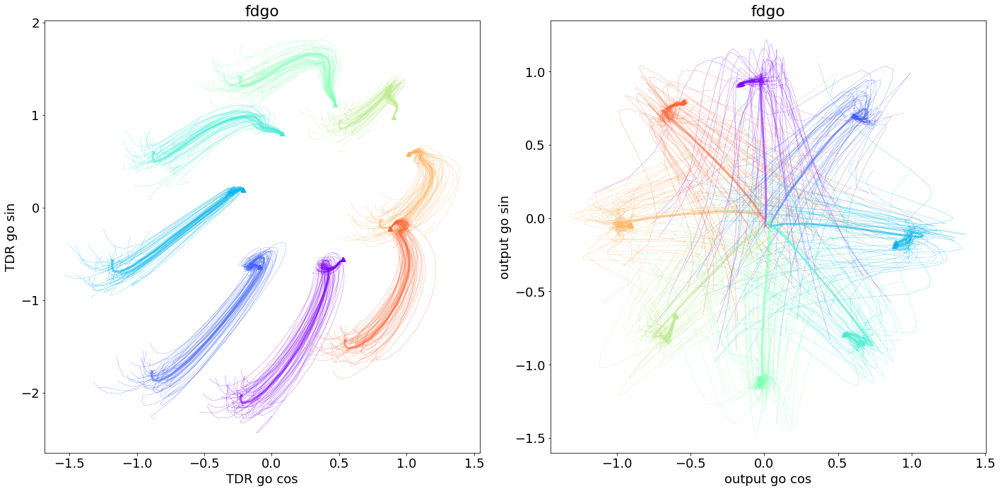

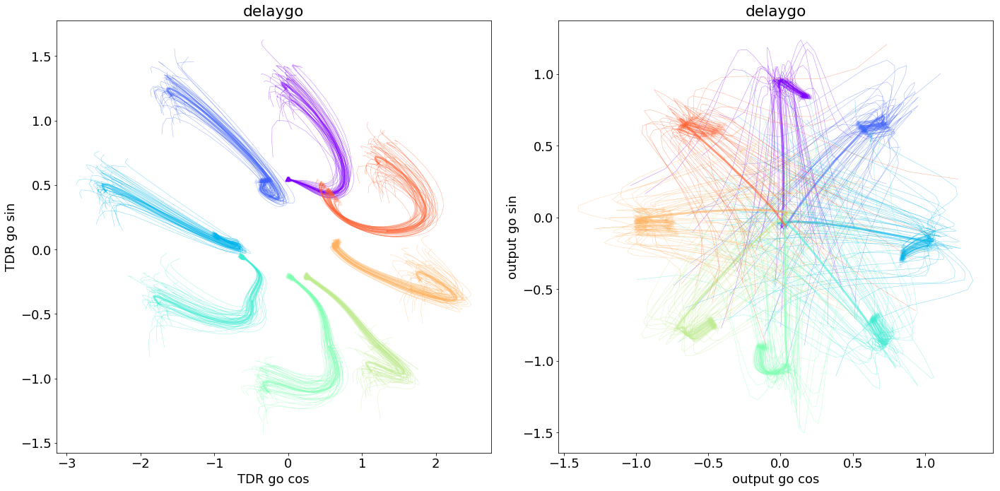

In [71]:
fig_size_fac = 10
rule_set = ['reactgo','fdgo','delaygo']
# fig = plt.figure(figsize=(fig_size_fac*len(rule_set),fig_size_fac),tight_layout=True,facecolor='white')

for ri in range(len(rule_set)):
    fig = plt.figure(figsize=(2*fig_size_fac,fig_size_fac),tight_layout=True,facecolor='white')
    
    rule = rule_set[ri]
    D_epoch = make_axes(model_dir_all,rule,fp_epoch)
    
    plt.subplot(1,2,1)
    plot_N_jitter(m,D_epoch,rule,rand_step_coef = 0.15,n_steps = 130,n_jit = 50)
    plt.xlabel('TDR go cos')
    plt.ylabel('TDR go sin')
    
    plt.subplot(1,2,2)
    plot_N_jitter(m,w_out[:,1:],rule,rand_step_coef = 0.15,n_steps = 70,n_jit = 50)
    plt.xlabel('output go cos')
    plt.ylabel('output go sin')
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/model.ckpt
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/

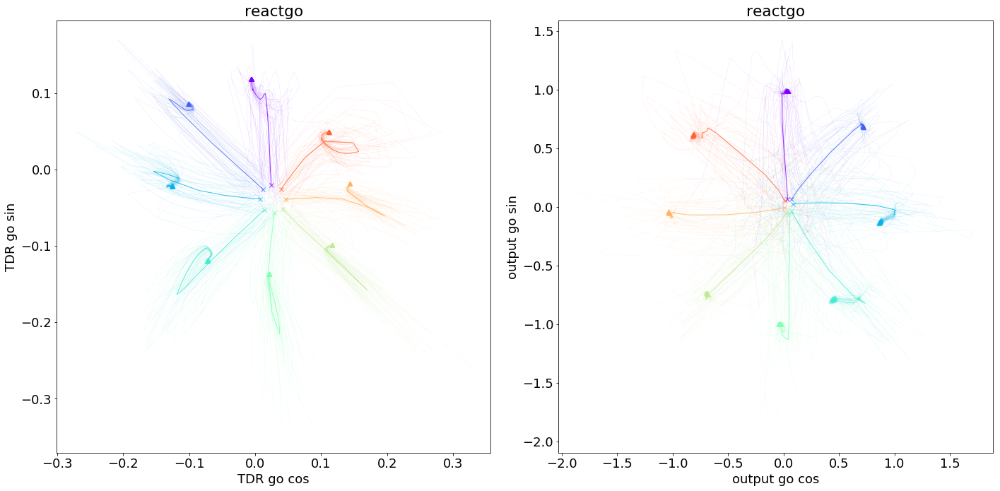

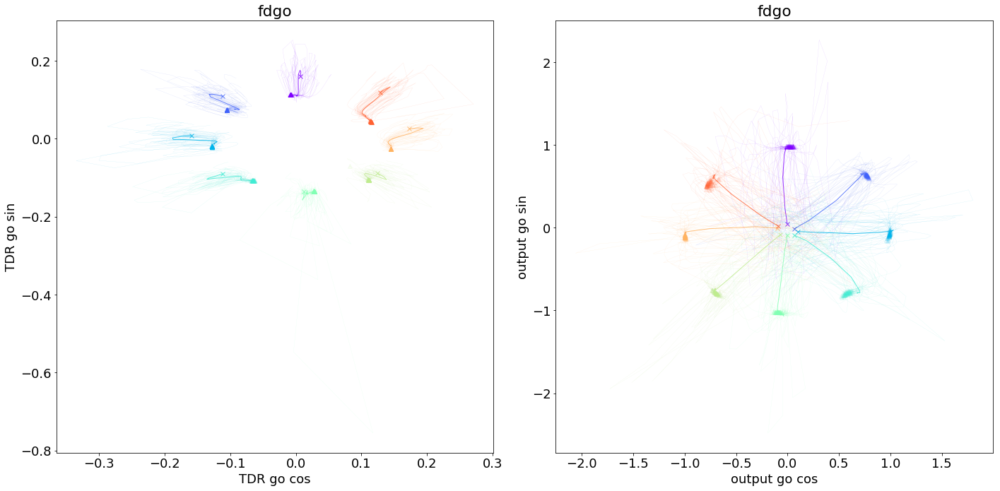

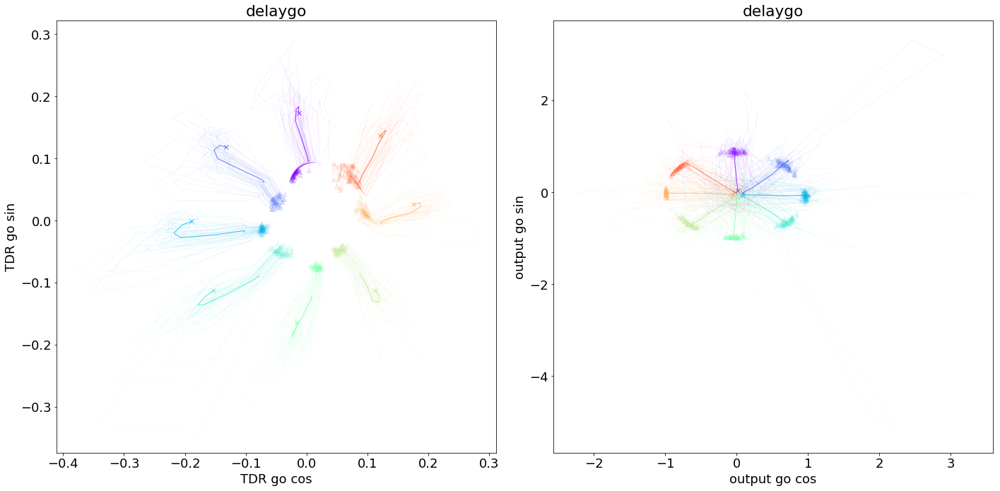

In [139]:
fig_size_fac = 10
rule_set = ['reactgo','fdgo','delaygo']
# fig = plt.figure(figsize=(fig_size_fac*len(rule_set),fig_size_fac),tight_layout=True,facecolor='white')

for ri in range(len(rule_set)):
    fig = plt.figure(figsize=(2*fig_size_fac,fig_size_fac),tight_layout=True,facecolor='white')
    
    rule = rule_set[ri]
    D_epoch = make_axes(model_dir_all,rule,fp_epoch)
    
    plt.subplot(1,2,1)
    plot_N_jitter(m,D_epoch,rule,t_num,rand_step_coef = 0.015,n_steps = 130,n_jit = 50)
    plt.xlabel('TDR go cos')
    plt.ylabel('TDR go sin')
    
    plt.subplot(1,2,2)
    plot_N_jitter(m,w_out[:,1:],rule,t_num,rand_step_coef = 0.015,n_steps = 70,n_jit = 50)
    plt.xlabel('output go cos')
    plt.ylabel('output go sin')
    
plt.show()

In [ ]:
fig_size_fac = 10
rule_set = ['reactgo','fdgo','delaygo']
# fig = plt.figure(figsize=(fig_size_fac*len(rule_set),fig_size_fac),tight_layout=True,facecolor='white')

for ri in range(len(rule_set)):
    fig = plt.figure(figsize=(fig_size_fac,fig_size_fac),tight_layout=True,facecolor='white')
    rule = rule_set[ri]
    D_epoch = make_axes(model_dir_all,rule,fp_epoch)
    plot_N_jitter(m,D_use,rule,t_num,rand_step_coef = 0.01,n_steps = 500,n_jit = 50)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/model.ckpt
either
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/soft

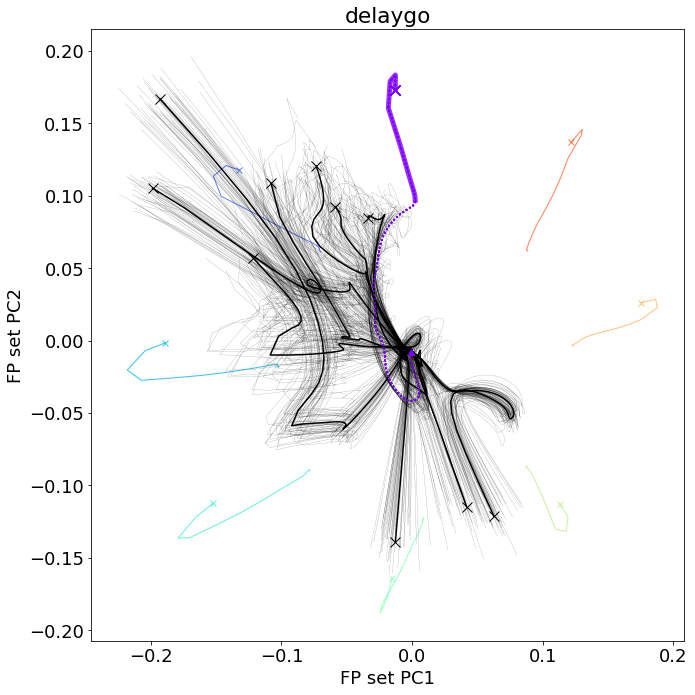

In [117]:
rule_set = ['delaygo',]
rule_master = 'delaygo'
# D_stim = make_axes(model_dir_all,rule_master,fp_epoch)

t_num = 0
D_delaygo, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 10)

D_epoch = make_axes(model_dir_all,rule_master,fp_epoch)

fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
plot_FP_jitter(m,D_epoch,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,rand_step_coef = 0.01)
# plt.xlim([-.2,.2])
# plt.ylim([-.2,.2])
plt.show()

In [ ]:
rule_set = ['delaygo',]
rule_master = 'delaygo'
# D_stim = make_axes(model_dir_all,rule_master,fp_epoch)

t_num = 0
D_delaygo, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num,n_fps = 10)

D_epoch = make_axes(model_dir_all,rule_master,fp_epoch)

fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
plot_FP_jitter(m,D_epoch,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set,rand_step_coef = 0.01)
# plt.xlim([-.2,.2])
# plt.ylim([-.2,.2])
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt


/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

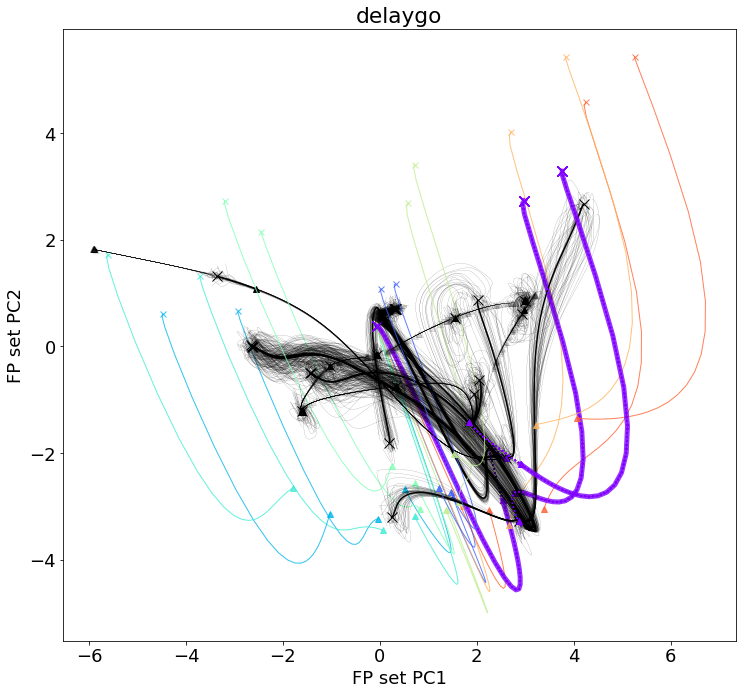

In [207]:
rule_set = ['fdgo',]
rule_master = 'fdgo'
t_num = 0
D_use, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num)

rule_set_all = ['reactgo','fdgo','delaygo']

fig = plt.figure(figsize=(10*len(rule_set_all),10),tight_layout=True,facecolor='white')
for rule_master in rule_set_all:
    rule_set = [rule_master,]

    _, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num)
    
    ax = plt.subplot(1,len(rule_set_all),1)
    plot_FP_jitter(m,D_use,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

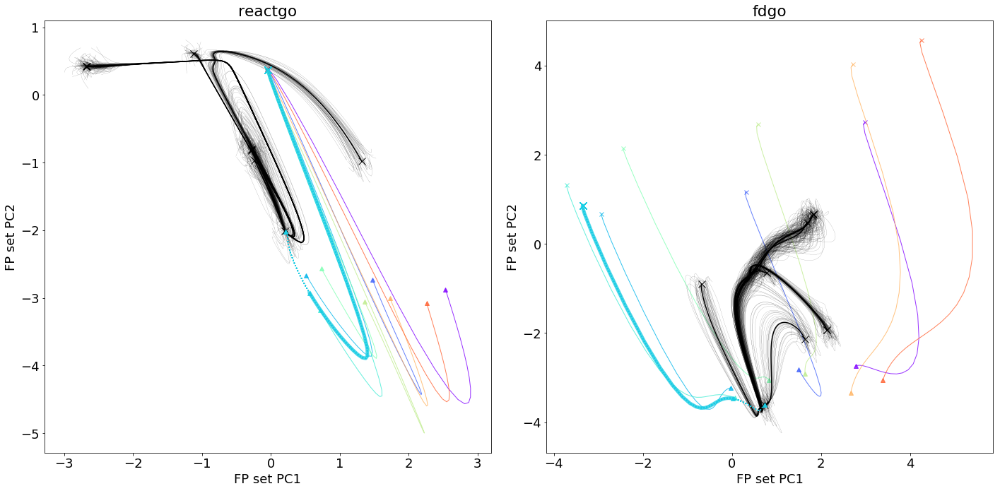

In [213]:
rule_set = ['fdgo',]
rule_master = 'fdgo'
t_num = 120
D_use, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,0)

rule_set_all = ['reactgo','fdgo',]

fig = plt.figure(figsize=(10*len(rule_set_all),10),tight_layout=True,facecolor='white')

for ri in range(len(rule_set_all)):
    rule_master = rule_set_all[ri]
    rule_set = [rule_master,]

    _, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num)
    
    ax = plt.subplot(1,len(rule_set_all),ri+1)
    plot_FP_jitter(m,D_use,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model resto

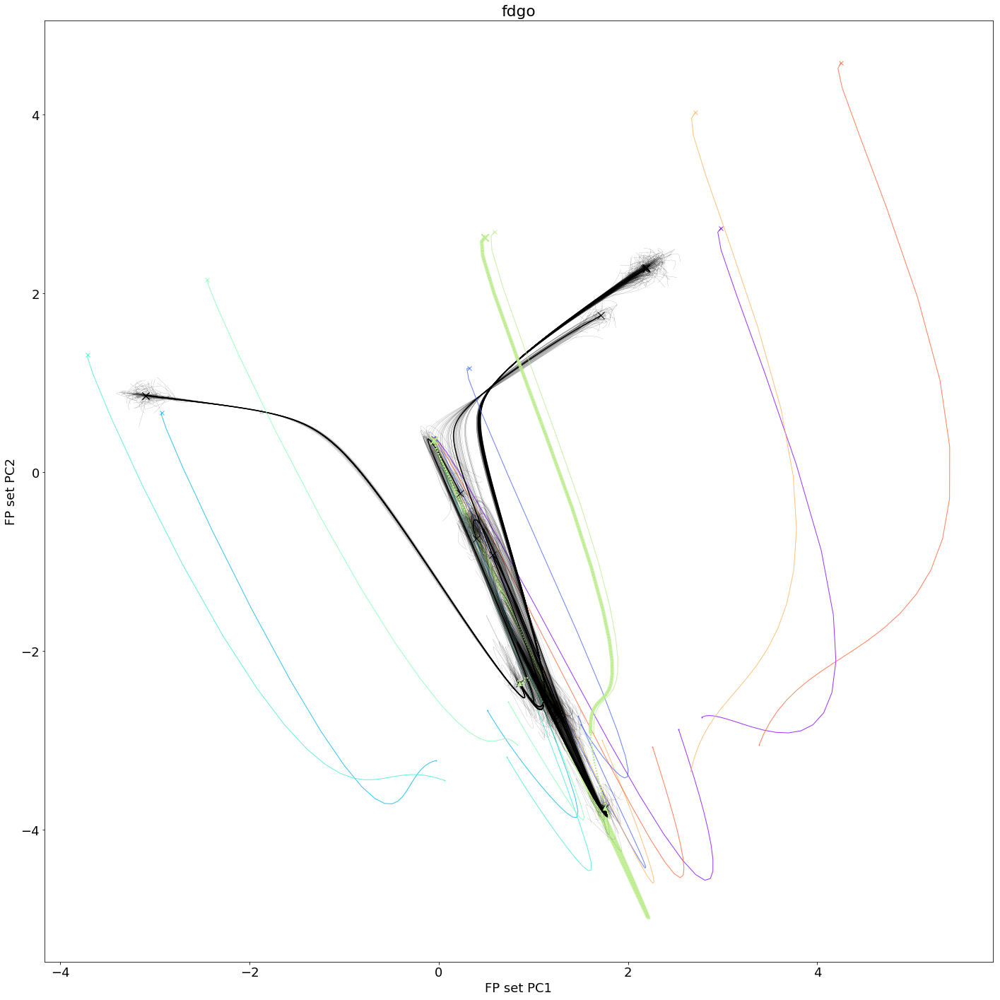

In [61]:
t_num = 248
D_use = D_fdgo
rule_set_all = ['reactgo','fdgo',]

fig = plt.figure(figsize=(20,20),tight_layout=True,facecolor='white')

for ri in range(len(rule_set_all)):
    rule_master = rule_set_all[ri]
    rule_set = [rule_master,]

    _, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num)
    
#     ax = plt.subplot(1,len(rule_set_all),ri+1)
    plot_FP_jitter(m,D_use,rule_master,t_num,fp_epoch,sorted_fps,fp_inds,rule_set)
    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt


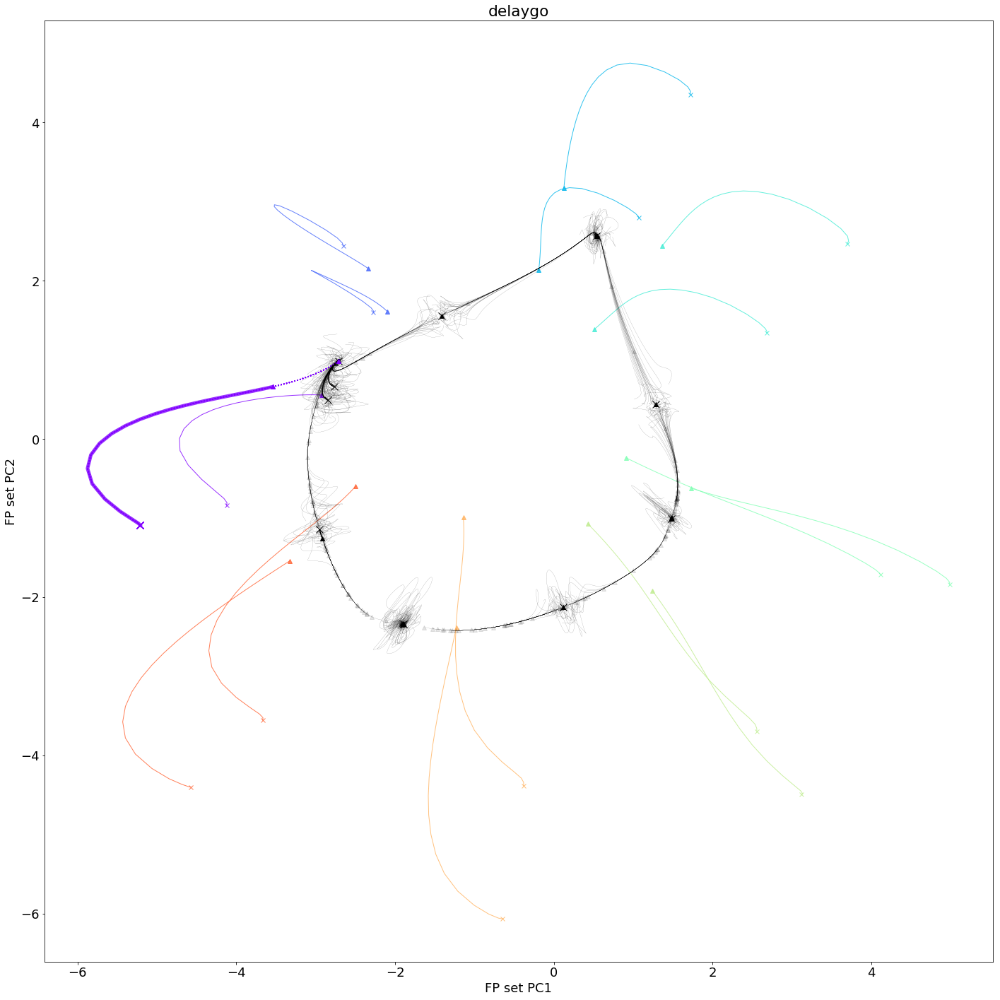

In [187]:
rule_set = ['fdgo','delaygo']
rule_master = rule_set[1]

D_pca, sorted_fps, fp_inds = make_FP_pcs(m,rule_master,fp_epoch,t_num)

fig = plt.figure(figsize=(20,20),tight_layout=True,facecolor='white')
plot_FP_jitter(m,D_pca,rule_master,t_num,fp_epoch,rule_set)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


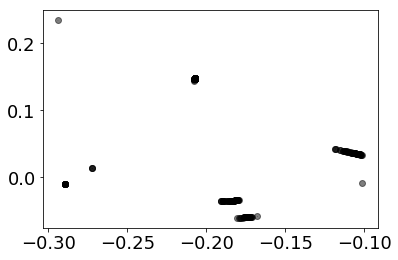

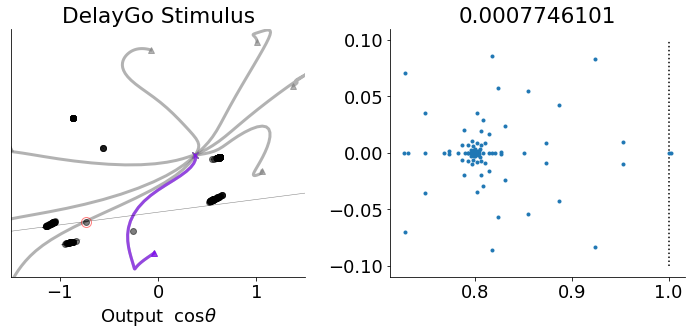

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


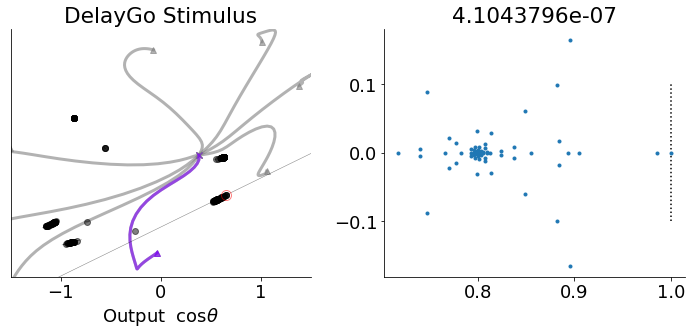

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


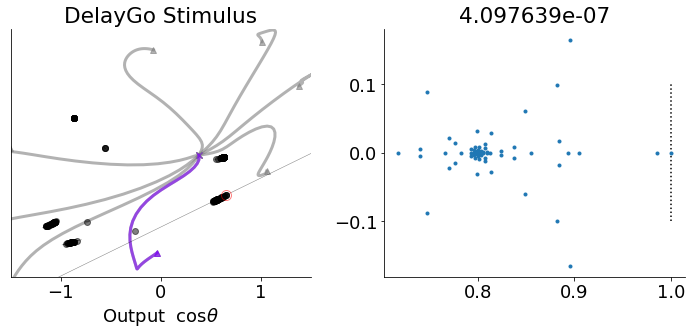

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


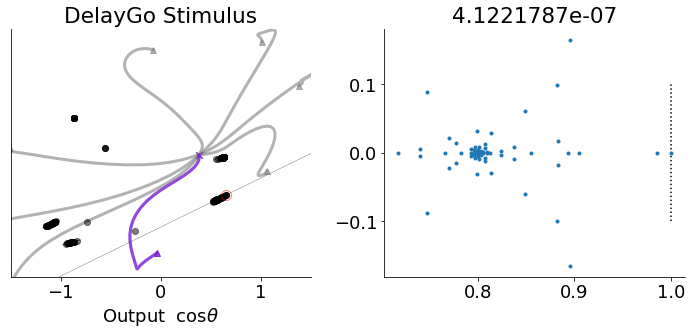

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


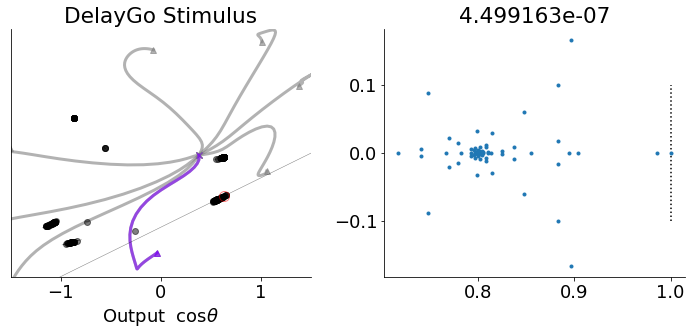

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


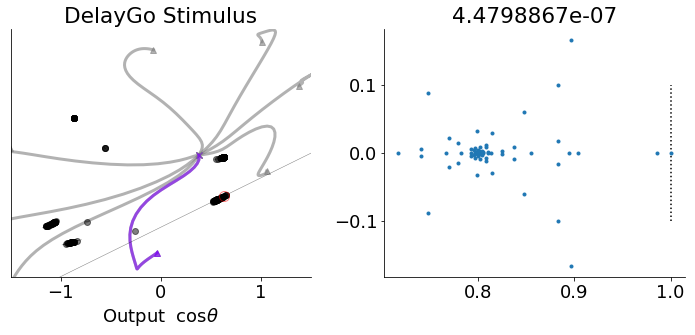

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


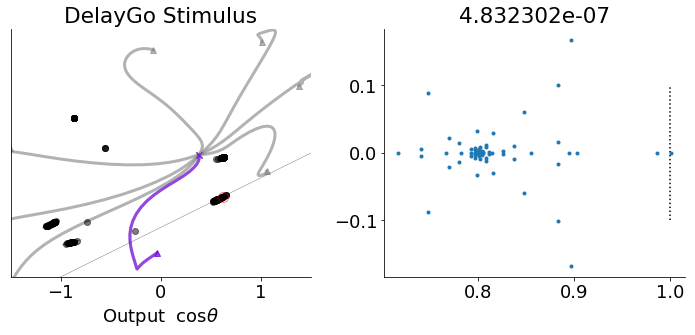

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


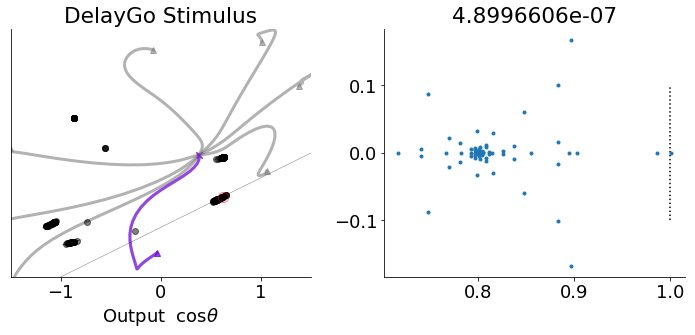

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


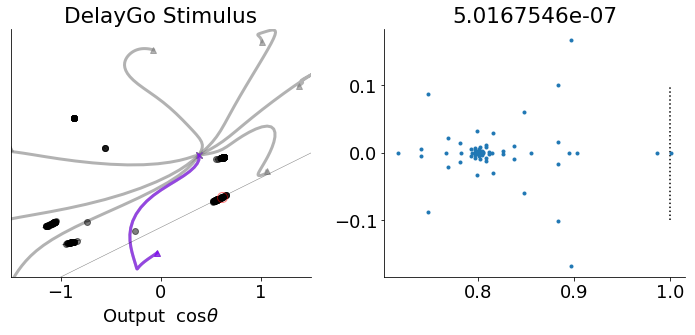

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


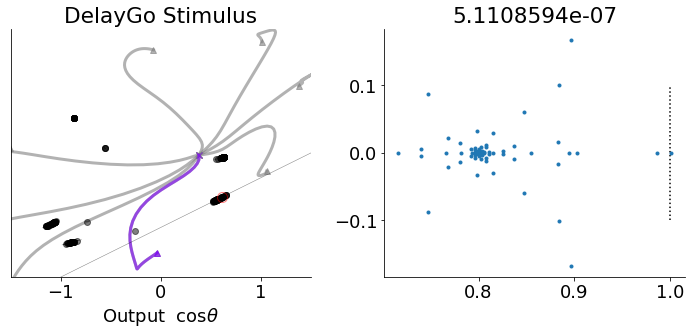

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


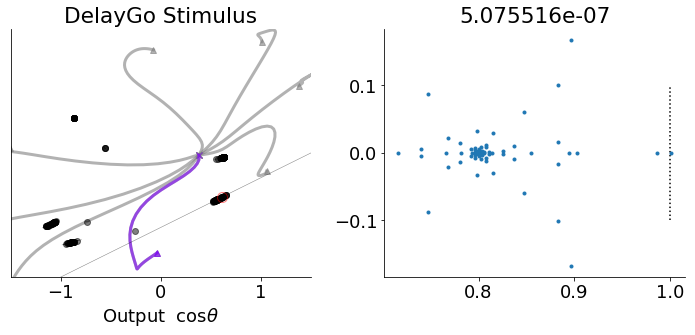

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


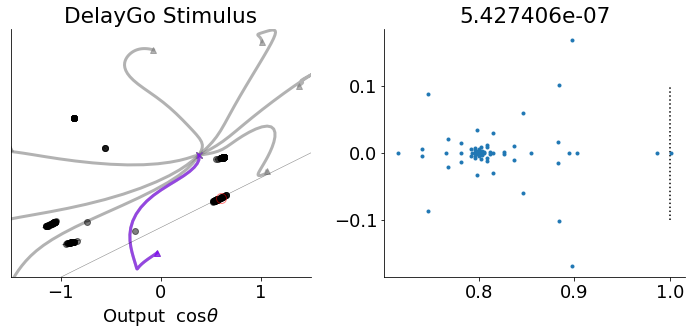

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


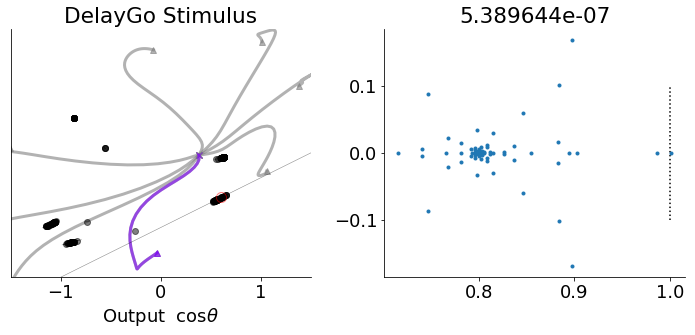

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


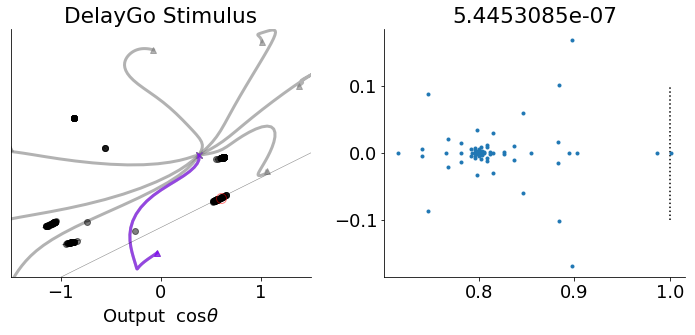

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


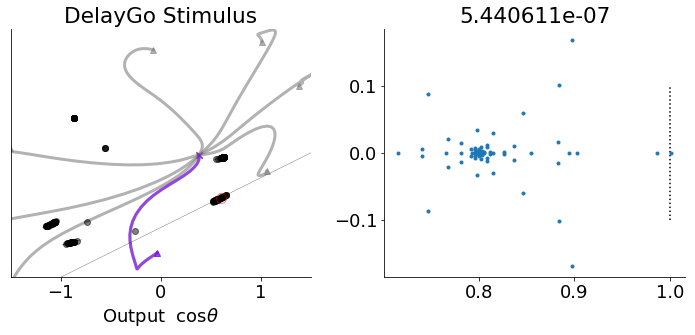

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


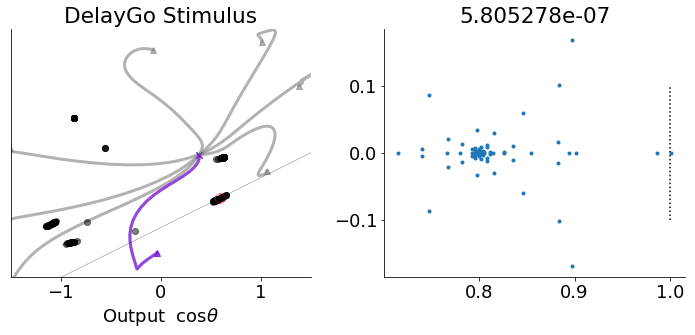

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


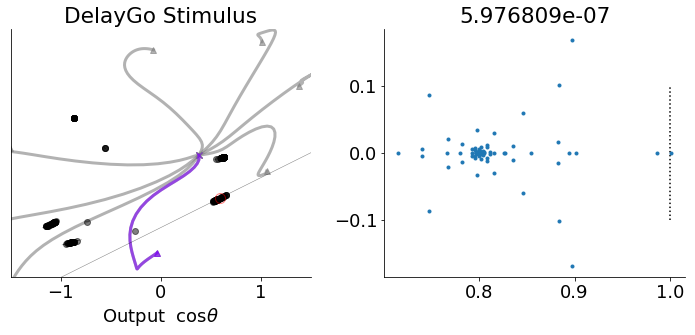

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


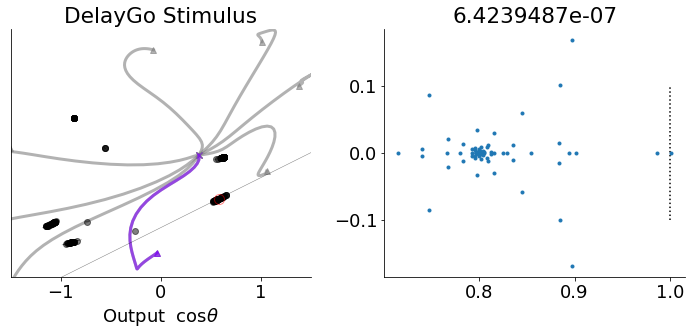

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


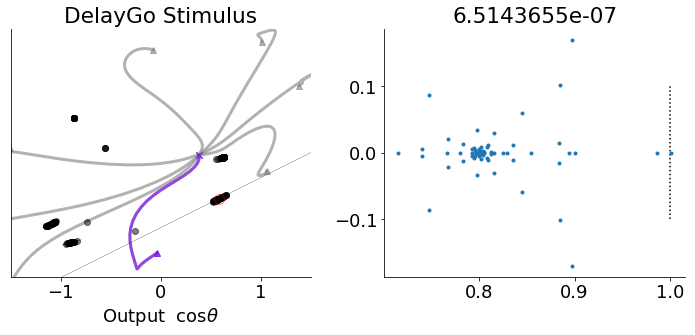

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


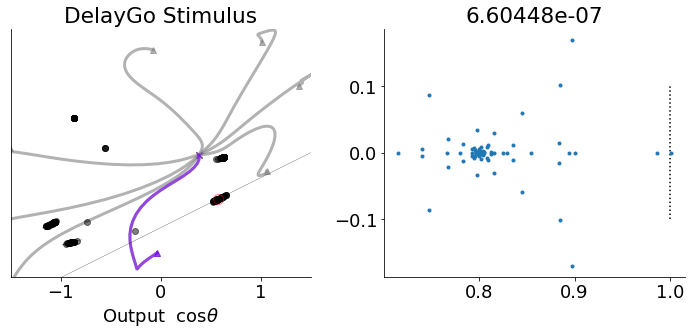

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


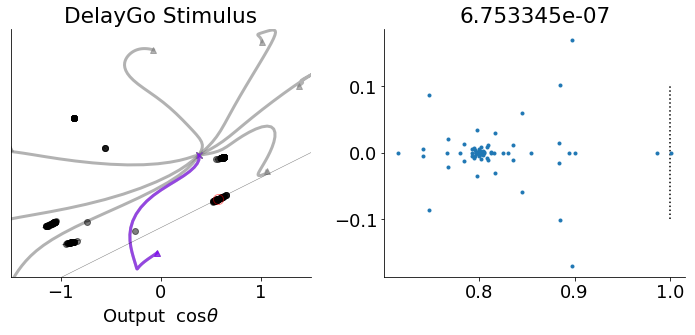

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


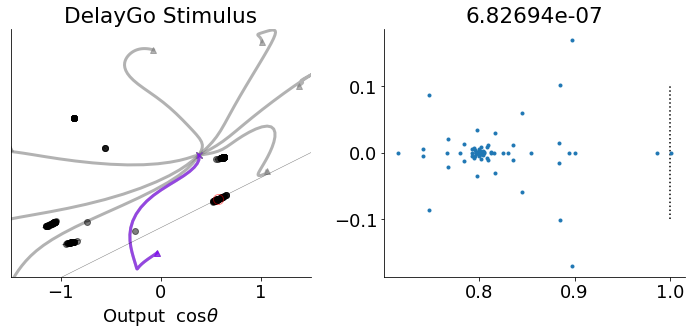

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


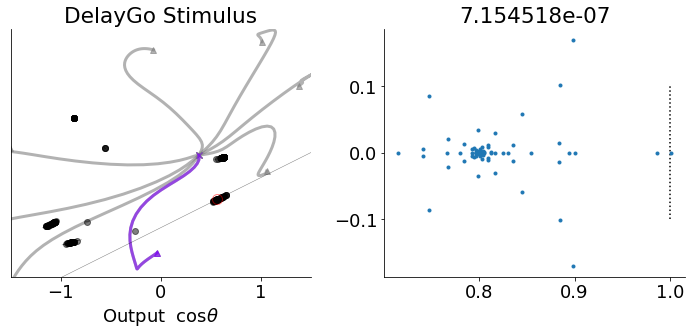

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


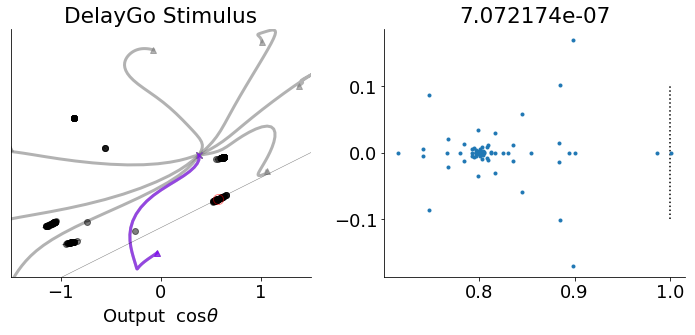

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


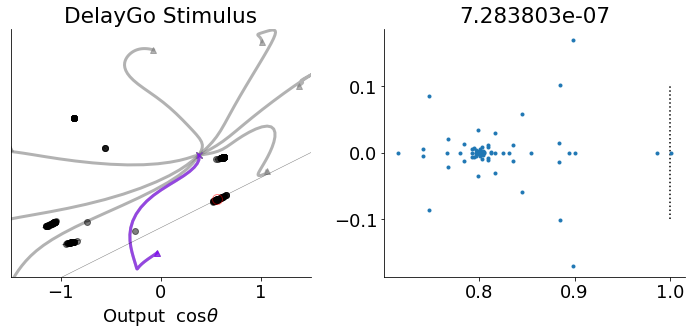

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


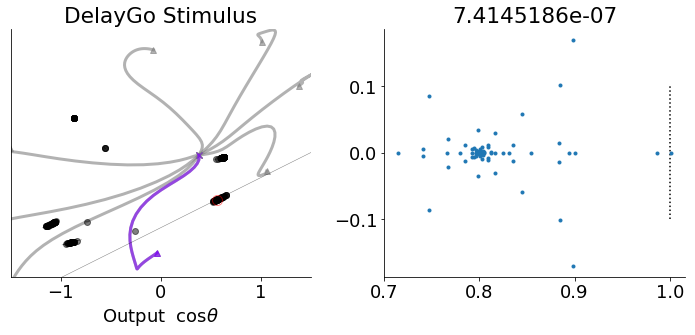

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


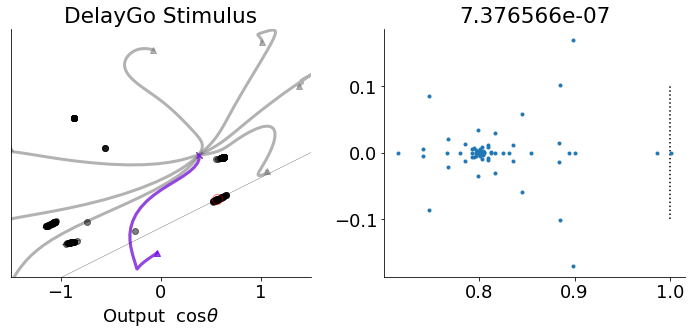

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


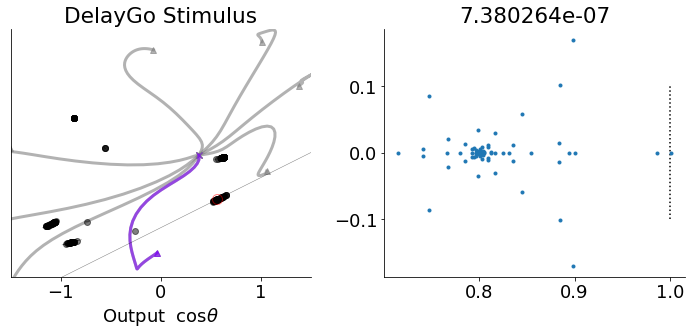

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


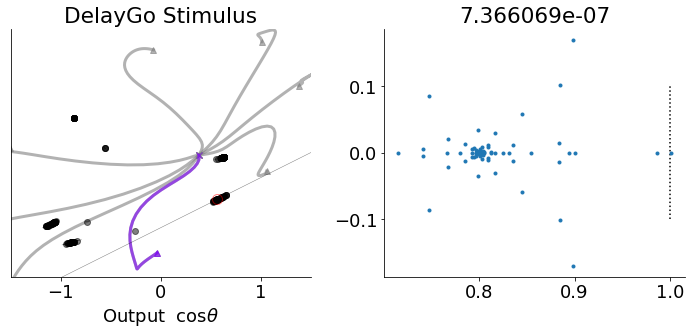

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


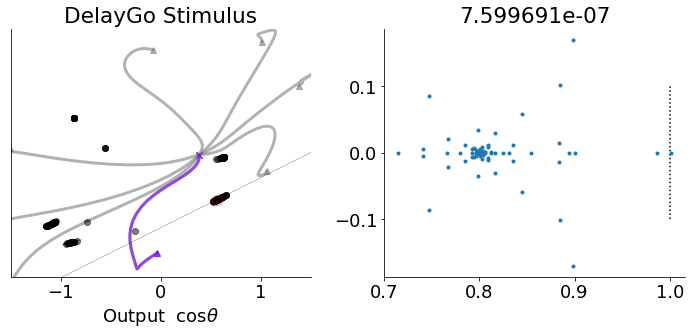

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


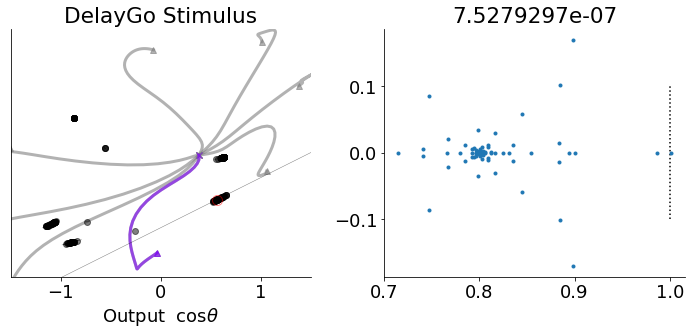

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


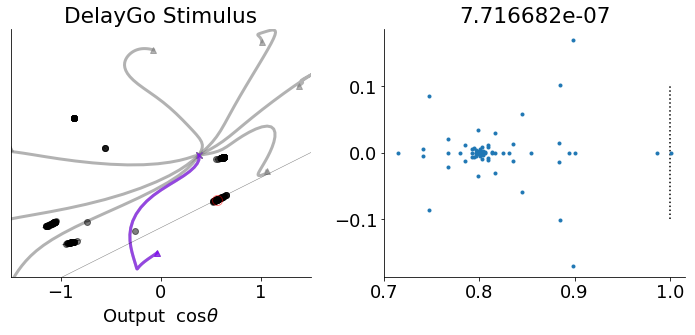

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


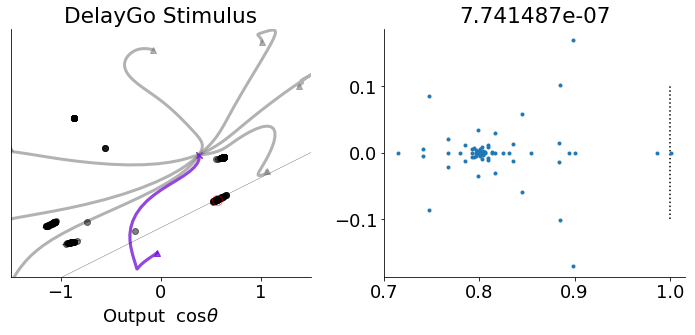

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


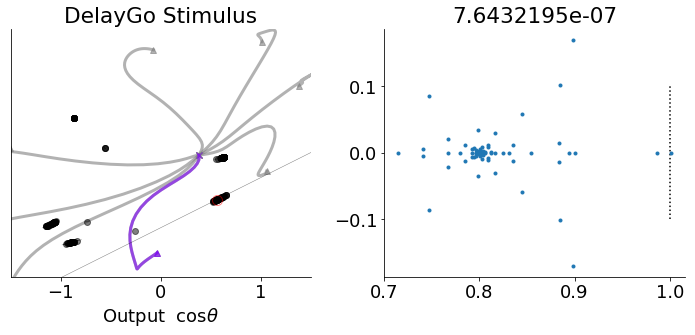

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


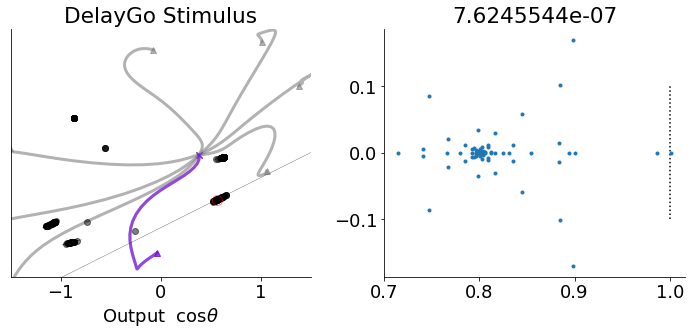

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


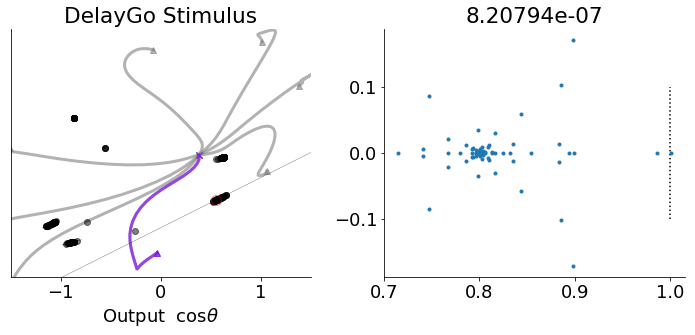

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


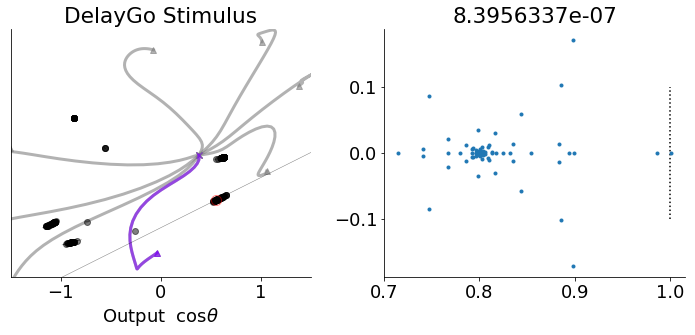

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


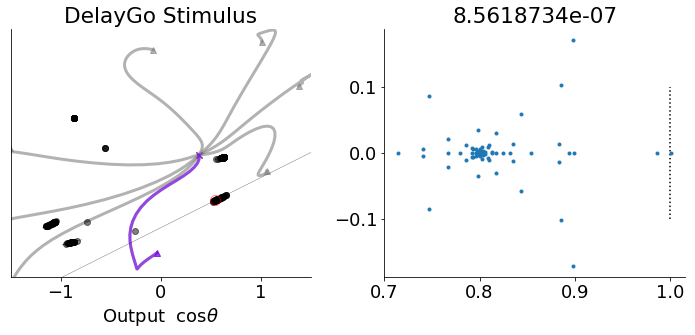

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


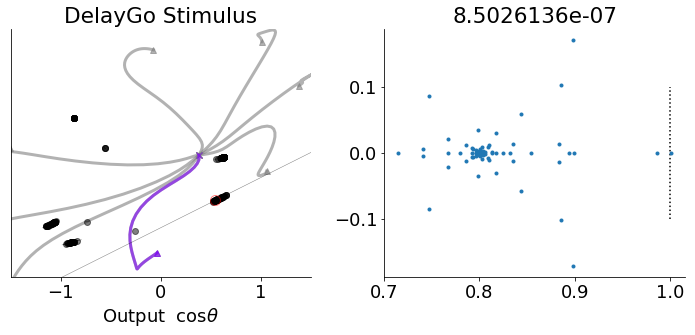

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


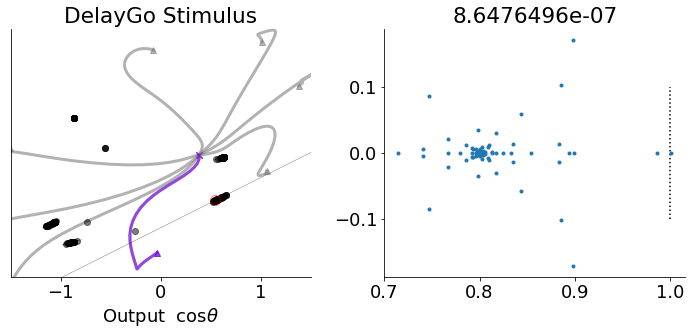

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


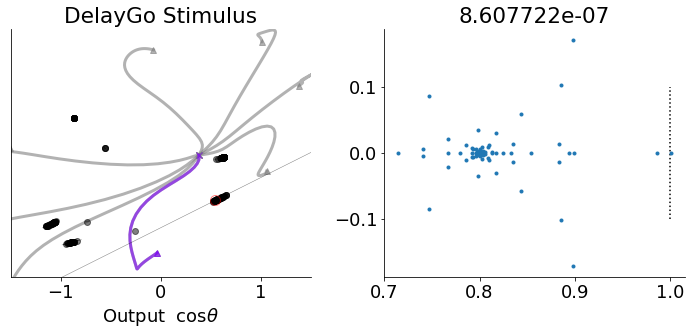

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


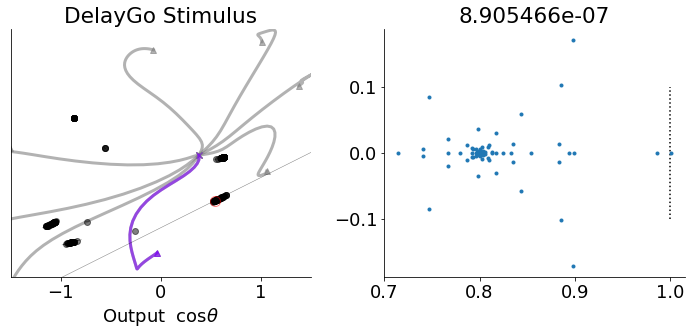

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


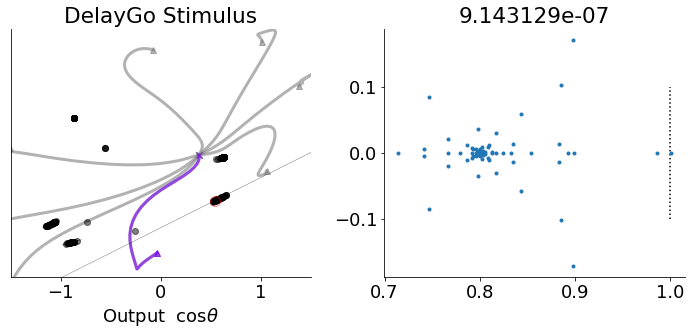

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


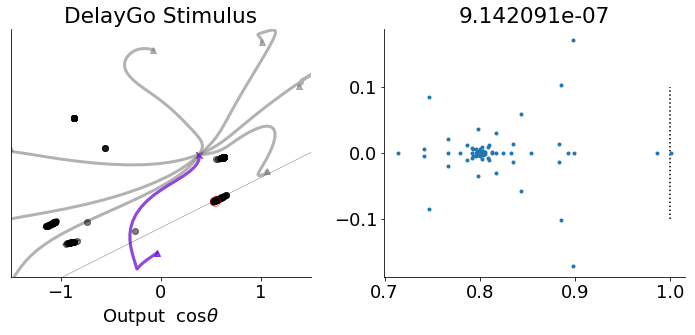

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


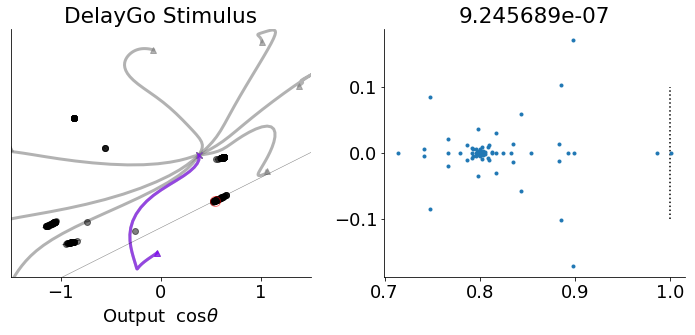

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


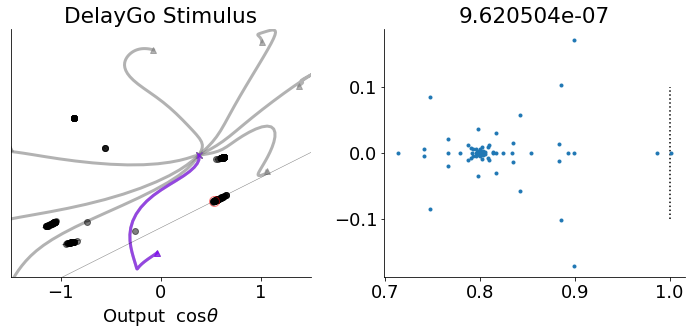

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


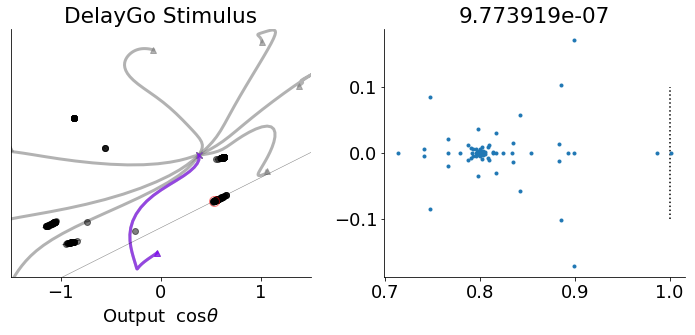

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


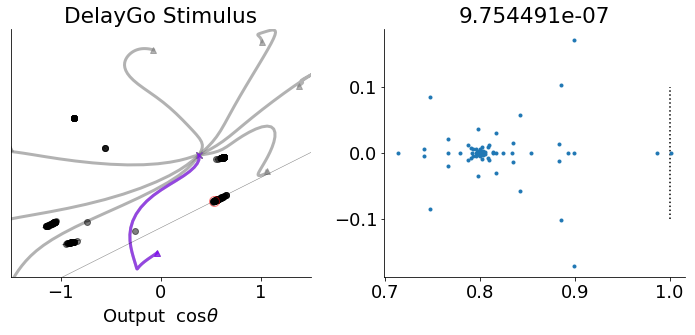

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


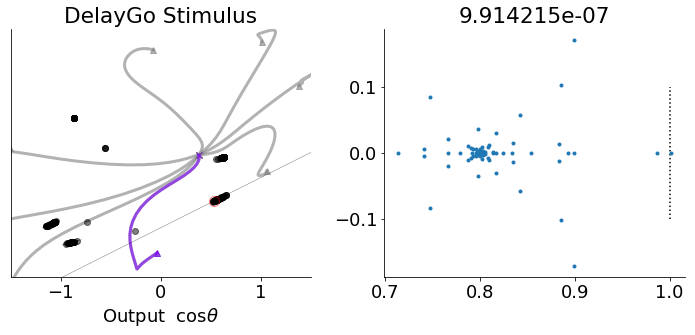

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


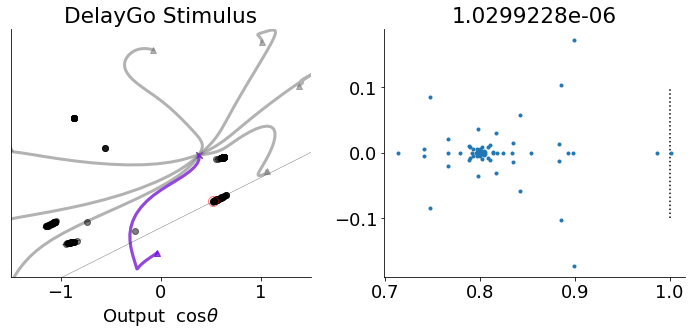

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


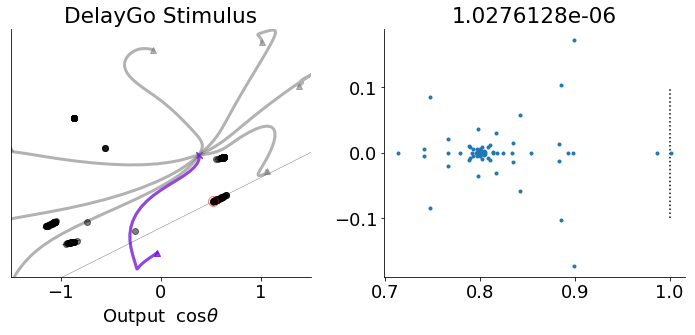

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


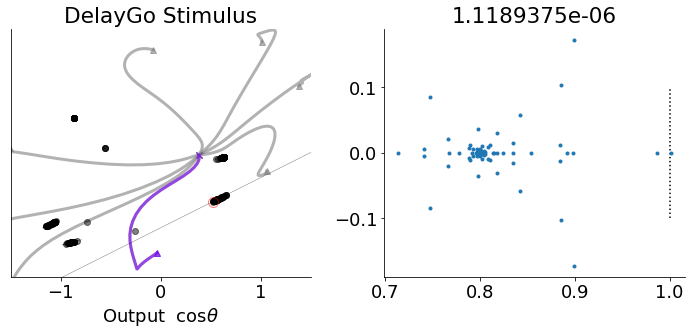

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


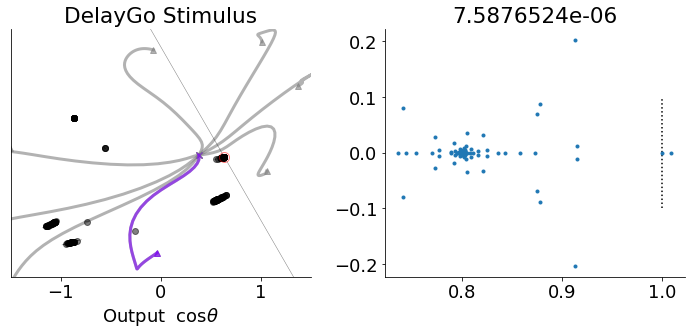

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


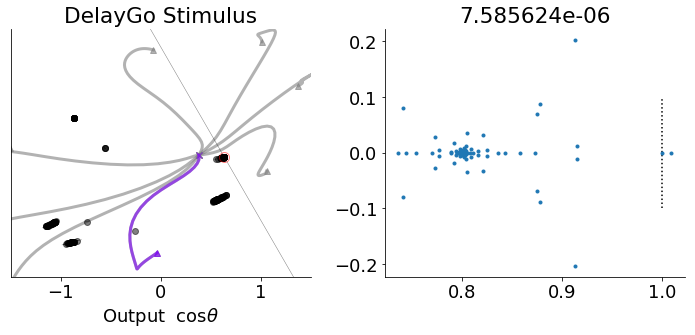

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


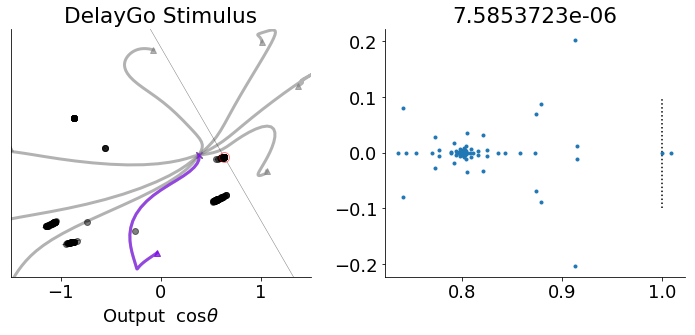

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


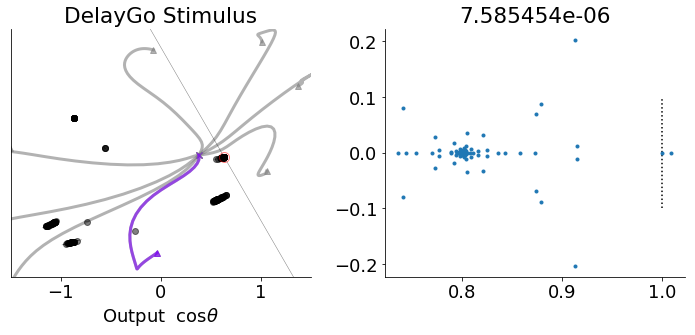

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


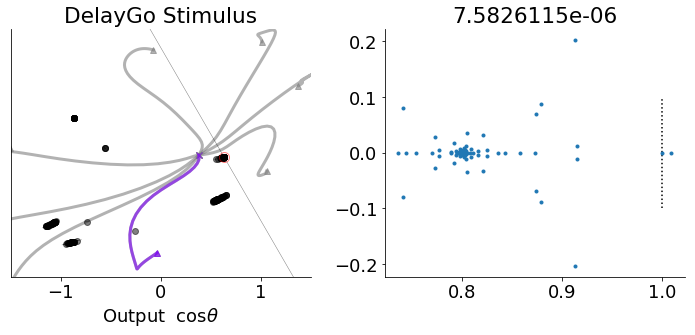

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


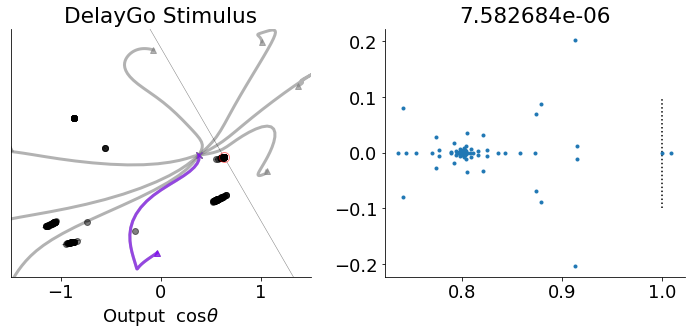

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


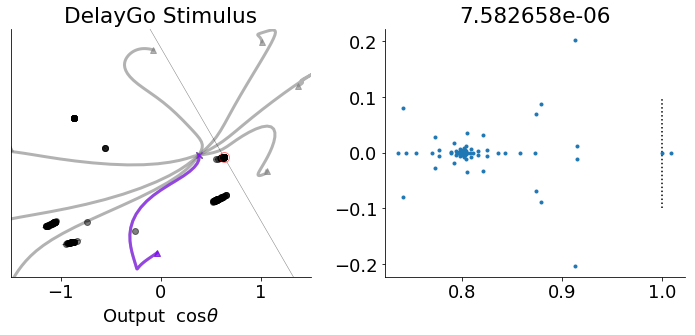

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


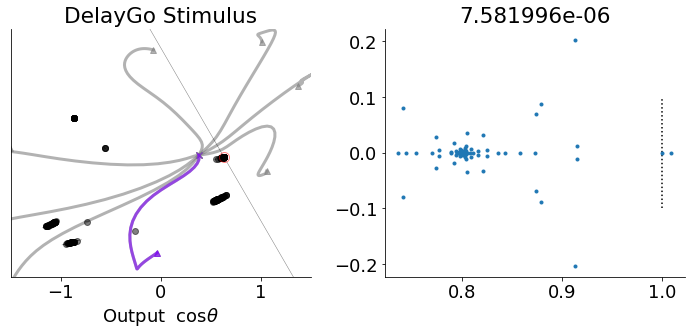

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


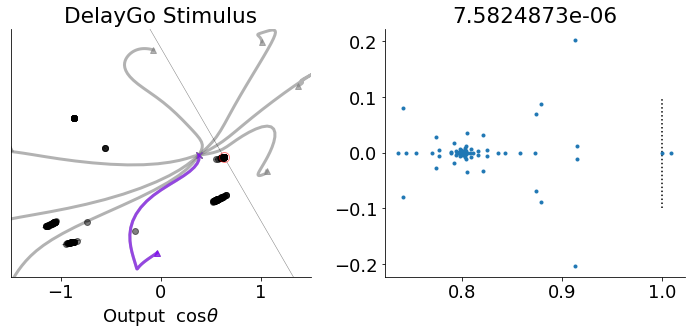

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


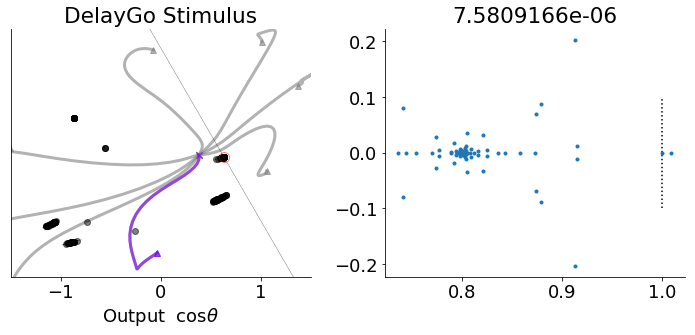

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


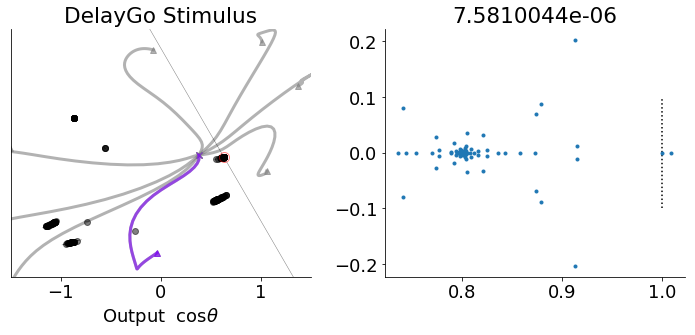

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


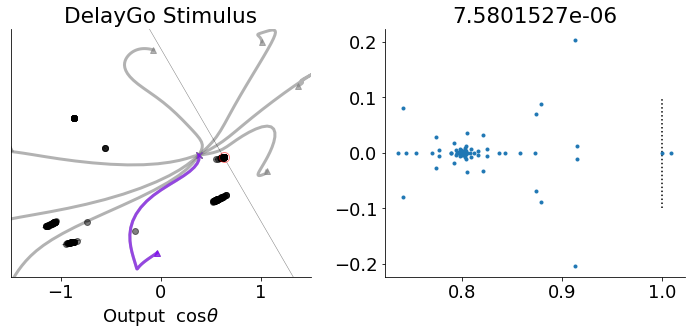

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


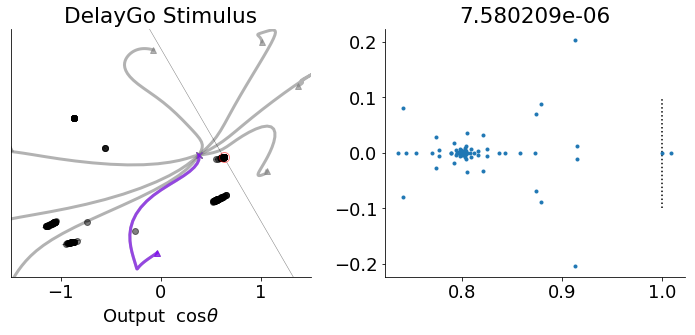

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


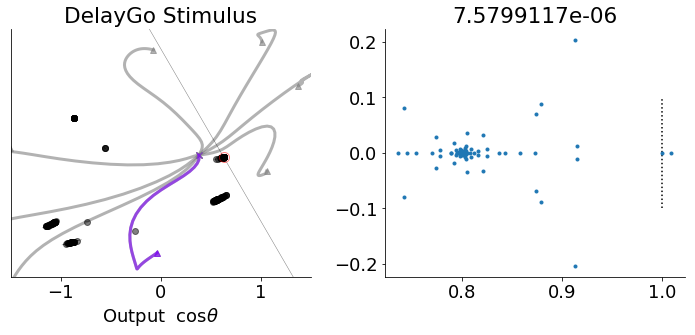

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


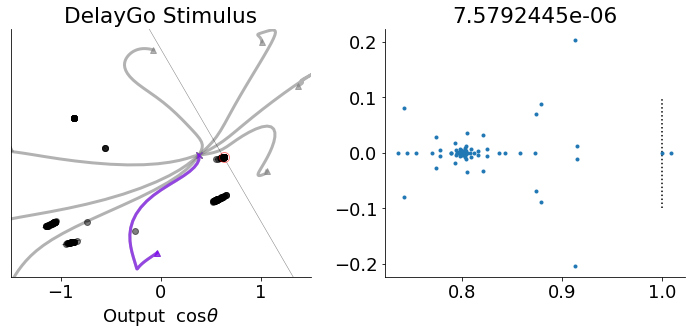

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


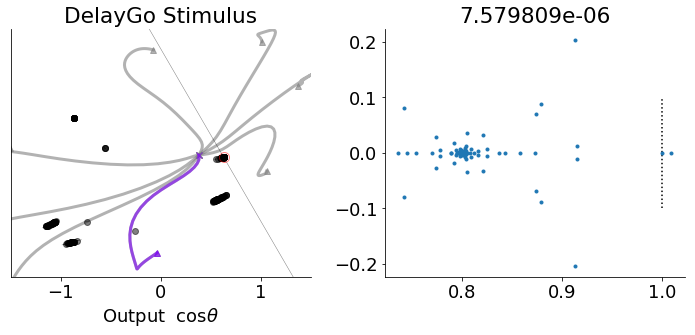

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


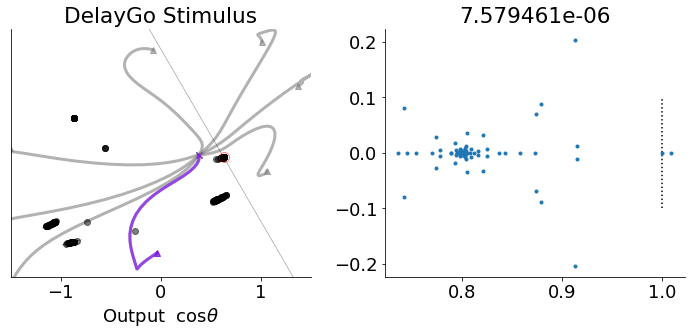

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


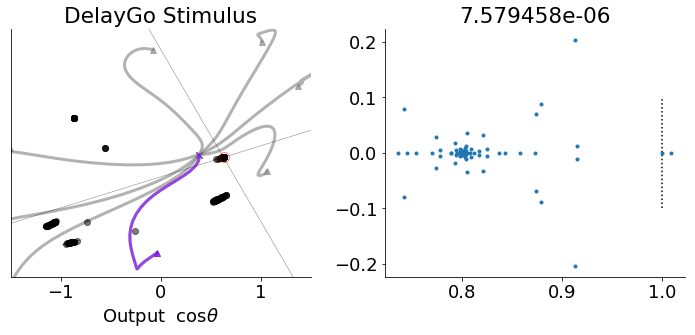

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


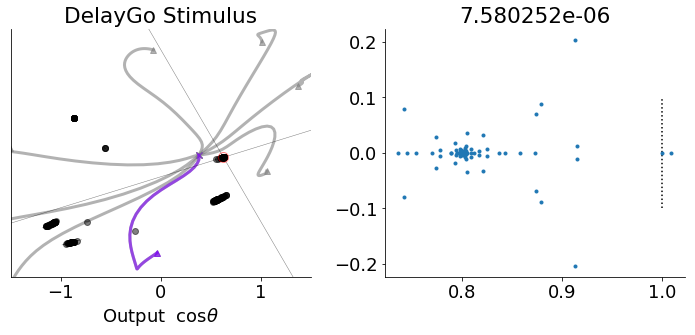

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


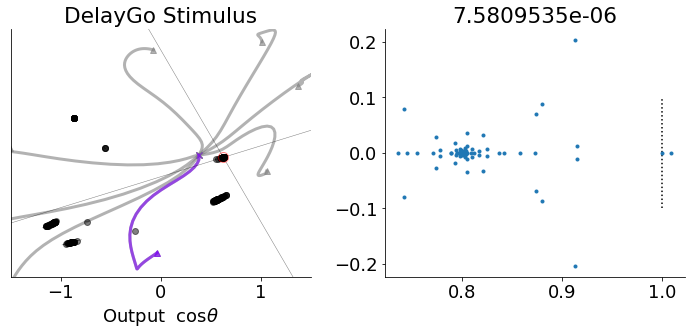

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


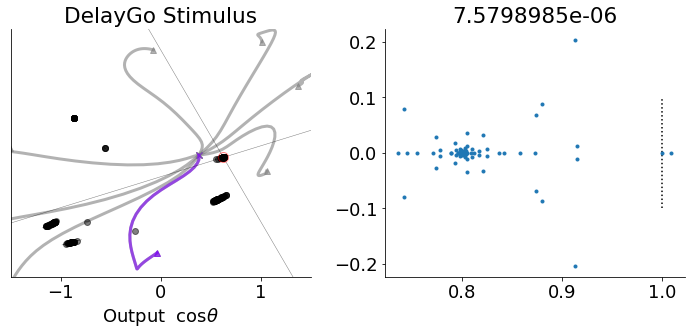

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


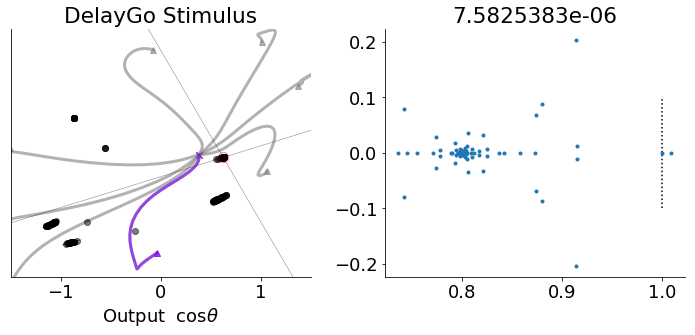

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


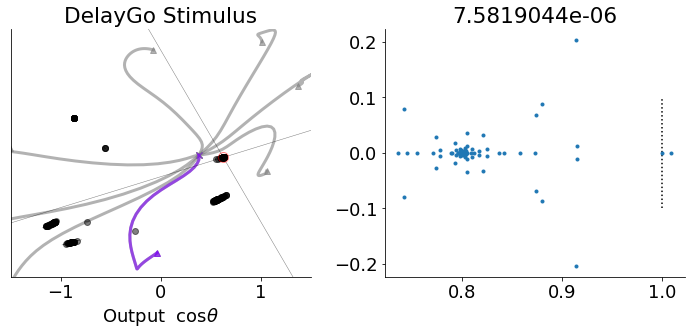

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


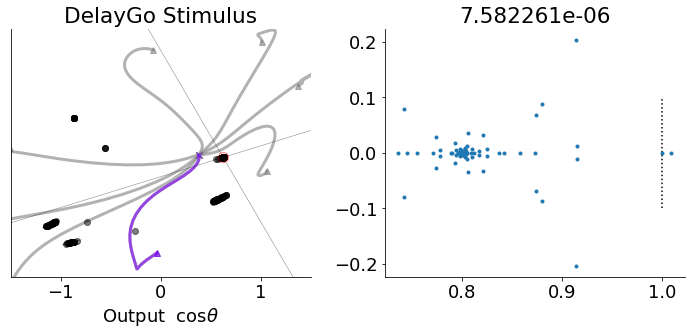

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


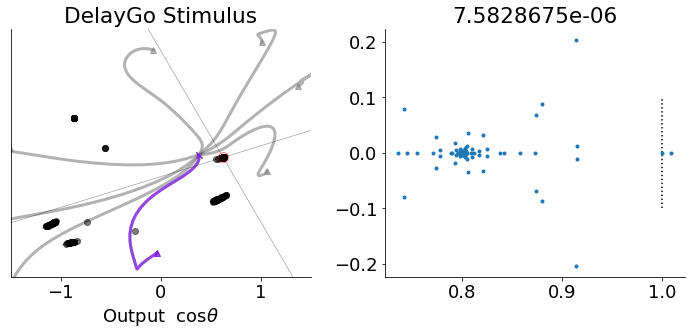

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


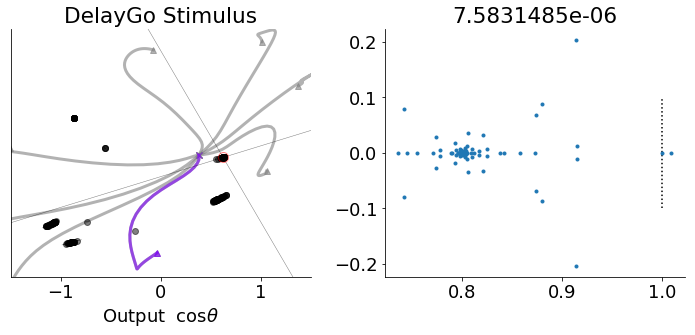

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


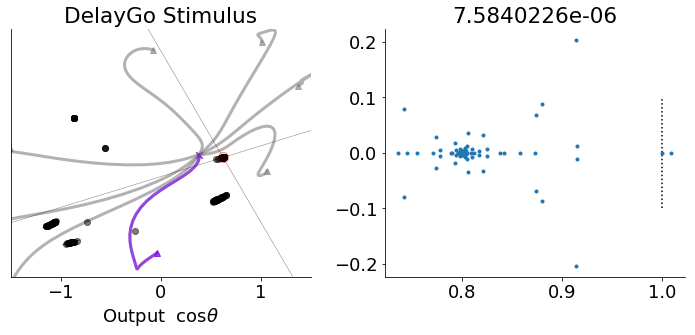

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


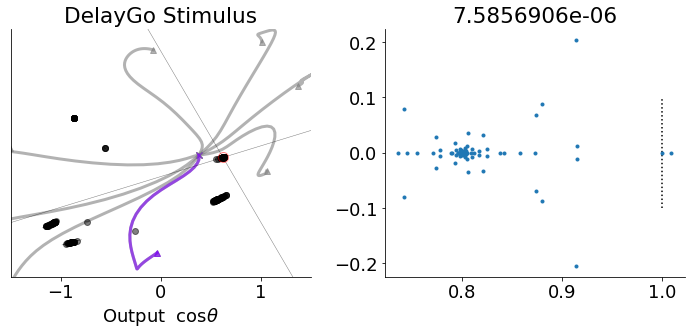

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


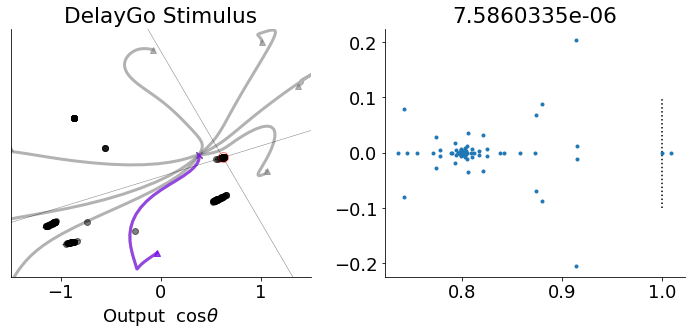

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


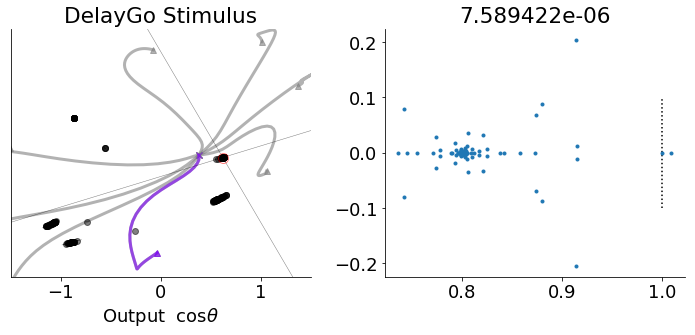

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


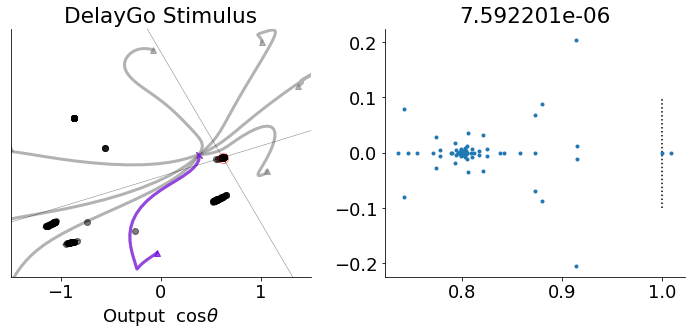

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


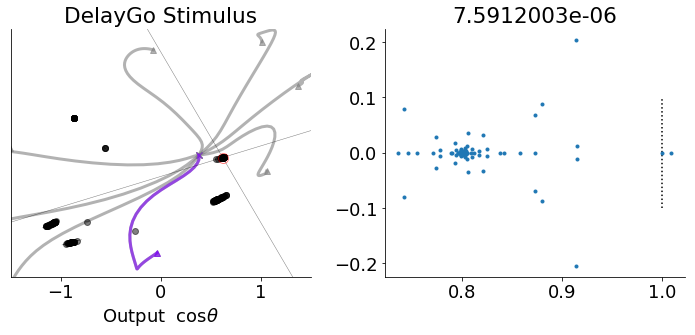

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


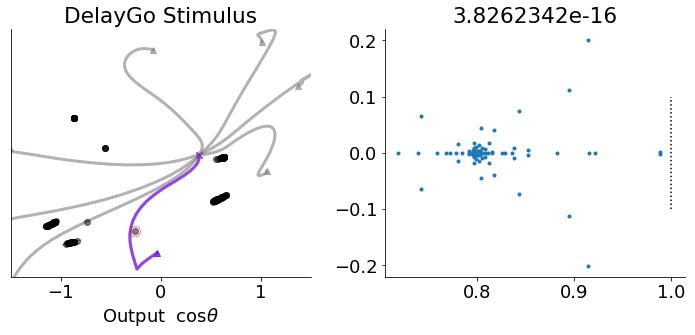

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


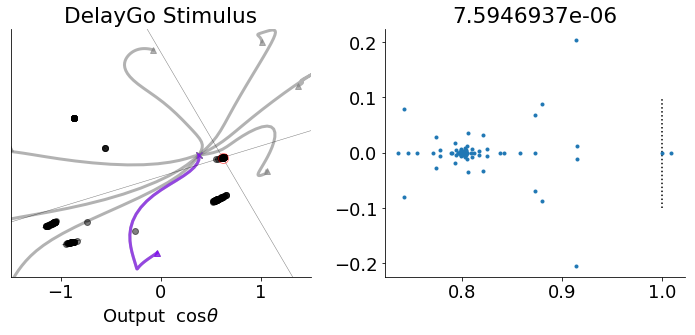

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


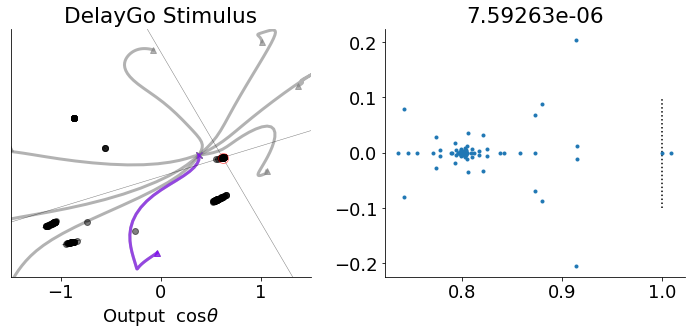

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


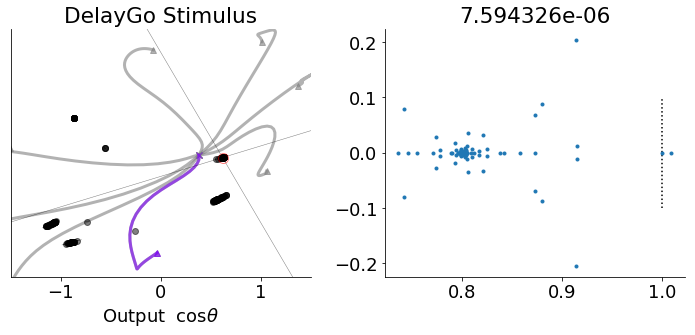

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


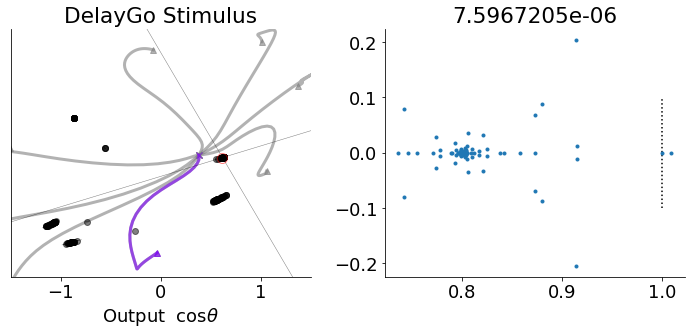

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


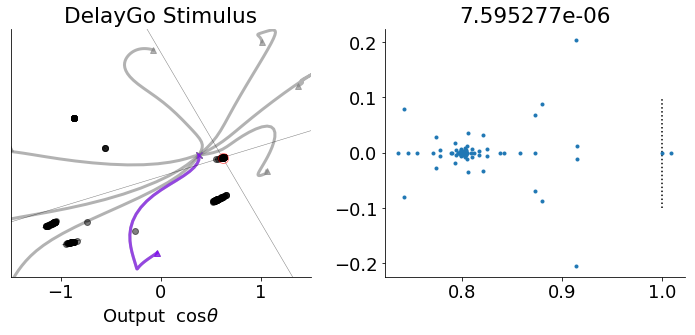

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


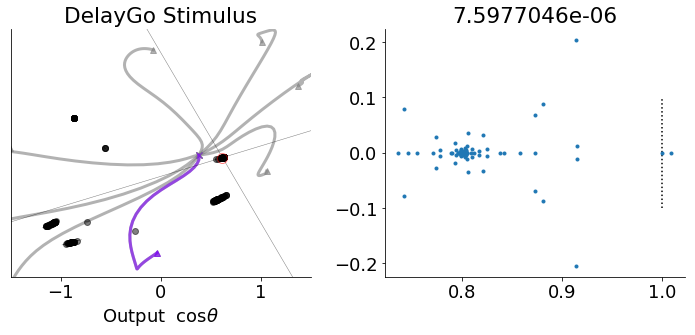

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


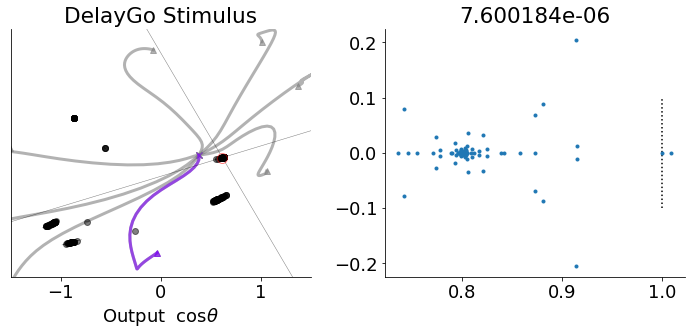

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


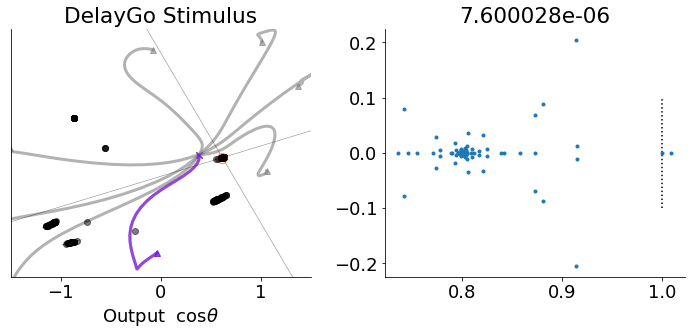

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


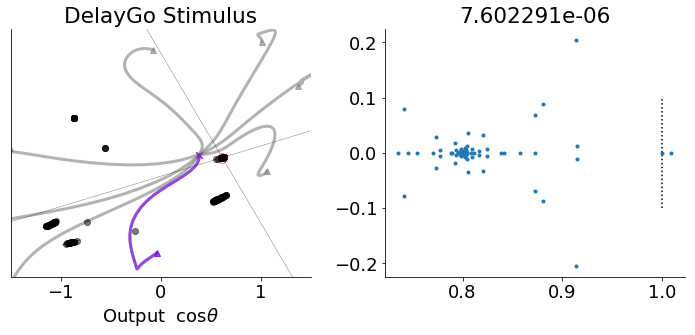

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


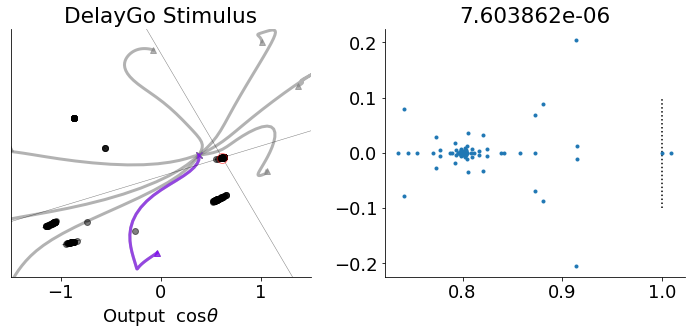

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


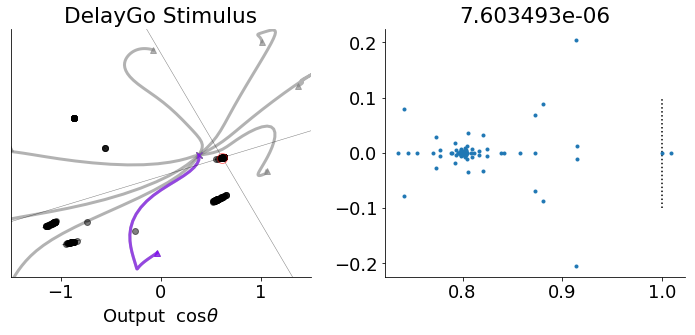

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


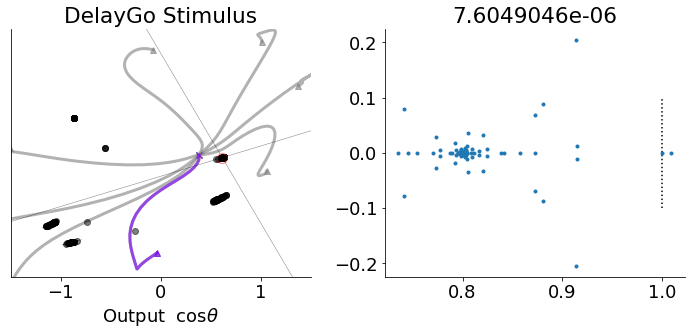

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


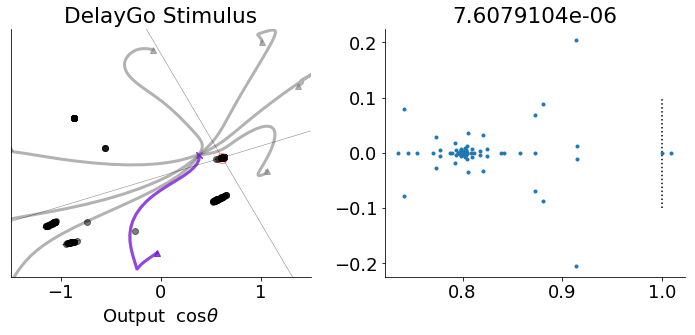

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


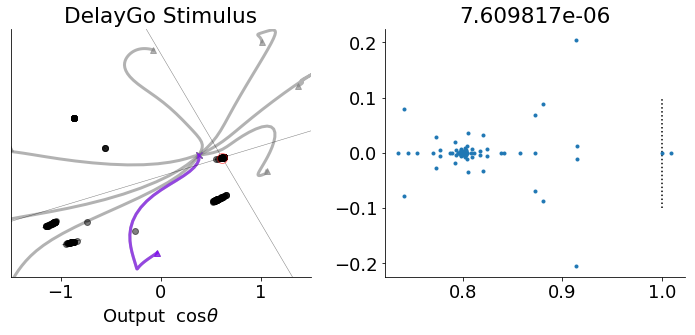

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


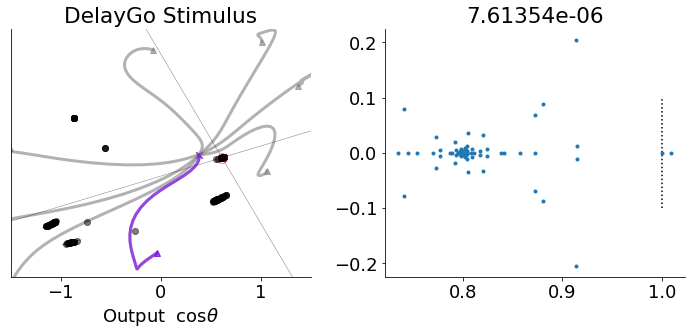

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


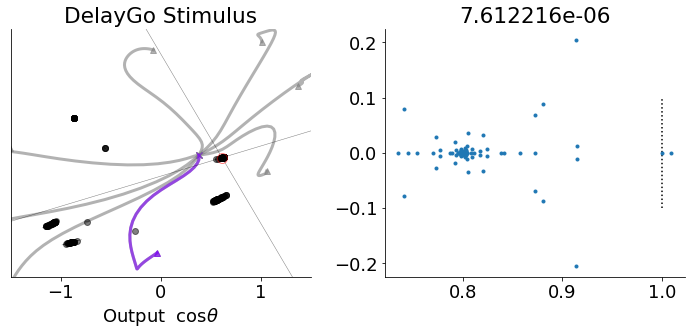

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


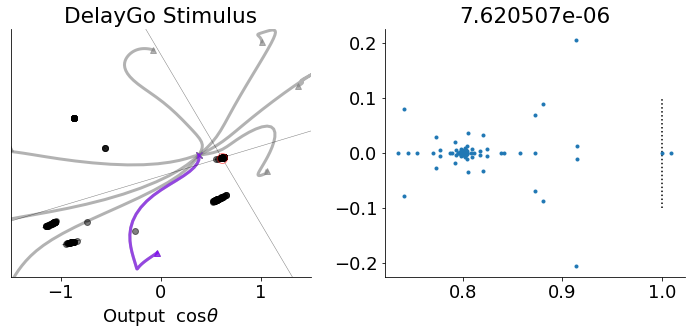

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


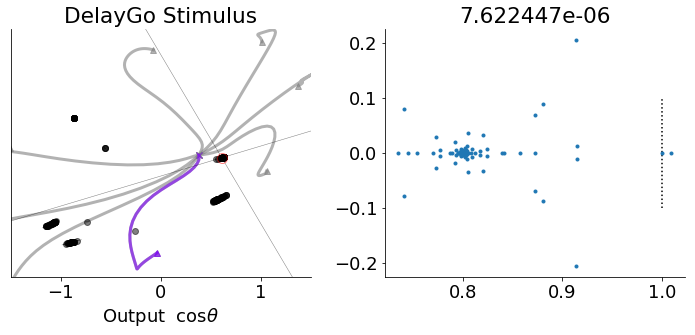

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


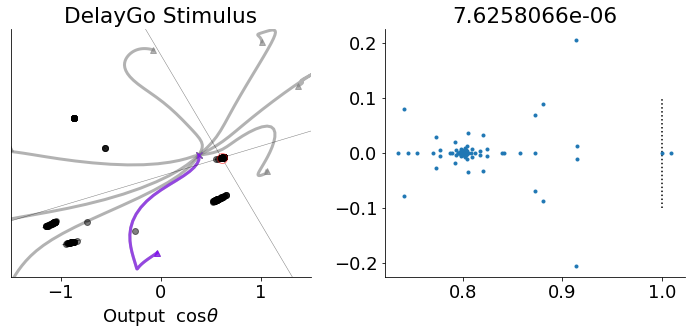

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


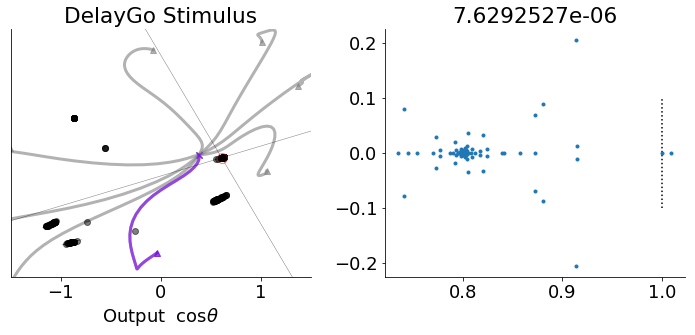

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


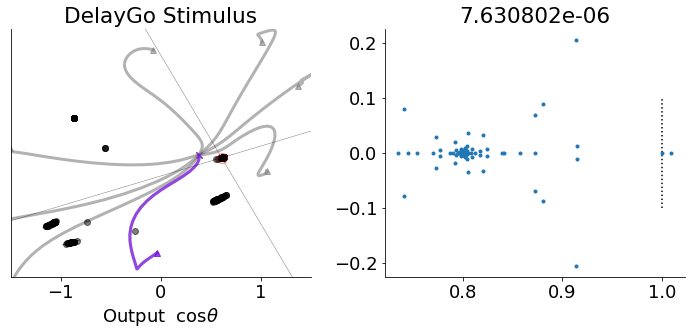

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


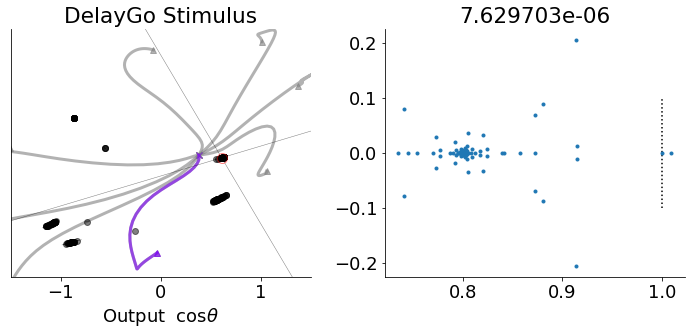

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


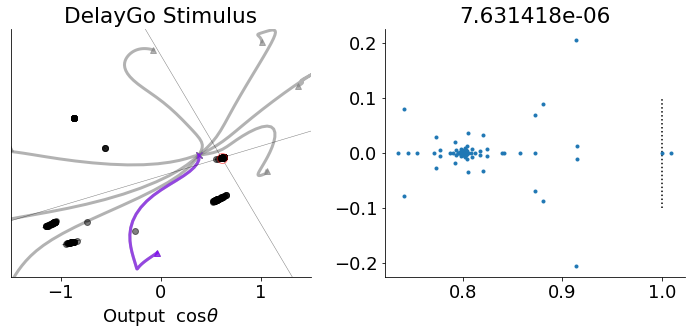

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


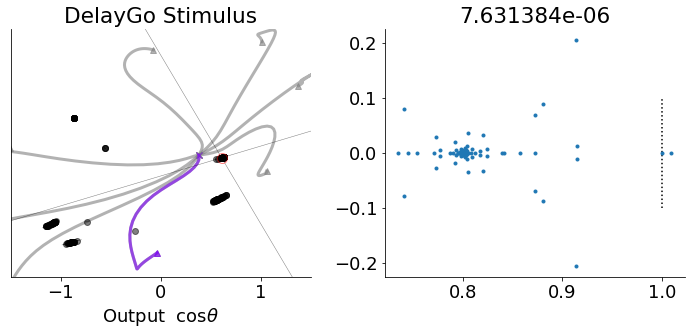

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


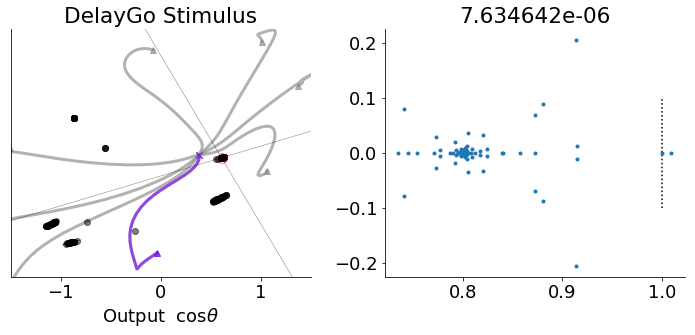

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


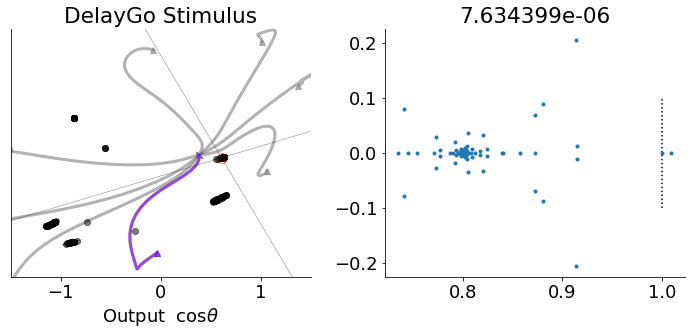

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


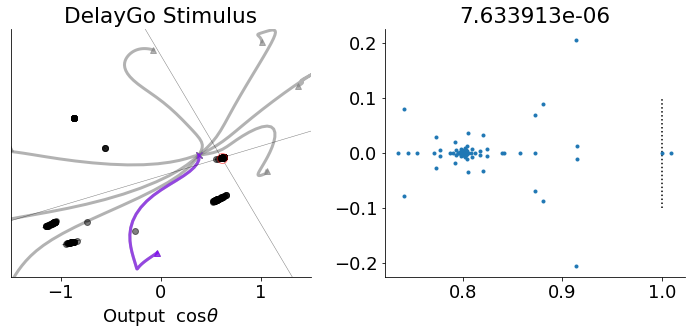

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


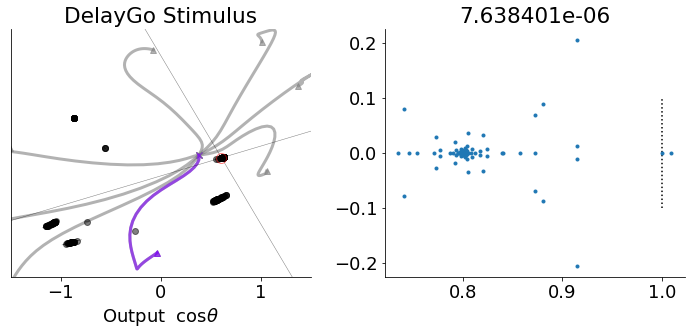

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


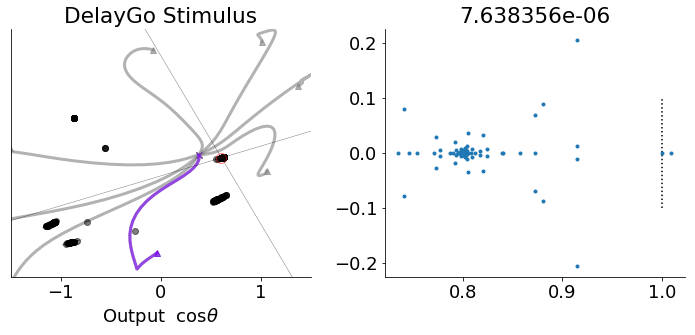

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


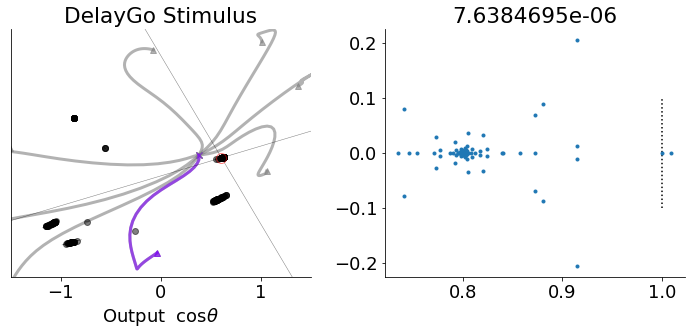

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


KeyboardInterrupt: 

In [117]:
t_num = 0
rule_ind = 0
fp_epoch = 'stim1'
epoch_order = range(len(epoch_set))
rule = rules_dict['all'][rule_ind]
qlim = 1#.0000001
filename = os.path.join(model_dir_all,'golub_fixed_pts',rule,fp_epoch+'_'+str(t_num)+'.npz')
fp_struct = np.load(filename)

fp_logic = fp_struct['qstar']< 1
eig_decomps = comp_eig_decomp(fp_struct['J_xstar'][fp_logic,:,:])
sorted_fps = fp_struct['xstar'][fp_logic,:]
plot_FP(sorted_fps, D.T, eig_decomps, c)

S = np.shape(fp_struct['qstar'])[0]
for s in range(S):
    fig = plt.figure(figsize=(10,5),tight_layout=True,facecolor='white')
    ax = plt.subplot(1,2,1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(100),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=1,t_num = t_num,qlim = qlim)
    plot_FP_specific(s,sorted_fps, D_stim.T, eig_decomps, c = 'r')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')

    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)  
    
    ax = plt.subplot(1,2,2)
    
    plt.plot([1,1],[-.1,.1],':k')
    plt.plot(eig_decomps[s]['evals'].real,eig_decomps[s]['evals'].imag,'.')
    
    plt.title(str(fp_struct['qstar'][s]))
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)  
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0

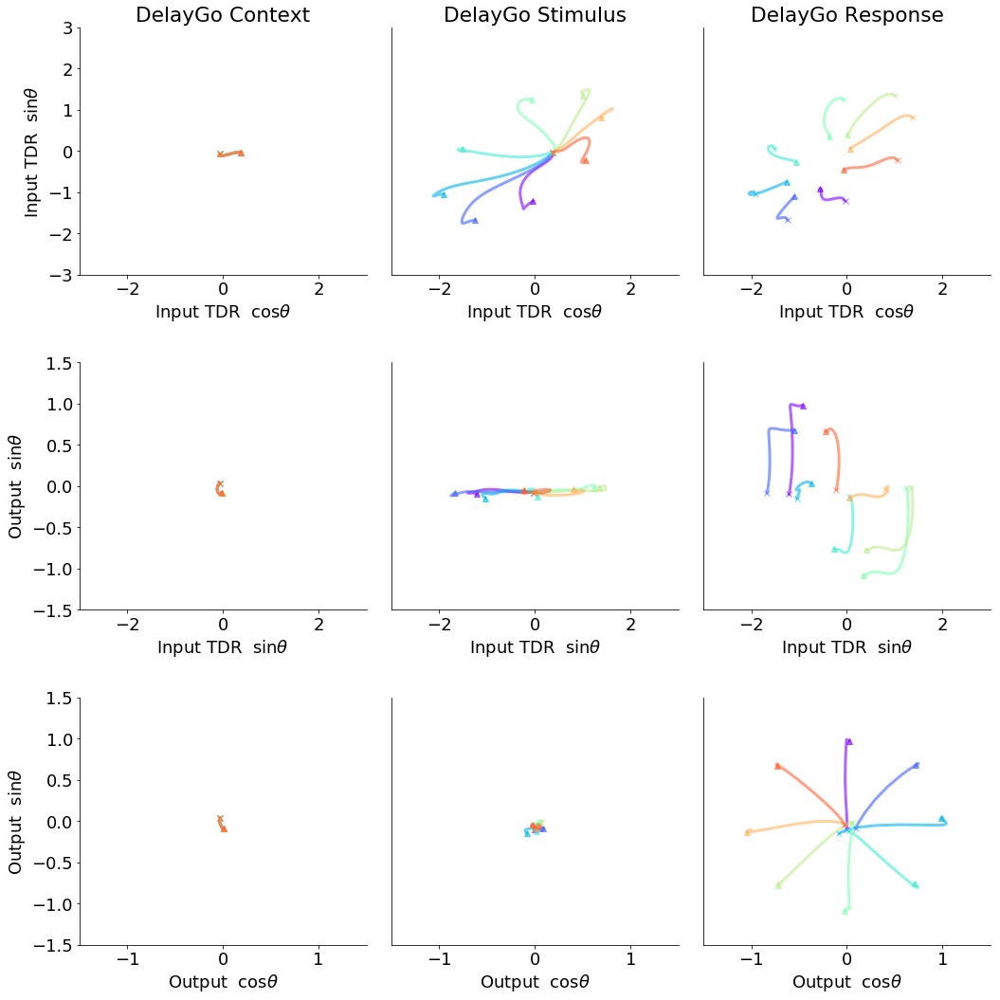

In [107]:
axes_epoch = 'stim1'
rule_ind = 0
do_plot = 0
nr = 3
t_num = 0
qlim = .0000001
input_lim = 3

epoch_set = ['fix1','stim1','go1']
epoch_order = range(3)
rule = rules_dict['all'][rule_ind]
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    D_innout = np.concatenate((D_stim[:,1:],w_out[:,2:]),axis = 1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_innout,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.xlim((-input_lim,input_lim))
    plt.ylim((-1.5,1.5))  
    plt.xlabel('Input TDR ' + r' $\sin{\theta}$') 
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+2*len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_Act_trials.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kern

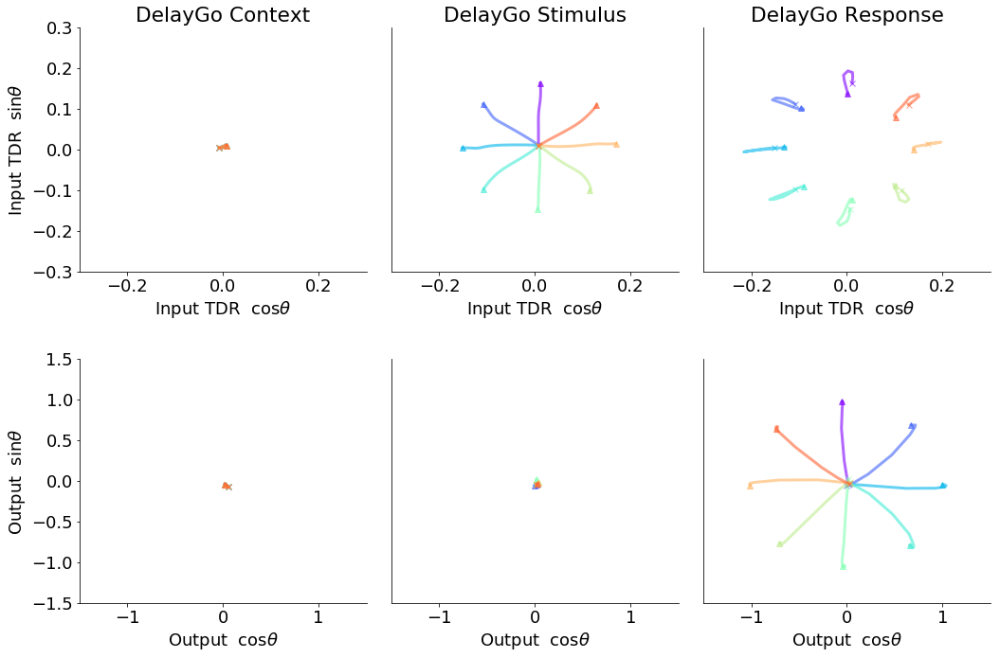

In [25]:
axes_epoch = 'stim1'
rule_ind = 0
do_plot = 0
nr = 2
t_num = 0
qlim = .0000001
input_lim = .3

epoch_set = ['fix1','stim1','go1']
epoch_order = range(3)
rule = rules_dict['all'][rule_ind]
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_Act_trials_small.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softp

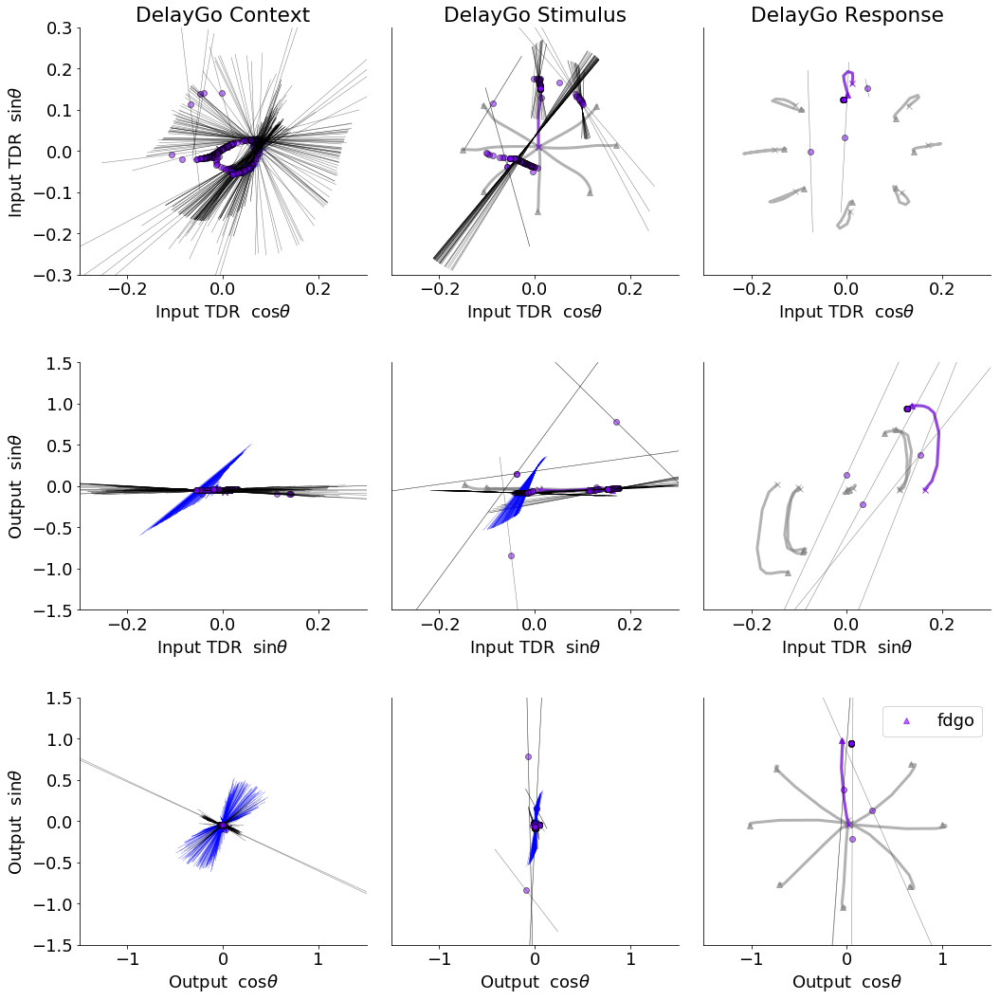

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kern

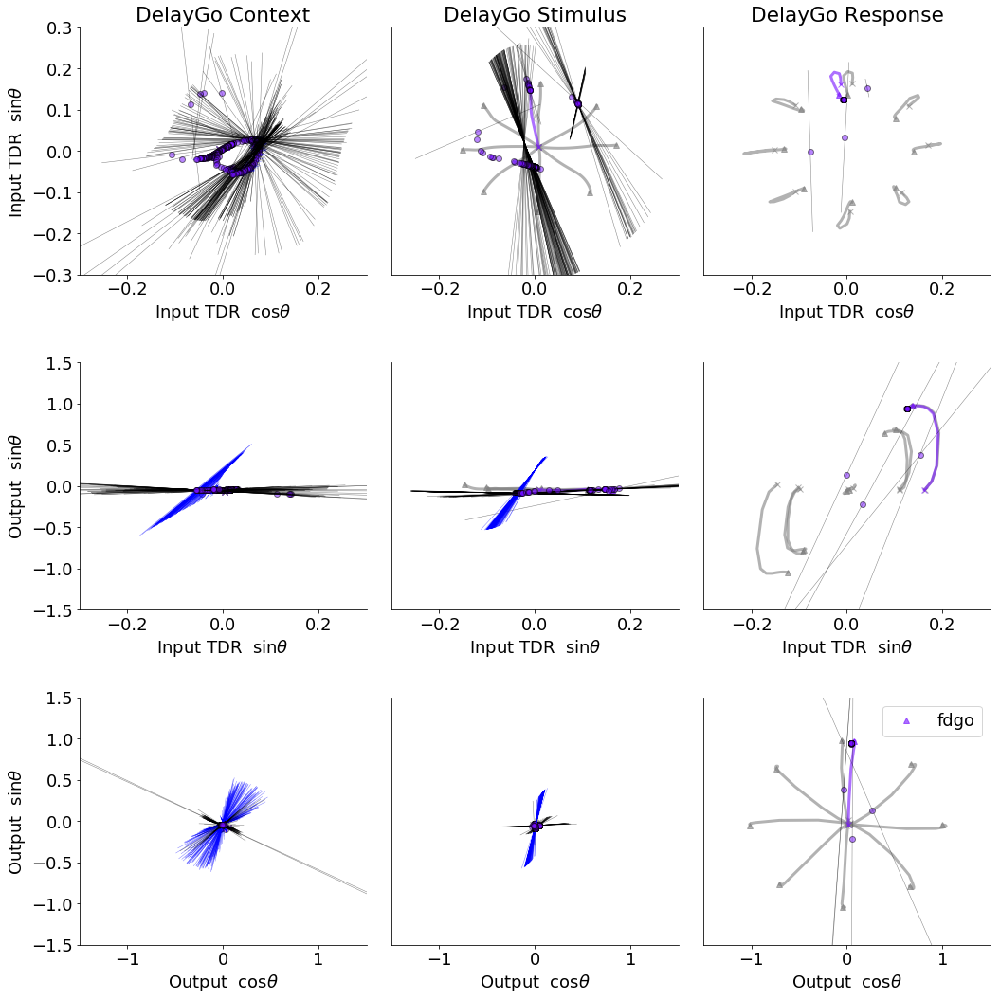

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kern

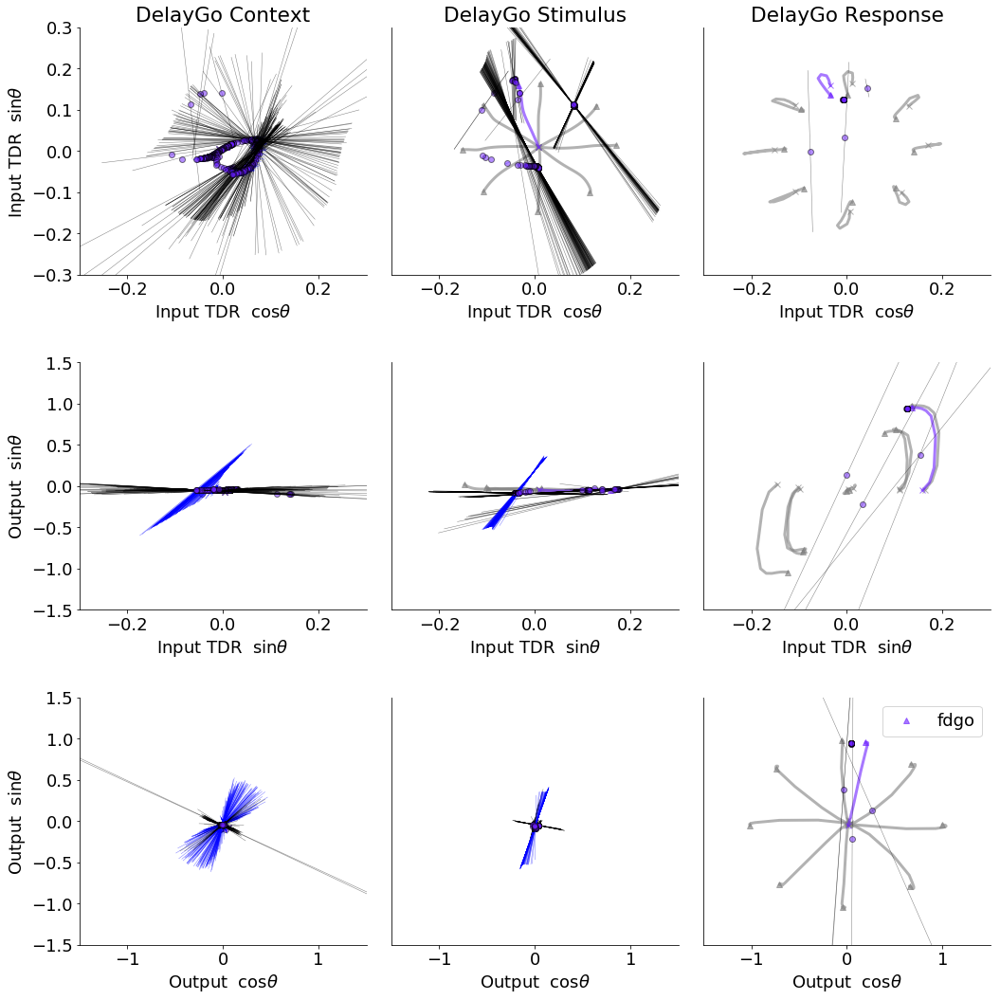

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kern

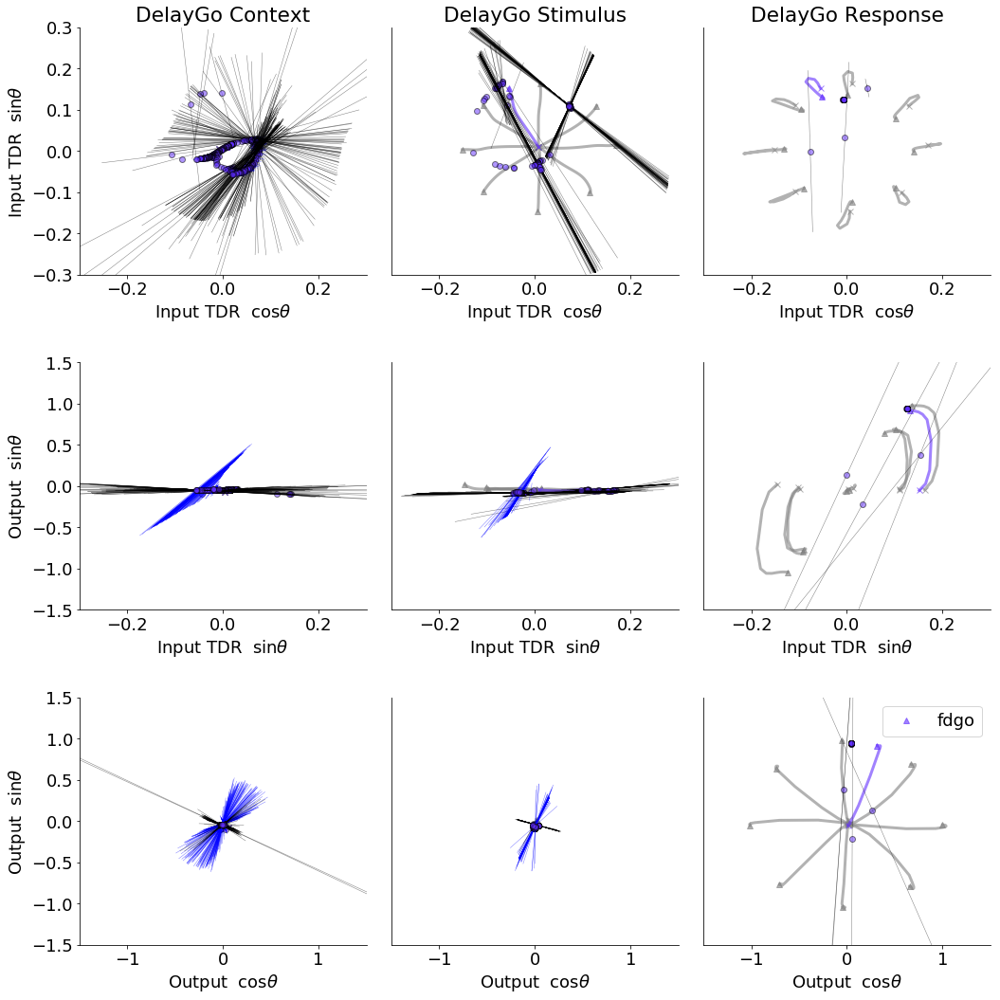

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kern

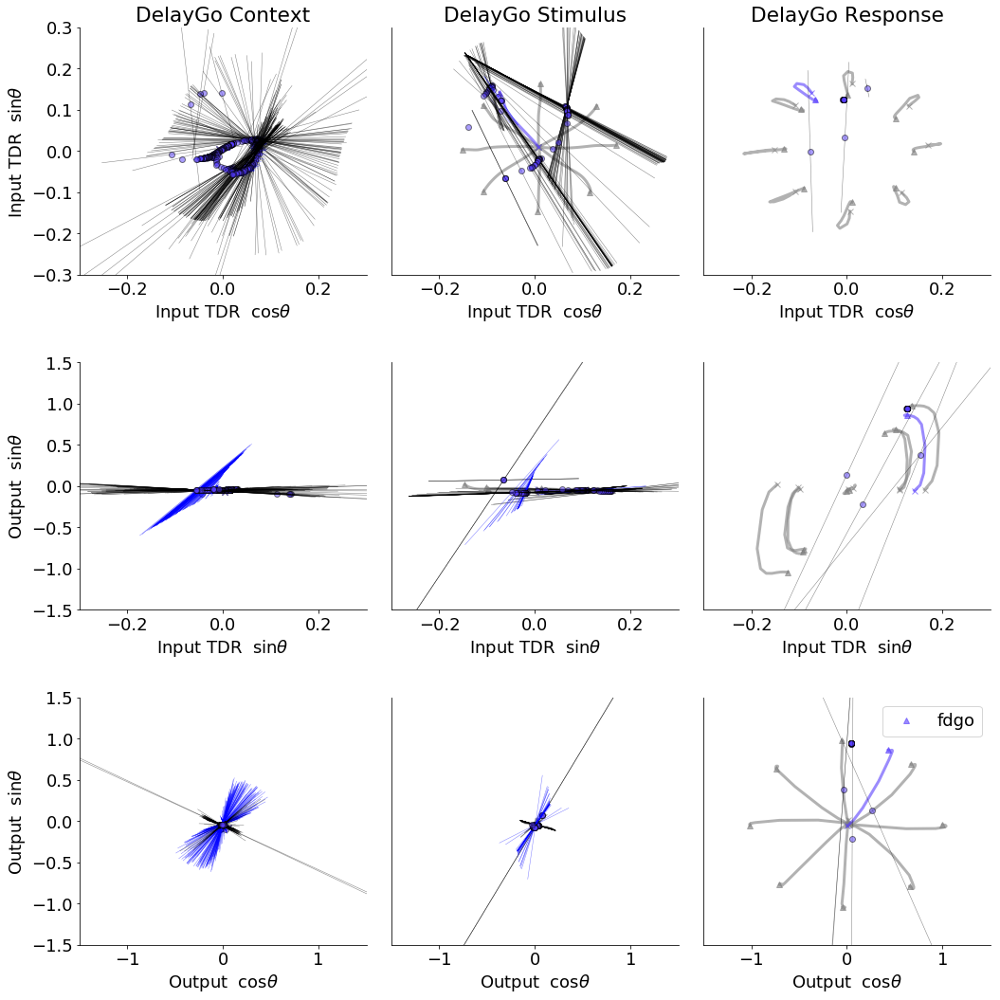

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
400
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kern

KeyboardInterrupt: 

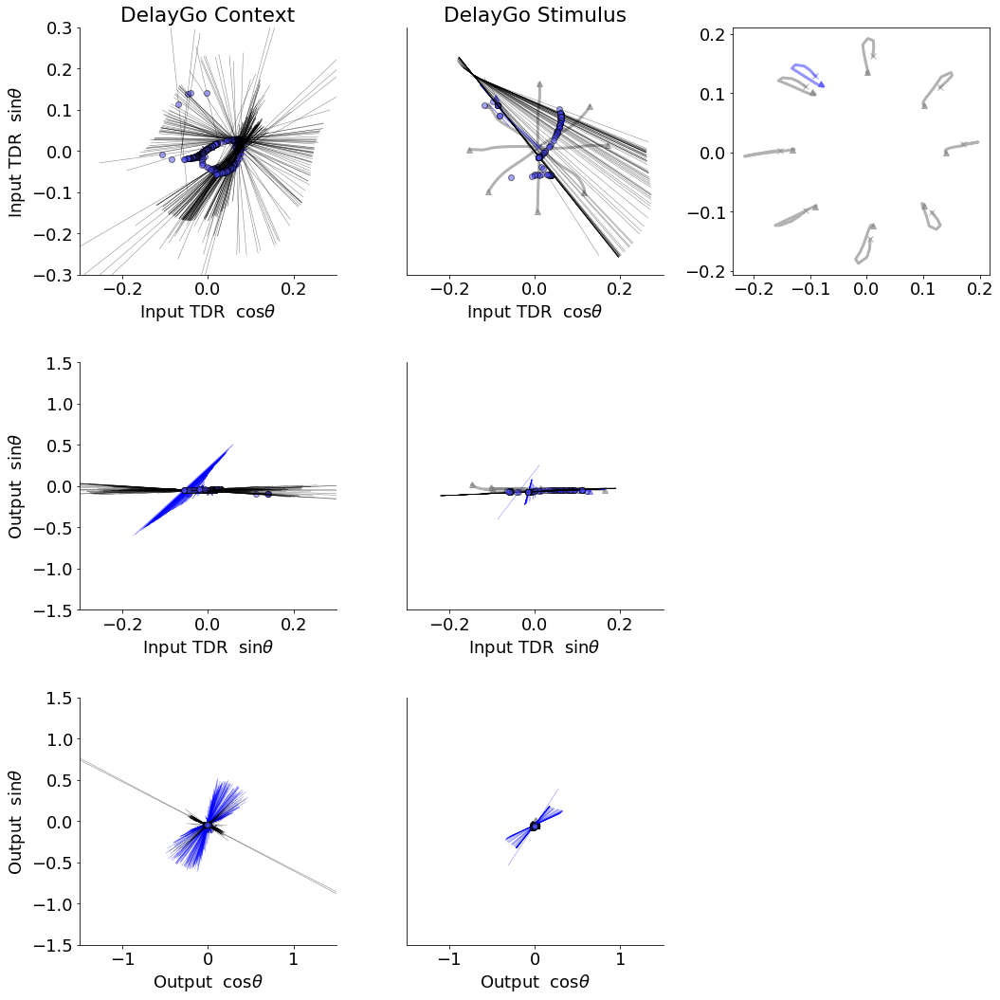

In [27]:
axes_epoch = 'stim1'
rule_ind = 0
do_plot = 1
nr = 3
t_num = 0
qlim = 1#.0000001
input_lim = .3

epoch_set = ['fix1','stim1','go1']
epoch_order = range(3)
rule = rules_dict['all'][rule_ind]

for t_num in range(0,400,8):
    fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

    for fp_epoch_ind in range(len(epoch_set)):
        fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
        D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

        ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
        plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                                  do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
        plt.ylim((-input_lim,input_lim))    
        plt.xlim((-input_lim,input_lim))  
        plt.xlabel('Input TDR ' + r' $\cos{\theta}$')

        if fp_epoch_ind==0:
            plt.ylabel('Input TDR ' + r' $\sin{\theta}$')
        else:
            ax.get_yaxis().set_visible(False)

        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

        ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
        D_innout = np.concatenate((D_stim[:,1:],w_out[:,2:]),axis = 1)
        plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_innout,fp_epoch,axes_epoch,
                                  do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
        plt.title(' ')
        plt.xlim((-input_lim,input_lim))
        plt.ylim((-1.5,1.5))  
        plt.xlabel('Input TDR ' + r' $\sin{\theta}$') 

        if fp_epoch_ind==0:
            plt.ylabel('Output ' + r' $\sin{\theta}$')
        else:
            ax.get_yaxis().set_visible(False)

        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

        ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+2*len(epoch_set))
        plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                                  do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
        plt.title(' ')
        plt.ylim((-1.5,1.5))    
        plt.xlim((-1.5,1.5))  
        plt.xlabel('Output ' + r' $\cos{\theta}$')

        if fp_epoch_ind==0:
            plt.ylabel('Output ' + r' $\sin{\theta}$')
        else:
            ax.get_yaxis().set_visible(False)

        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

    plt.legend()
    figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
    figname = rule+'_Output_axes_FP_one_trials_'+str(t_num)+'.pdf'
    if not os.path.exists(figpath):
        os.makedirs(figpath)
    plt.savefig(os.path.join(figpath,figname))
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/ckpts/model.ckpt-414000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/ckpts/model.ckpt-414000
400


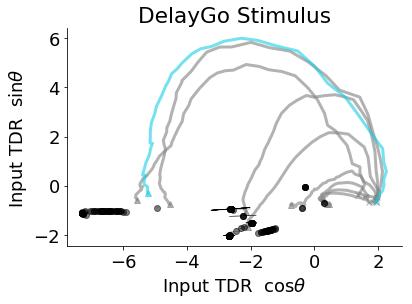

In [540]:
fp_epoch = 'stim1'
t_num = 120
m = model_dir_all
model = Model(m)
rule_ind = 0

with tf.Session() as sess:
    model.saver.restore(sess,ckpt_n_dir)
    hparams = model.hp
    rule = rules_dict['all'][rule_ind]
    trial = generate_trials(rule, hparams, mode='test', batch_size = np.max(trial_set),
                            noise_on=True, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
    T_inds = get_T_inds(trial,fp_epoch) # grab epoch time indexing

pca = PCA(n_components = 2,whiten = True)
X_pca = pca.fit_transform(np.squeeze(h_tf[T_inds,t_num,:]))
D = pca.components_.T

qlim = .0001
ax = plt.subplot(1,1,1)
plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D,fp_epoch,axes_epoch,
                          do_plot_FP=1,t_num = t_num,qlim = qlim)
 
plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
plt.ylabel('Input TDR ' + r' $\sin{\theta}$') 
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/

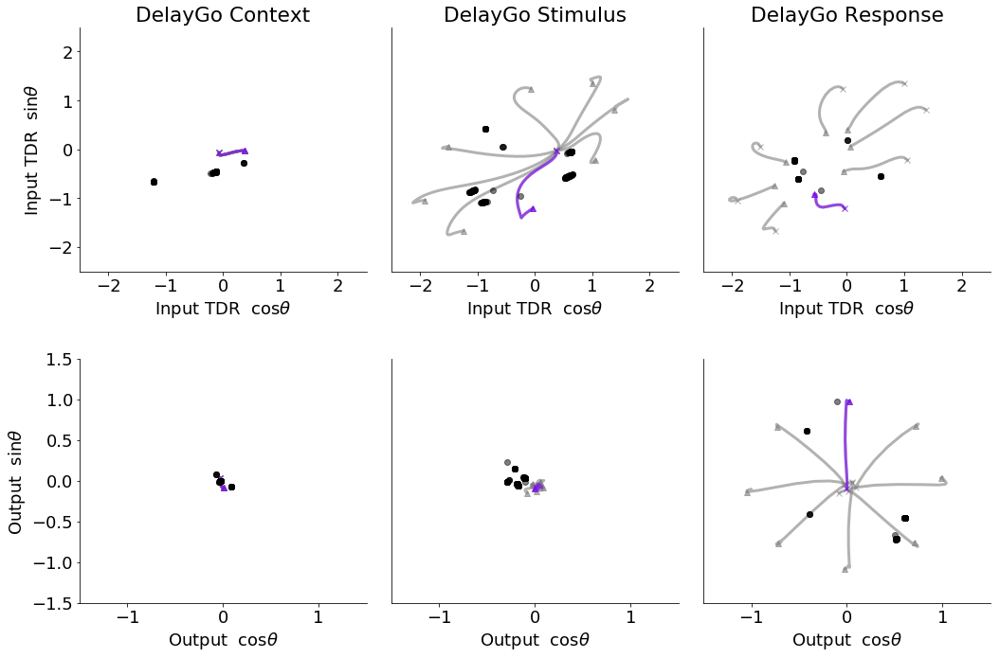

In [109]:
axes_epoch = 'stim1'
rule_ind = 0
do_plot = 1
nr = 2
t_num = 0
qlim = 1#.0000001

epoch_set = ['fix1','stim1','go1']
epoch_order = range(3)
rule = rules_dict['all'][rule_ind]
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_FP_one_trials_small_'+str(t_num)+'.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


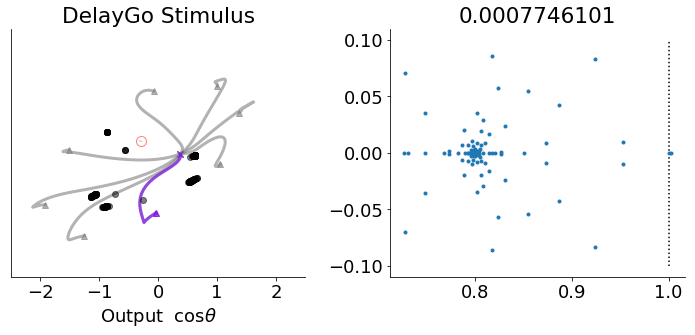

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


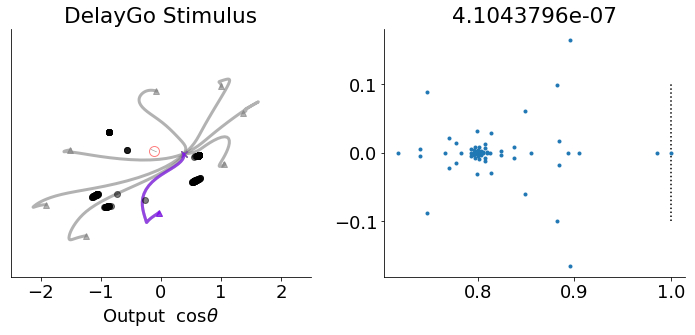

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


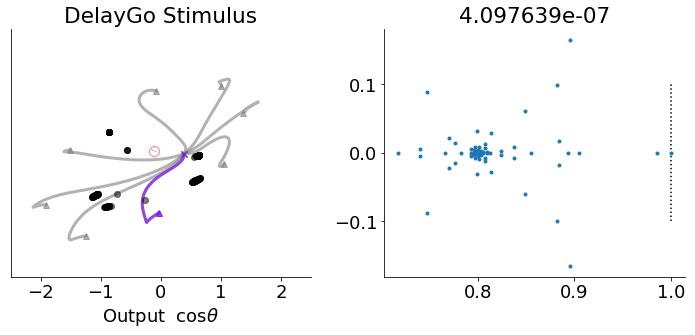

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


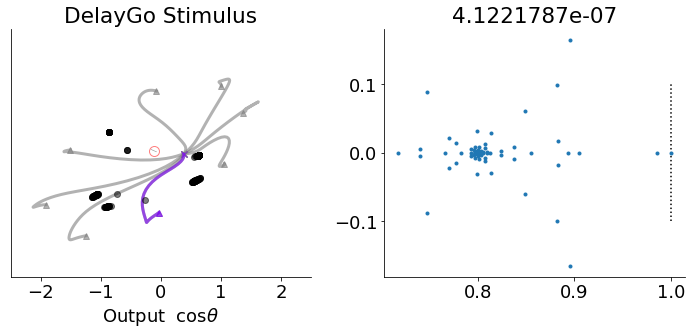

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/fdgo/stim1_0.npz


KeyboardInterrupt: 

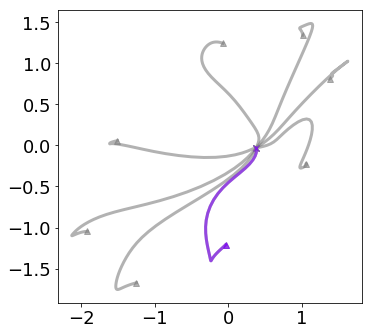

In [113]:
t_num = 0
rule_ind = 0
fp_epoch = 'stim1'
axes_epoch = 'stim1'
epoch_order = range(len(epoch_set))
rule = rules_dict['all'][rule_ind]
qlim = 1#.0000001
filename = os.path.join(model_dir_all,'golub_fixed_pts',rule,fp_epoch+'_'+str(t_num)+'.npz')
fp_struct = np.load(filename)

fp_logic = fp_struct['qstar']< 1
eig_decomps = comp_eig_decomp(fp_struct['J_xstar'][fp_logic,:,:])
sorted_fps = fp_struct['xstar'][fp_logic,:]

S = np.shape(fp_struct['qstar'])[0]
for s in range(S):
    fig = plt.figure(figsize=(10,5),tight_layout=True,facecolor='white')
    ax = plt.subplot(1,2,1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(100),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=1,t_num = t_num,qlim = qlim)
    plot_FP_specific(s,sorted_fps, D.T, eig_decomps, c = 'r')
    plt.ylim((-2.5,2.5))    
    plt.xlim((-2.5,2.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')

    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)  
    
    ax = plt.subplot(1,2,2)
    
    plt.plot([1,1],[-.1,.1],':k')
    plt.plot(eig_decomps[s]['evals'].real,eig_decomps[s]['evals'].imag,'.')
    
    plt.title(str(fp_struct['qstar'][s]))
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)  
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
400
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/

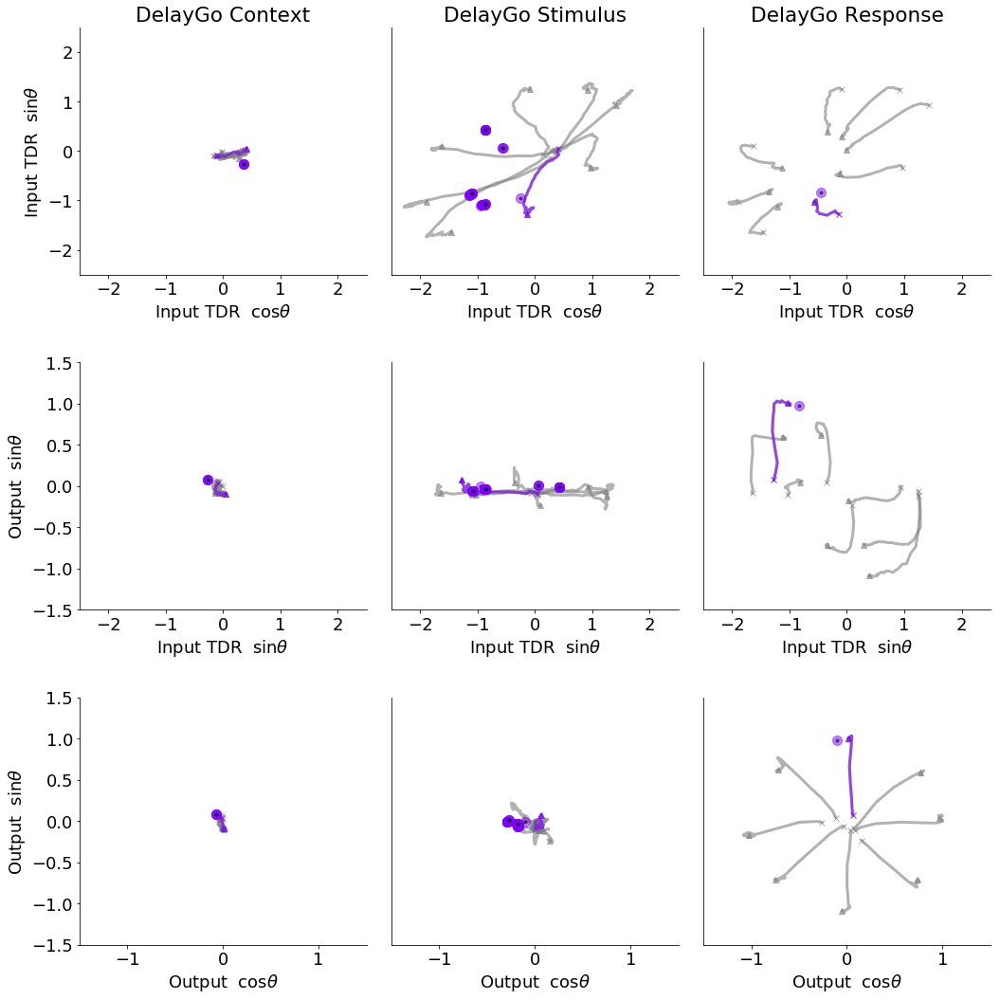

In [180]:
axes_epoch = 'stim1'
rule_ind = 0
do_plot = 1
nr = 3
t_num = 0
qlim = .0000001
input_lim = 2.5

epoch_set = ['fix1','stim1','go1']
epoch_order = range(3)
rule = rules_dict['all'][rule_ind]
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
         
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    D_innout = np.concatenate((D_stim[:,1:],w_out[:,2:]),axis = 1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_innout,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.xlim((-input_lim,input_lim))
    plt.ylim((-1.5,1.5))  
    plt.xlabel('Input TDR ' + r' $\sin{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+2*len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$')
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_FP_one_trials.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
either
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
80
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/ke

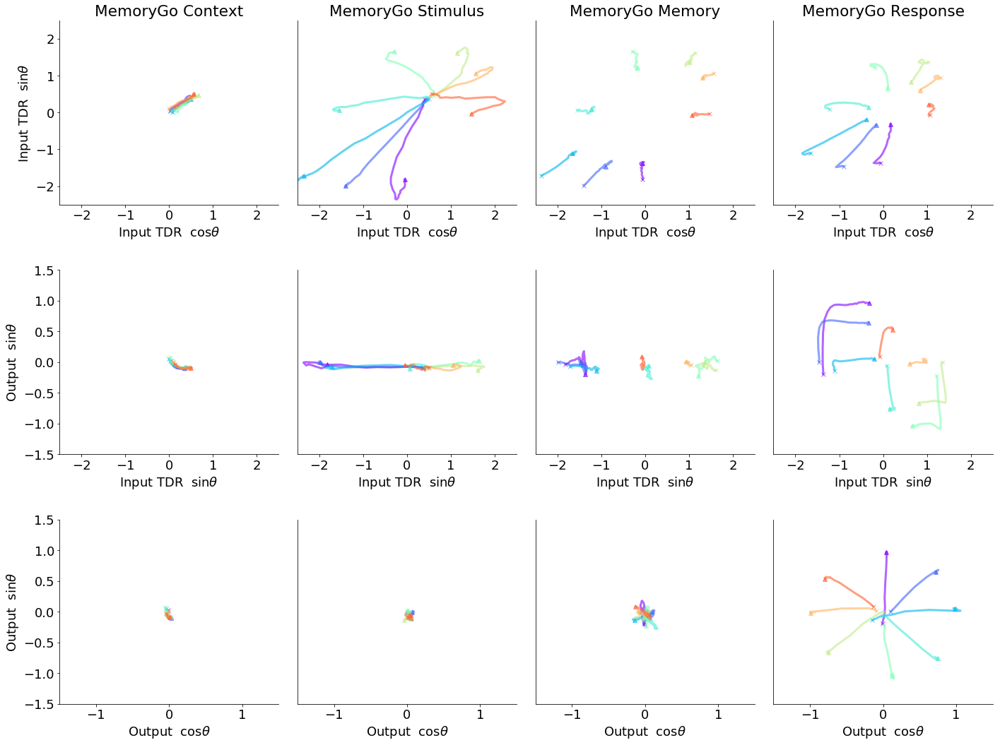

In [169]:
axes_epoch = 'stim1'
rule_ind = 2
do_plot = 1
nr = 3
t_num = 0
qlim = .0000001
do_plot = 0
input_lim = 2.5
rule = rules_dict['all'][rule_ind]

epoch_set = ['fix1','stim1','delay1','go1']
epoch_order = range(len(epoch_set))
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    D_innout = np.concatenate((D_stim[:,1:],w_out[:,2:]),axis = 1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_innout,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.xlim((-input_lim,input_lim))
    plt.ylim((-1.5,1.5))  
    plt.xlabel('Input TDR ' + r' $\sin{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
         
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+2*len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_Act_trials.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/ckpts/model.ckpt-414000
either
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/ckpts/model.ckpt-414000
80
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/ke

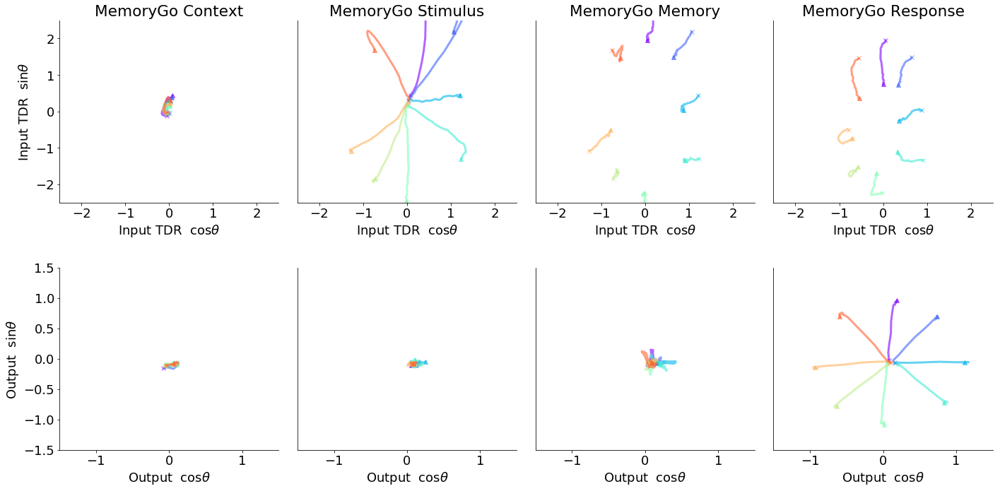

In [535]:
axes_epoch = 'stim1'
rule_ind = 2
do_plot = 1
nr = 2
t_num = 0
qlim = .0000001
do_plot = 0
input_lim = 2.5
rule = rules_dict['all'][rule_ind]

epoch_set = ['fix1','stim1','delay1','go1']
epoch_order = range(len(epoch_set))
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_Act_trials_small.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
either
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
80
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/sof

INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-270000
80
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/golub_fixed_pts/delaygo/go1_0.npz


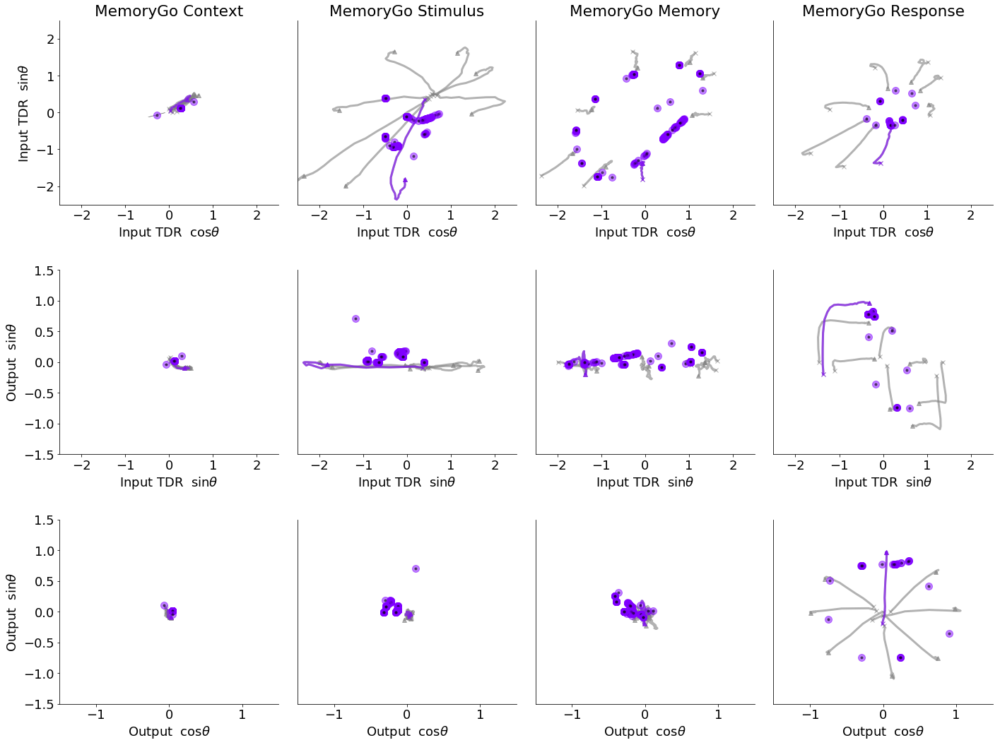

In [179]:
axes_epoch = 'stim1'
rule_ind = 2
do_plot = 1
nr = 3
t_num = 0
qlim = .000001
input_lim = 2.5
do_plot = 1
rule = rules_dict['all'][rule_ind]

epoch_set = ['fix1','stim1','delay1','go1']
epoch_order = range(len(epoch_set))
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    D_innout = np.concatenate((D_stim[:,1:],w_out[:,2:]),axis = 1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_innout,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.xlim((-input_lim,input_lim))
    plt.ylim((-1.5,1.5))  
    plt.xlabel('Input TDR ' + r' $\sin{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+2*len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot,t_num = t_num,qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_FP_one_trials.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/ckpts/model.ckpt-414000
either
either
either
either
either
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/1/ckpts/model.ckpt-414000
80
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/sof

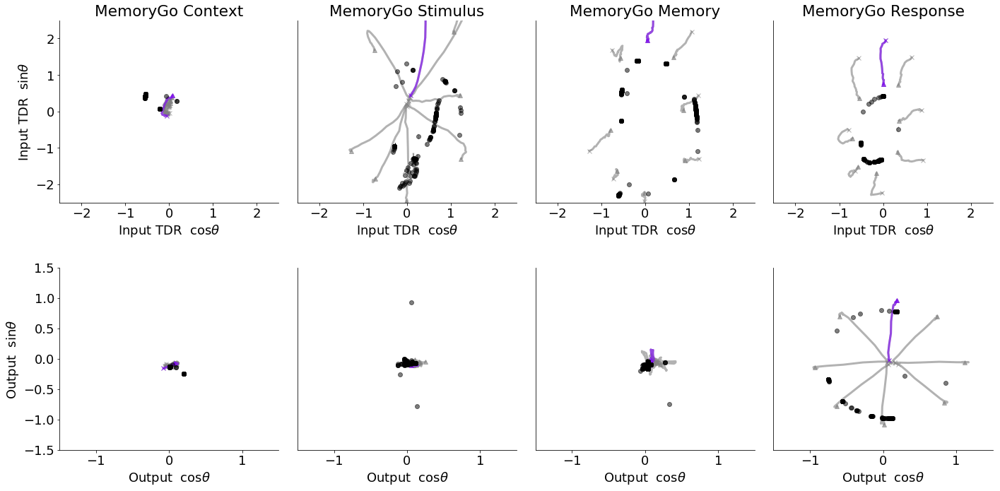

In [538]:
axes_epoch = 'stim1'
rule_ind = 2
do_plot = 1
nr = 2
t_num = 0
qlim = .001
input_lim = 2.5
do_plot = 1
rule = rules_dict['all'][rule_ind]

epoch_set = ['fix1','stim1','delay1','go1']
epoch_order = range(len(epoch_set))
fig = plt.figure(figsize=(len(epoch_set)*5,nr*5),tight_layout=True,facecolor='white')

for fp_epoch_ind in range(len(epoch_set)):
    fp_epoch = epoch_set[epoch_order[fp_epoch_ind]]
    D_stim = make_axes(model_dir_all,ckpt_n_dir,rule,axes_epoch)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1)
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,D_stim,fp_epoch,axes_epoch,
                              do_plot_FP=do_plot, t_num = t_num, qlim = qlim)
    plt.ylim((-input_lim,input_lim))    
    plt.xlim((-input_lim,input_lim))  
    plt.xlabel('Input TDR ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Input TDR ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax = plt.subplot(nr,len(epoch_set),fp_epoch_ind+1+len(epoch_set))
    plot_fp_struct_multicolor(model_dir_all,ckpt_n_dir,[rule_ind],range(200),rule,w_out[:,1:],fp_epoch,axes_epoch,
                              do_plot_FP=do_plot, t_num = t_num, qlim = qlim)
    plt.title(' ')
    plt.ylim((-1.5,1.5))    
    plt.xlim((-1.5,1.5))  
    plt.xlabel('Output ' + r' $\cos{\theta}$')
    
    if fp_epoch_ind==0:
        plt.ylabel('Output ' + r' $\sin{\theta}$') 
    else:
        ax.get_yaxis().set_visible(False)
    
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

figpath = os.path.join(model_dir_all,'Output Prep Figure',rule)
figname = rule+'_Output_axes_FP_one_trials_small.pdf'
if not os.path.exists(figpath):
    os.makedirs(figpath)
plt.savefig(os.path.join(figpath,figname))
plt.show()